In [2]:
# Importing libraries
import os
import cv2
import numpy as np
import keras
import matplotlib.pyplot as plt
import tensorflow as tf
import keras.backend as K
from patchify import patchify, unpatchify
from keras.models import Model
from keras.layers import Input, Conv2D, MaxPooling2D, concatenate, Conv2DTranspose, Dropout
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam

c:\ProgramData\anaconda3\envs\tf\lib\site-packages\scipy\__init__.py:155: UserWarning: A NumPy version >=1.18.5 and <1.25.0 is required for this version of SciPy (detected version 1.26.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


Cropping

In [3]:
# Setting the directories
image_dir_all = r'C:\Users\daraz\Desktop\BUas\Year 2 Block B\Plant pictures'
mask_dir_all = r'C:\Users\daraz\Desktop\BUas\Year 2 Block B\root_masks'

# Defining the lists
filenames_msk = []
images_with_masks = []
images_with_masks_names = []
masks = []

# Getting the names of the masks
for filename_msk in os.listdir(mask_dir_all):
    # Making sure that the files are .tif
    if filename_msk.endswith(".tif"):
        # Reading the masks
        mask = cv2.imread(os.path.join(mask_dir_all, filename_msk))
        # Appending the names of the masks to a list
        filenames_msk.append(filename_msk.rsplit(sep='-Fish Eye Corrected')[0])
        # Appending the masks to a list
        masks.append(mask)

# Getting the images
for filename in os.listdir(image_dir_all):
    # Making sure that the files are .png and that the image has a mask
    if filename.endswith(".png") and filename.rsplit(sep='-Fish Eye Corrected')[0] in filenames_msk:
        # Reading the images
        image = cv2.imread(os.path.join(image_dir_all, filename))
        # Appending the images to a list
        images_with_masks.append(image)
        # Appending the names of the images to a list
        images_with_masks_names.append(filename.rsplit(sep='-Fish Eye Corrected')[0])

            
# Converting the lists to numpy arrays
images_with_masks_uint8 = [np.array(img).astype(np.uint8) for img in images_with_masks]

# Converting the lists to numpy arrays
filenames_msk = np.array(filenames_msk)
images_with_masks = np.array(images_with_masks)

In [4]:
# Sanity check
print('Number of images with masks: ', len(images_with_masks))
print('Number of masks: ', len(masks))

Number of images with masks:  115
Number of masks:  115


(2805, 2805, 3)
(2805, 2805, 3)


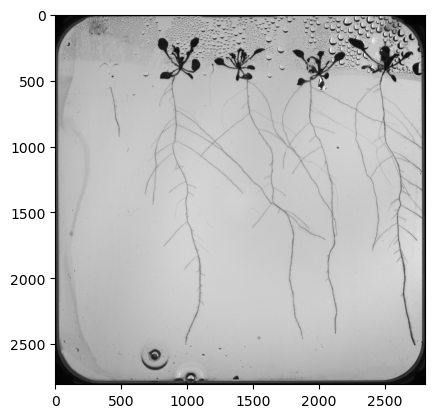

(2806, 2806, 3)
(2806, 2806, 3)


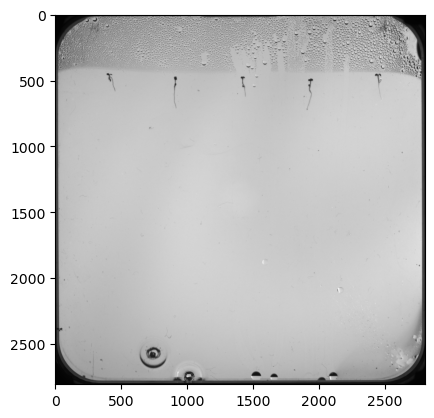

(2805, 2805, 3)
(2805, 2805, 3)


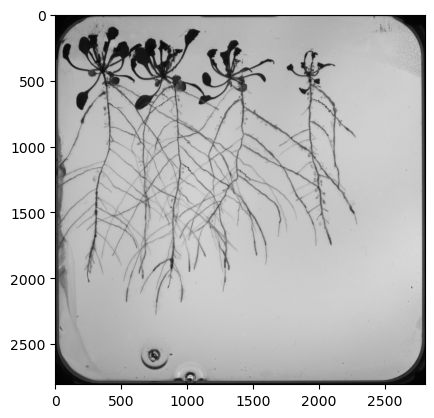

(2806, 2806, 3)
(2806, 2806, 3)


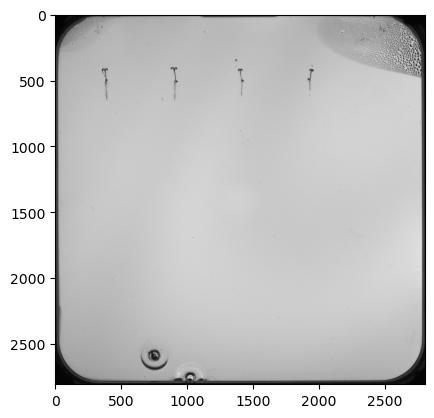

(2806, 2806, 3)
(2806, 2806, 3)


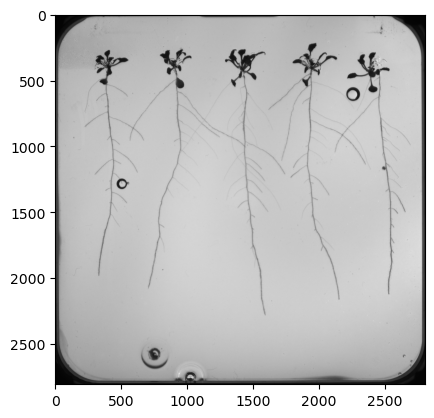

(2806, 2806, 3)
(2806, 2806, 3)


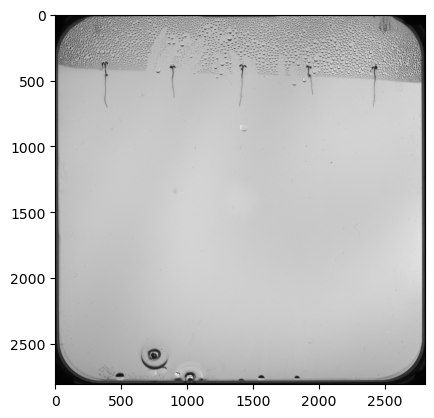

(2806, 2806, 3)
(2806, 2806, 3)


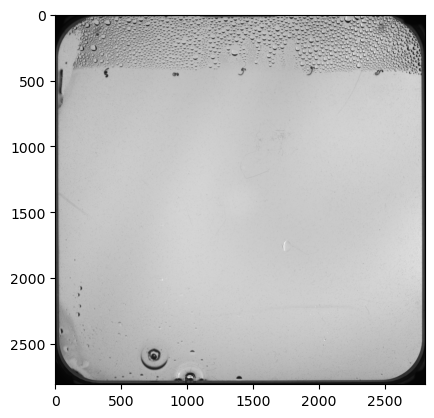

(2805, 2805, 3)
(2805, 2805, 3)


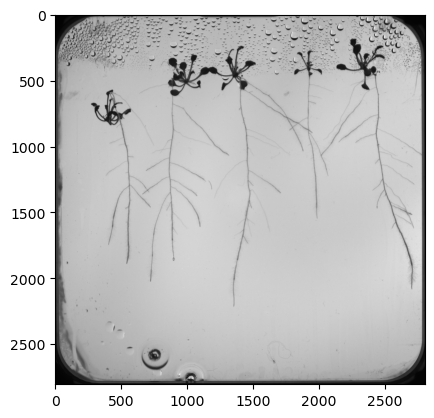

(2805, 2805, 3)
(2805, 2805, 3)


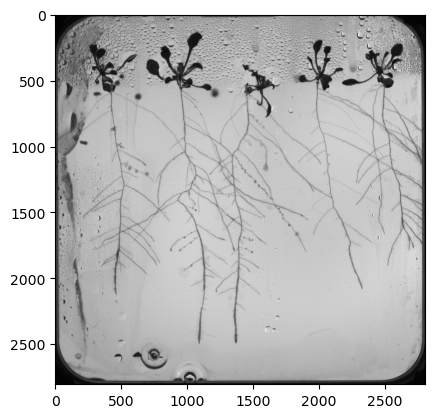

(2806, 2806, 3)
(2806, 2806, 3)


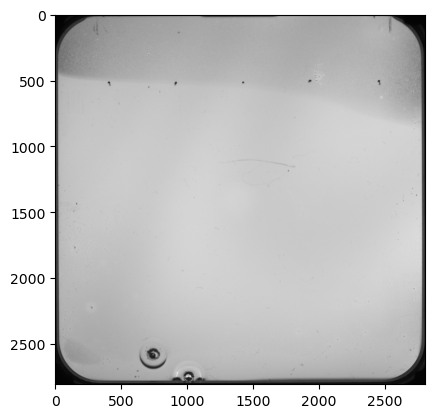

(2806, 2806, 3)
(2806, 2806, 3)


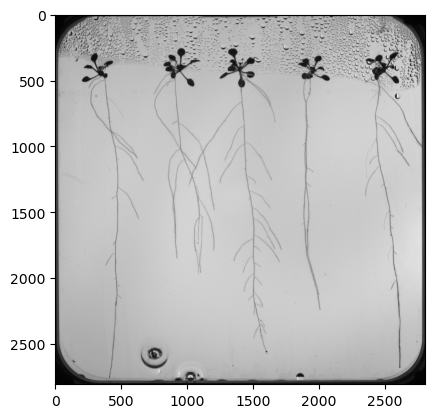

(2806, 2806, 3)
(2806, 2806, 3)


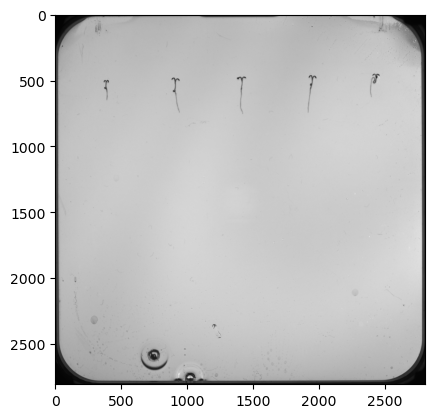

(2804, 2804, 3)
(2804, 2804, 3)


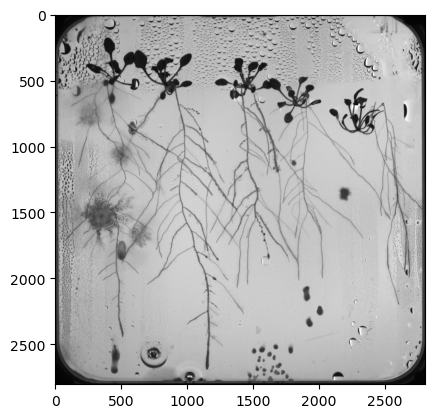

(2806, 2806, 3)
(2806, 2806, 3)


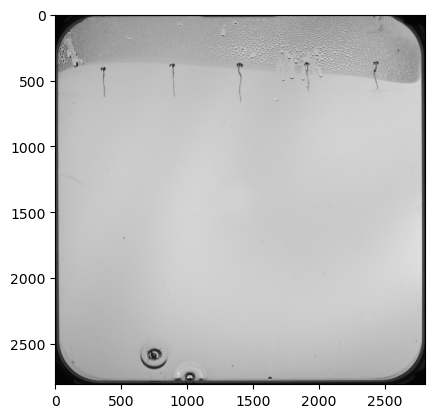

(2805, 2805, 3)
(2805, 2805, 3)


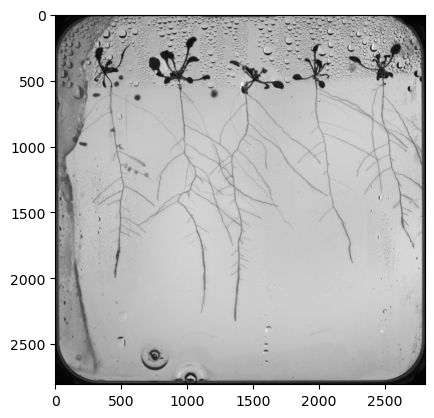

(2805, 2805, 3)
(2805, 2805, 3)


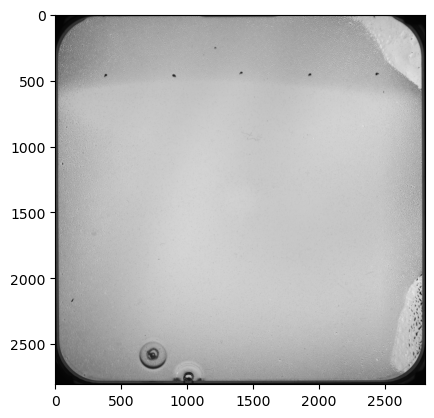

(2805, 2805, 3)
(2805, 2805, 3)


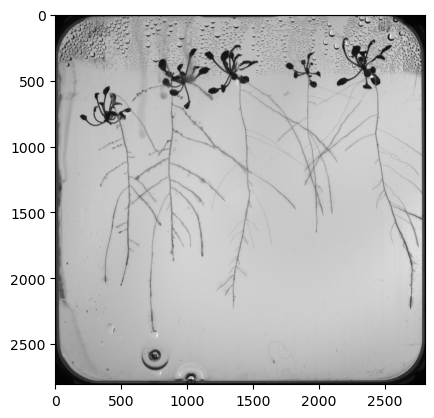

(2805, 2805, 3)
(2805, 2805, 3)


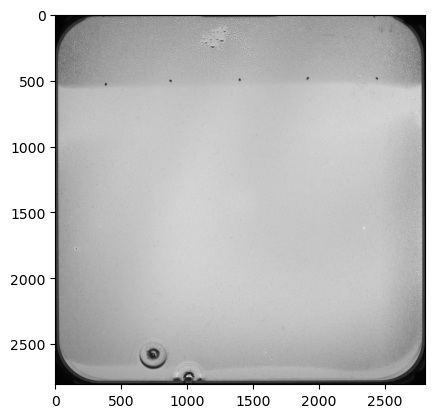

(2806, 2806, 3)
(2806, 2806, 3)


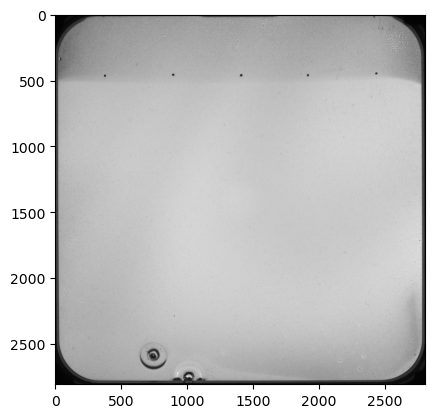

(2806, 2806, 3)
(2806, 2806, 3)


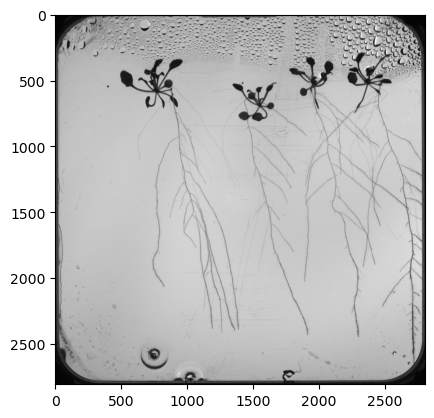

(2806, 2806, 3)
(2806, 2806, 3)


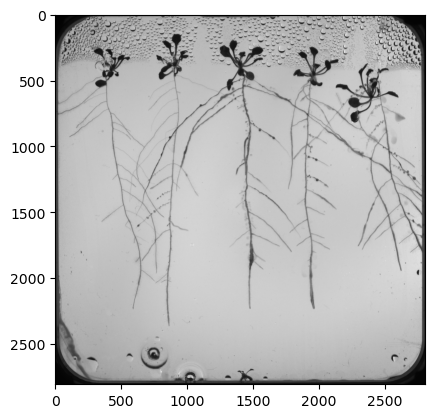

(2805, 2805, 3)
(2805, 2805, 3)


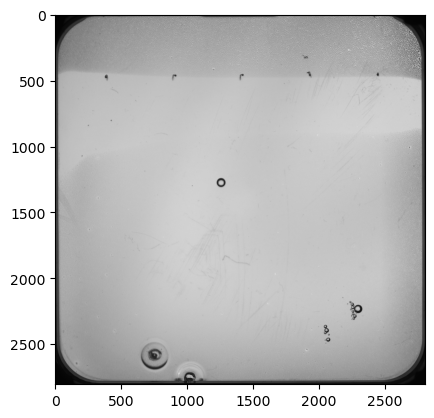

(2805, 2805, 3)
(2805, 2805, 3)


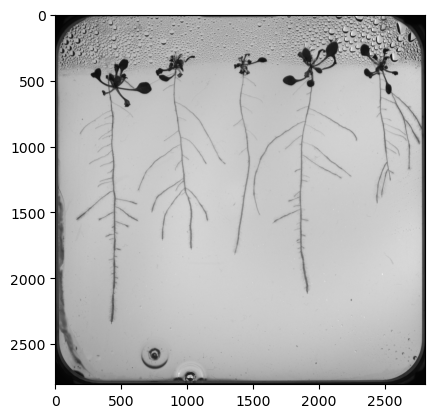

(2806, 2806, 3)
(2806, 2806, 3)


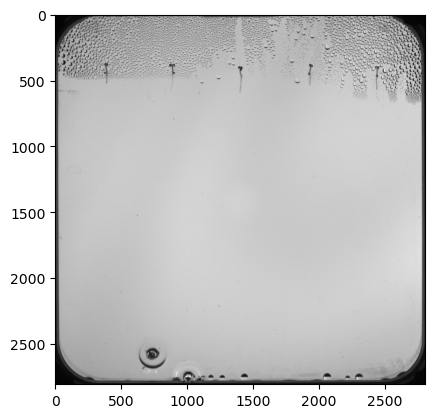

(2805, 2805, 3)
(2805, 2805, 3)


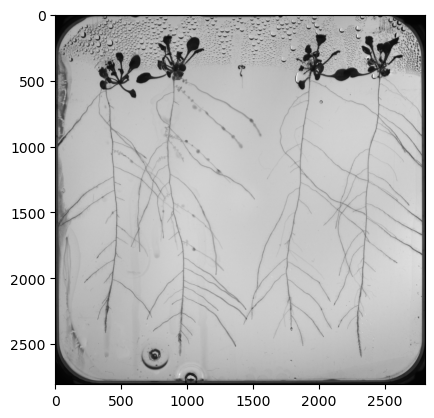

(2805, 2805, 3)
(2805, 2805, 3)


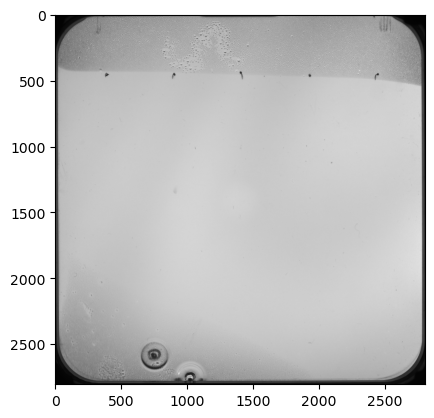

(2806, 2806, 3)
(2806, 2806, 3)


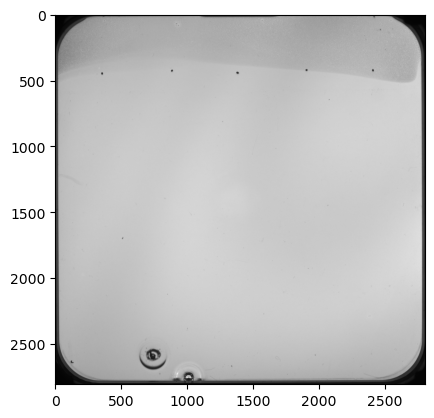

(2805, 2805, 3)
(2805, 2805, 3)


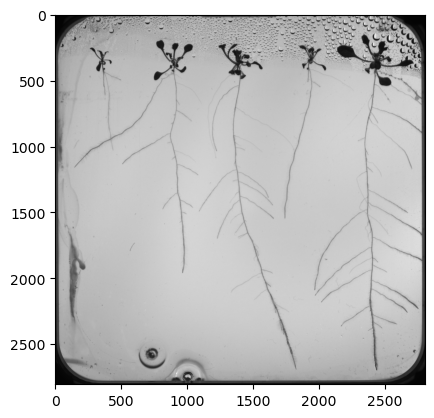

(2806, 2806, 3)
(2806, 2806, 3)


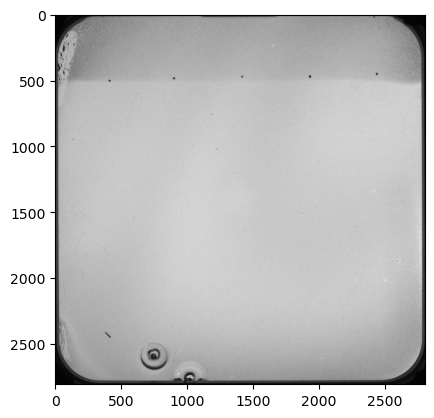

(2805, 2805, 3)
(2805, 2805, 3)


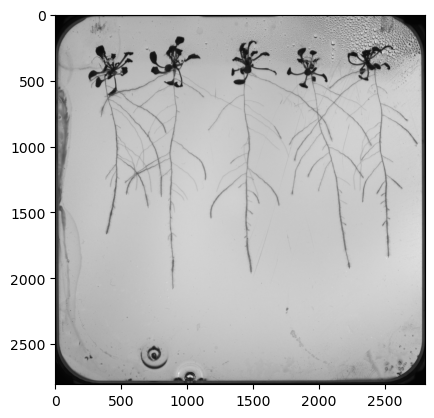

(2805, 2805, 3)
(2805, 2805, 3)


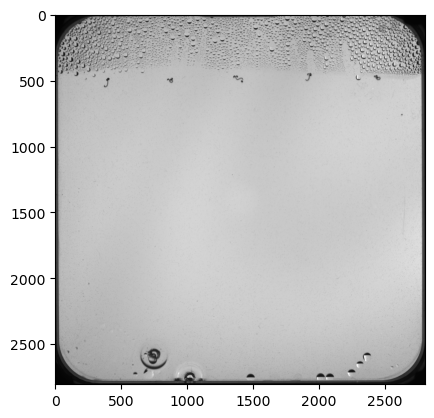

(2805, 2805, 3)
(2805, 2805, 3)


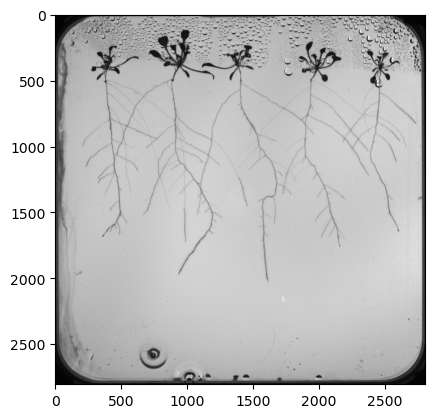

(2805, 2805, 3)
(2805, 2805, 3)


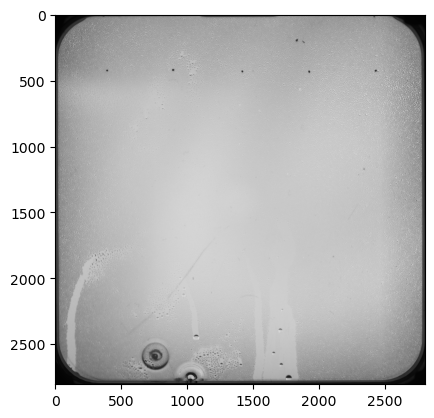

(2804, 2804, 3)
(2804, 2804, 3)


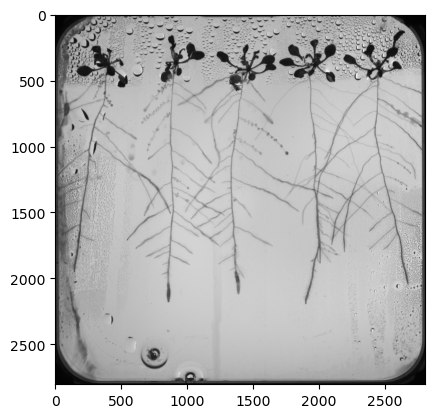

(2806, 2806, 3)
(2806, 2806, 3)


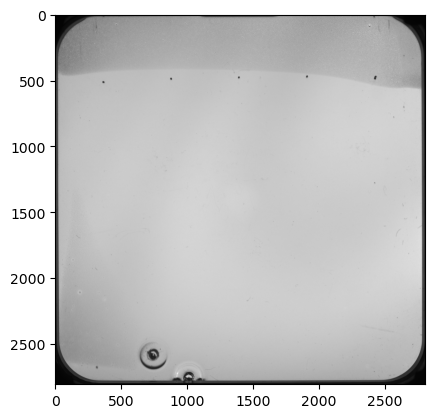

(2805, 2805, 3)
(2805, 2805, 3)


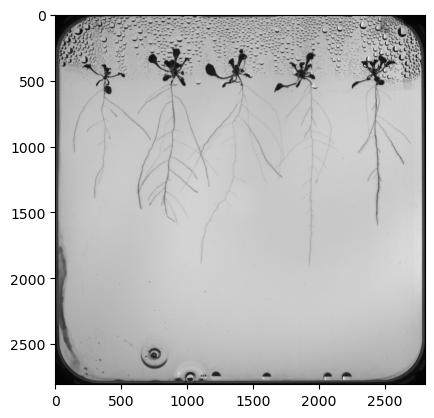

(2806, 2806, 3)
(2806, 2806, 3)


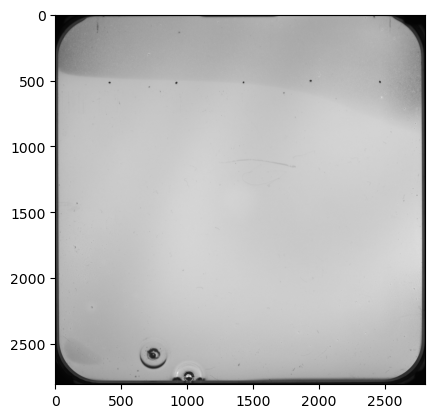

(2805, 2805, 3)
(2805, 2805, 3)


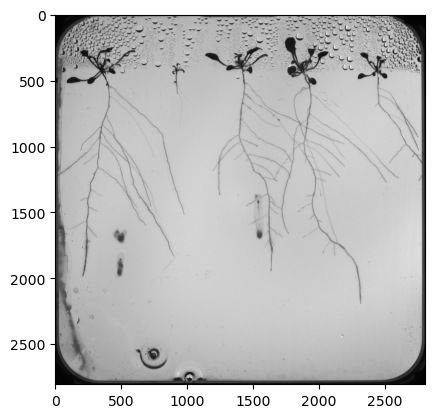

(2805, 2805, 3)
(2805, 2805, 3)


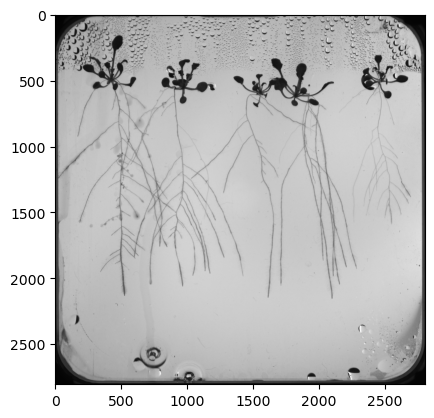

(2806, 2806, 3)
(2806, 2806, 3)


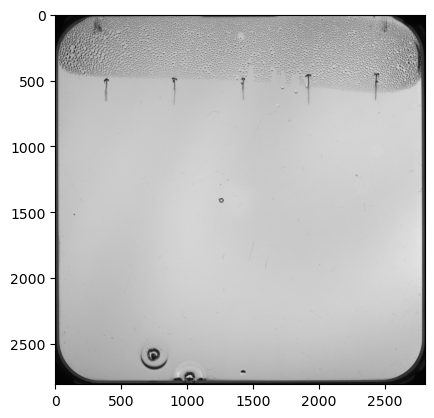

(2804, 2804, 3)
(2804, 2804, 3)


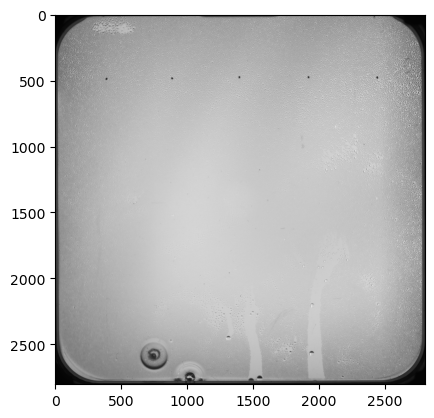

(2805, 2805, 3)
(2805, 2805, 3)


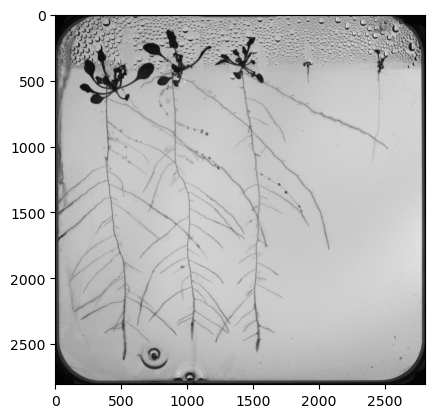

(2806, 2806, 3)
(2806, 2806, 3)


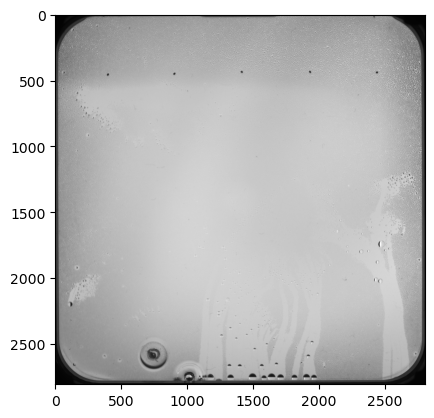

(2806, 2806, 3)
(2806, 2806, 3)


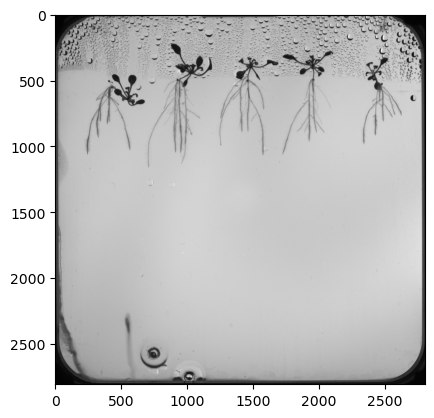

(2805, 2805, 3)
(2805, 2805, 3)


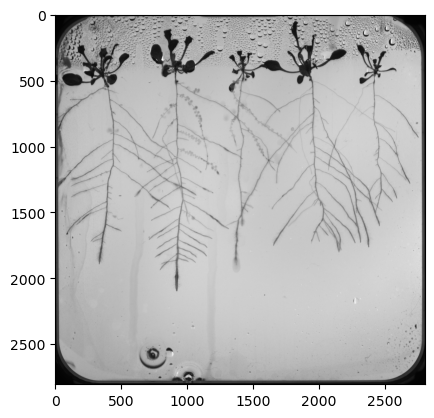

(2806, 2806, 3)
(2806, 2806, 3)


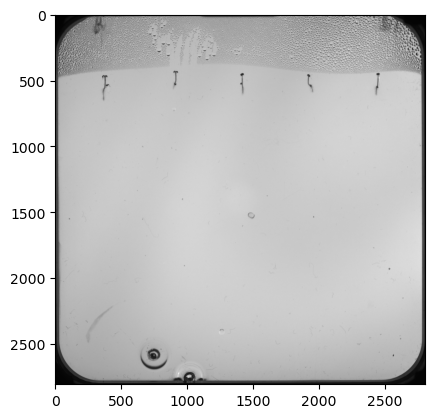

(2805, 2805, 3)
(2805, 2805, 3)


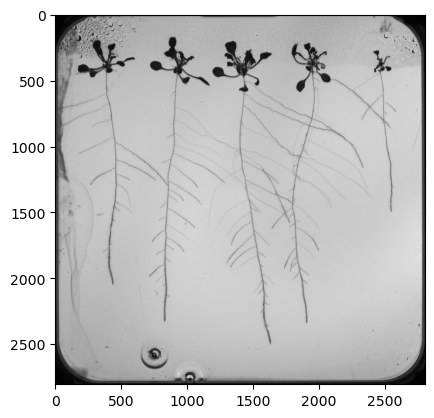

(2806, 2806, 3)
(2806, 2806, 3)


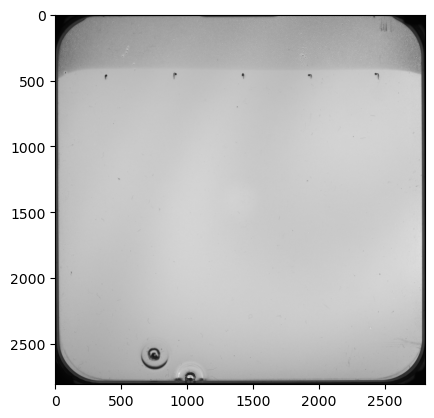

(2806, 2806, 3)
(2806, 2806, 3)


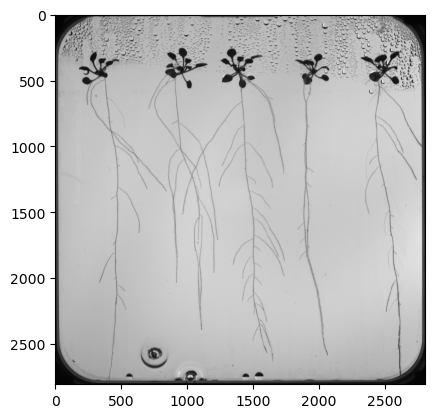

(2806, 2806, 3)
(2806, 2806, 3)


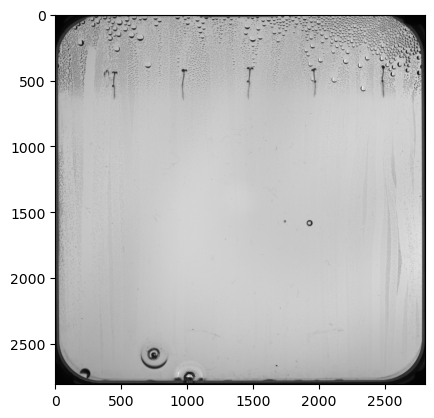

(2805, 2805, 3)
(2805, 2805, 3)


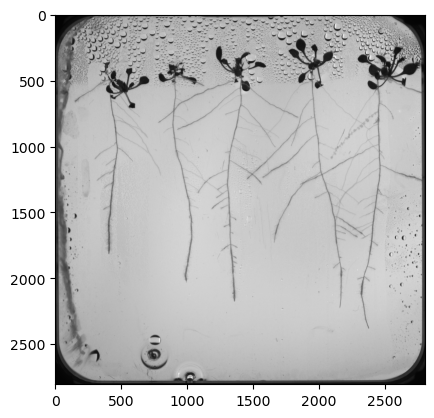

(2804, 2804, 3)
(2804, 2804, 3)


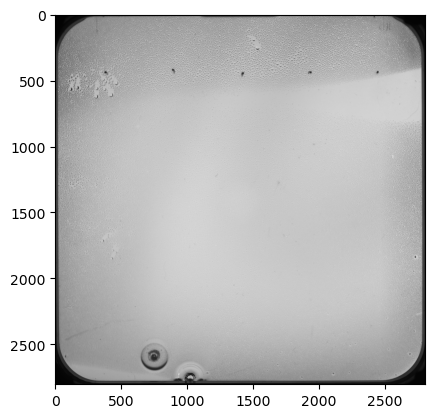

(2805, 2805, 3)
(2805, 2805, 3)


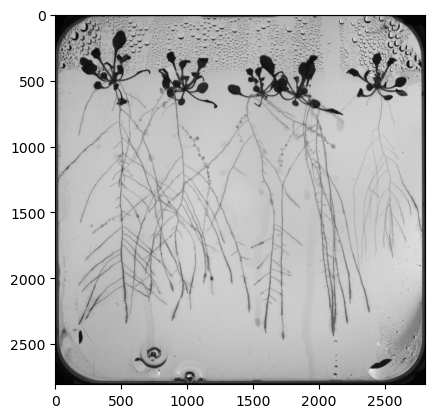

(2804, 2804, 3)
(2804, 2804, 3)


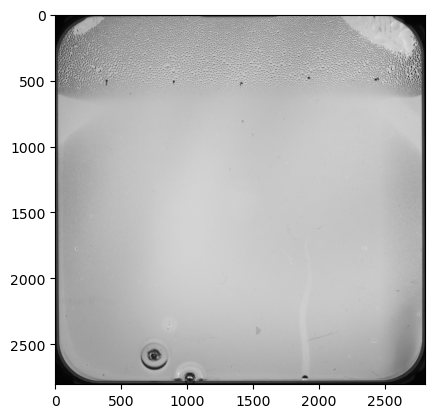

(2805, 2805, 3)
(2805, 2805, 3)


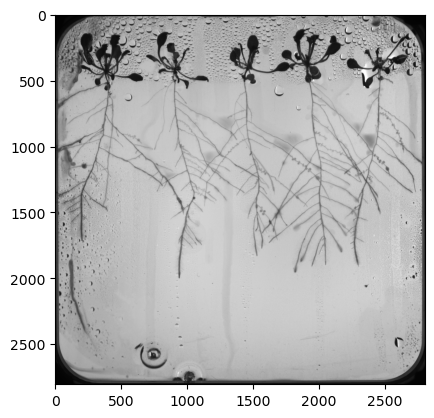

(2806, 2806, 3)
(2806, 2806, 3)


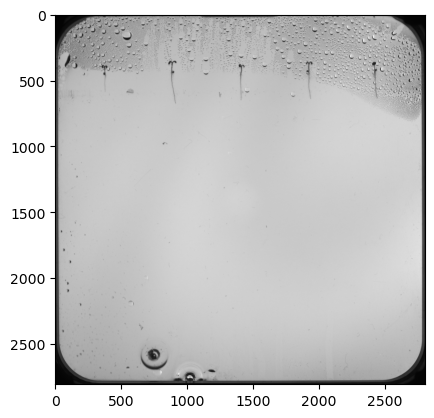

(2805, 2805, 3)
(2805, 2805, 3)


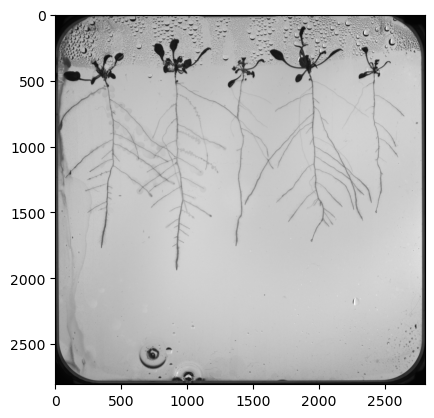

(2806, 2806, 3)
(2806, 2806, 3)


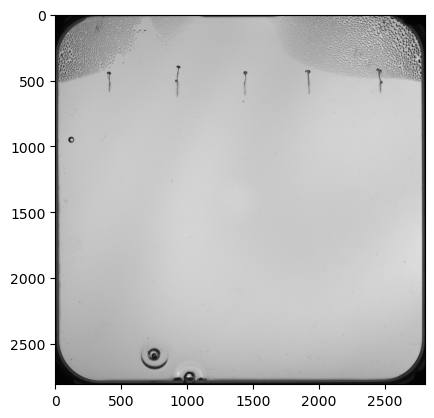

(2806, 2806, 3)
(2806, 2806, 3)


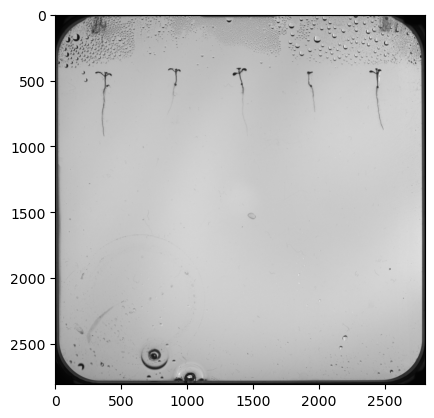

(2806, 2806, 3)
(2806, 2806, 3)


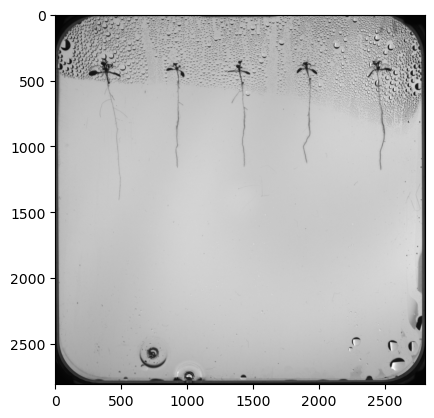

(2805, 2805, 3)
(2805, 2805, 3)


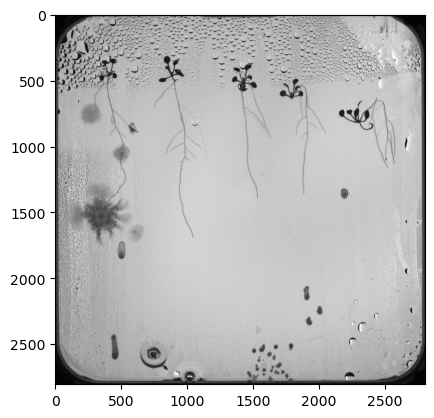

(2806, 2806, 3)
(2806, 2806, 3)


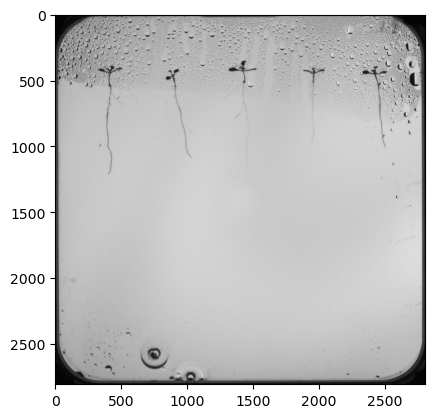

(2805, 2805, 3)
(2805, 2805, 3)


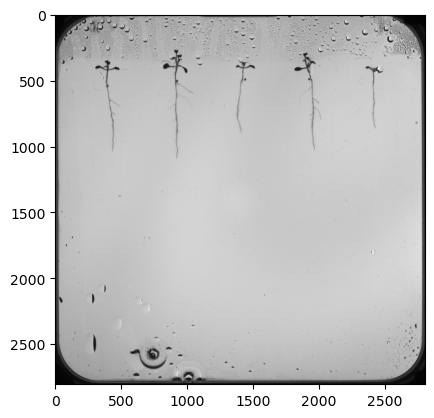

(2806, 2806, 3)
(2806, 2806, 3)


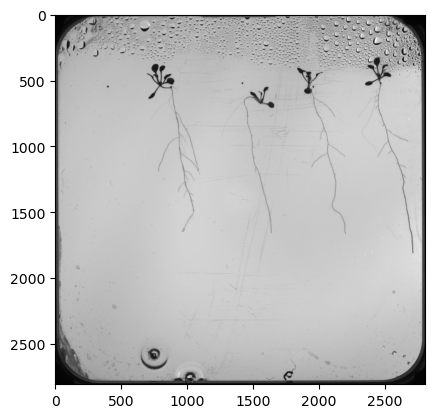

(2806, 2806, 3)
(2806, 2806, 3)


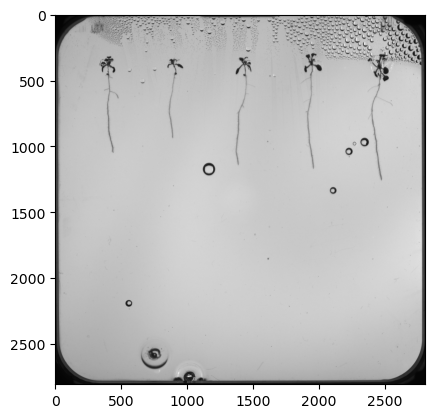

(2806, 2806, 3)
(2806, 2806, 3)


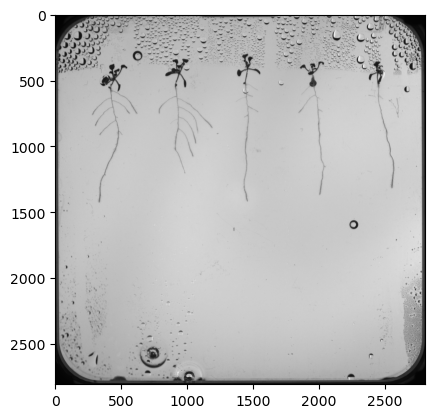

(2805, 2805, 3)
(2805, 2805, 3)


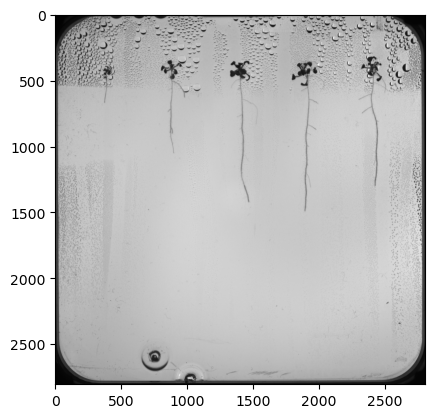

(2805, 2805, 3)
(2805, 2805, 3)


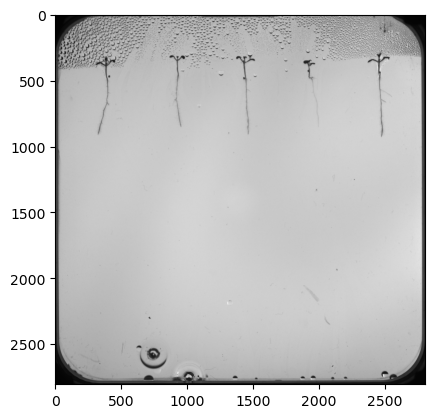

(2806, 2806, 3)
(2806, 2806, 3)


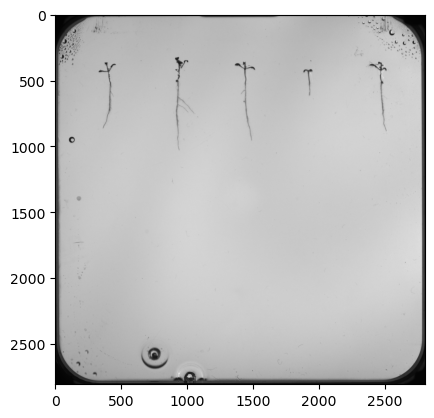

(2805, 2805, 3)
(2805, 2805, 3)


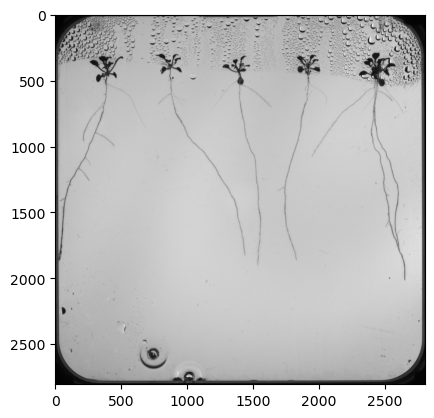

(2805, 2805, 3)
(2805, 2805, 3)


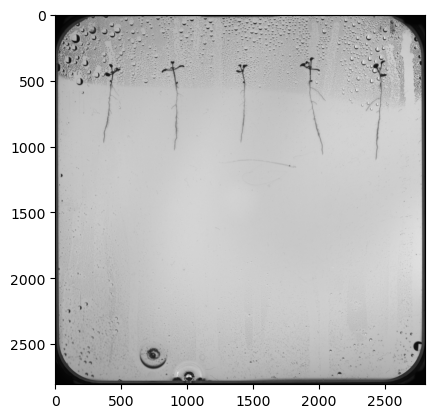

(2805, 2805, 3)
(2805, 2805, 3)


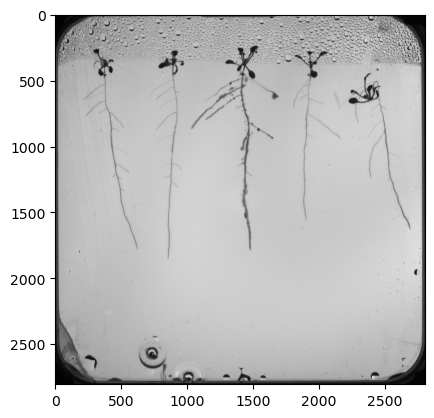

(2805, 2805, 3)
(2805, 2805, 3)


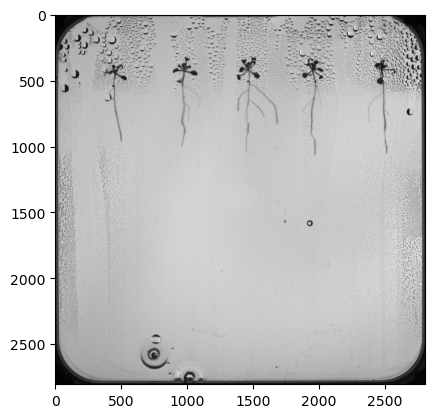

(2805, 2805, 3)
(2805, 2805, 3)


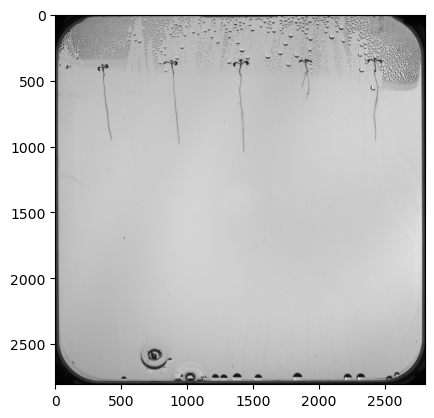

(2805, 2805, 3)
(2805, 2805, 3)


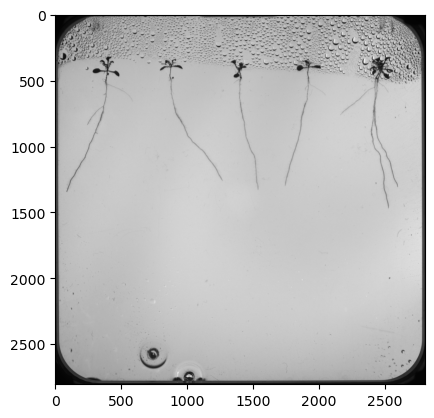

(2805, 2805, 3)
(2805, 2805, 3)


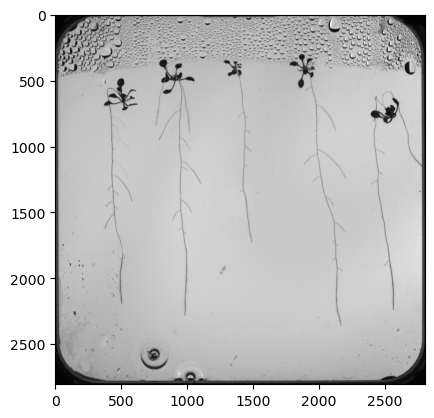

(2806, 2806, 3)
(2806, 2806, 3)


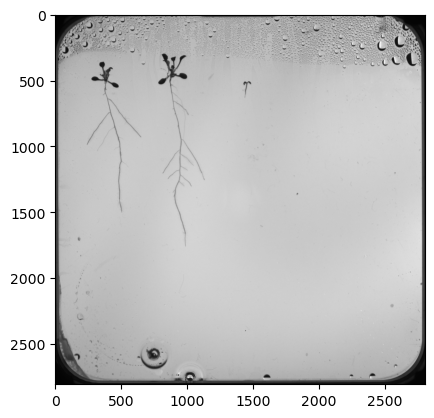

(2806, 2806, 3)
(2806, 2806, 3)


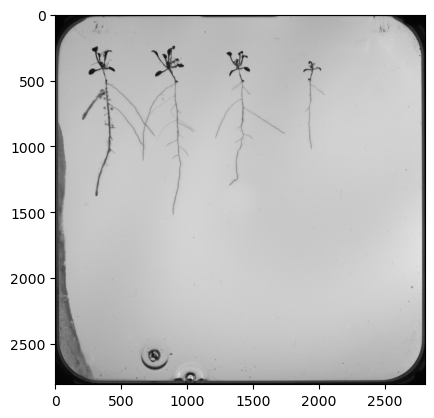

(2806, 2806, 3)
(2806, 2806, 3)


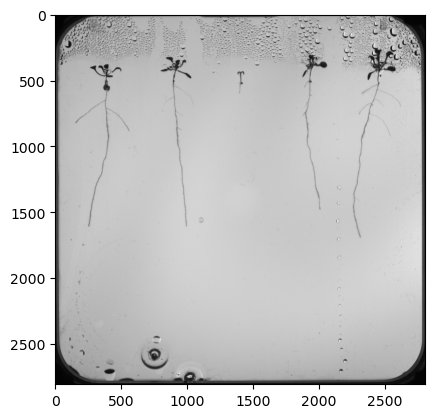

(2806, 2806, 3)
(2806, 2806, 3)


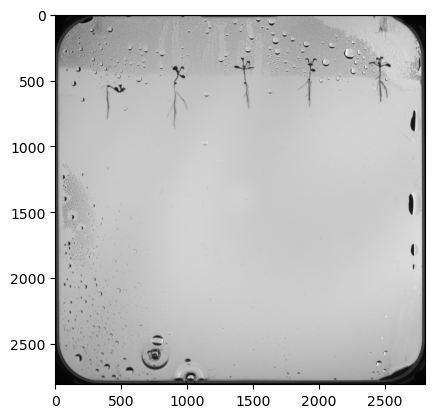

(2806, 2806, 3)
(2806, 2806, 3)


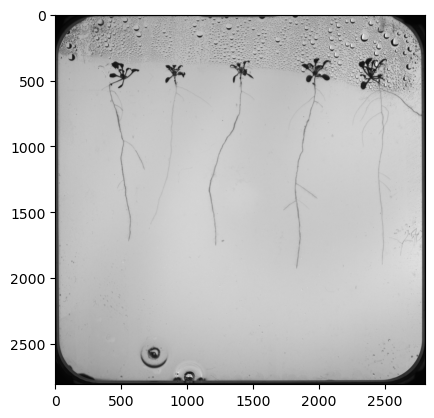

(2805, 2805, 3)
(2805, 2805, 3)


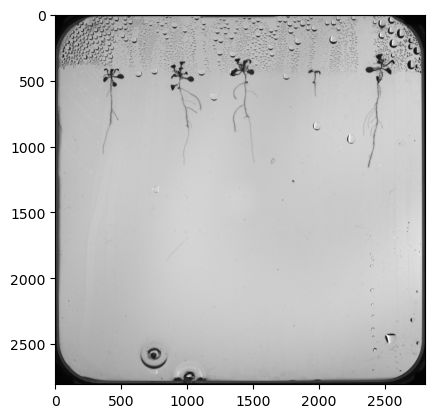

(2806, 2806, 3)
(2806, 2806, 3)


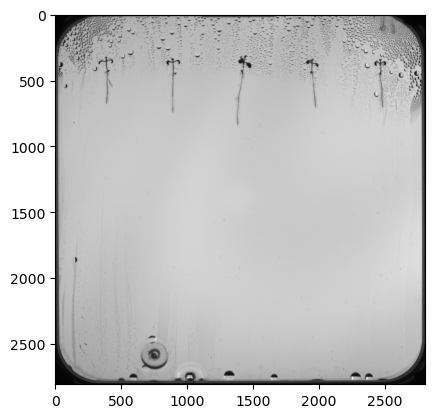

(2806, 2806, 3)
(2806, 2806, 3)


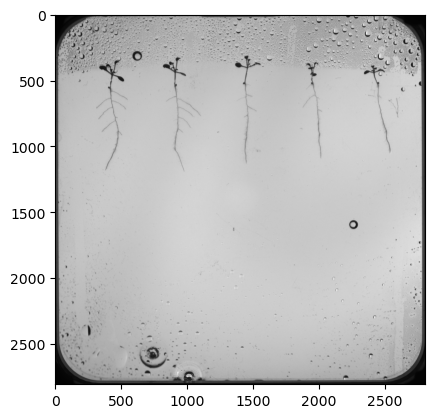

(2806, 2806, 3)
(2806, 2806, 3)


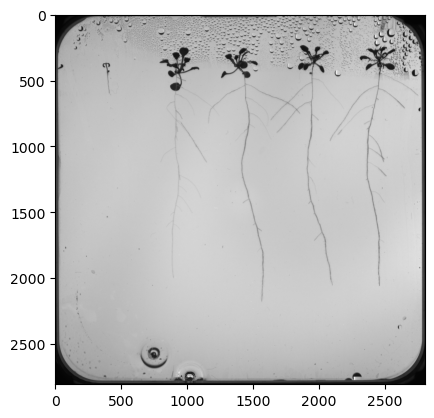

(2806, 2806, 3)
(2806, 2806, 3)


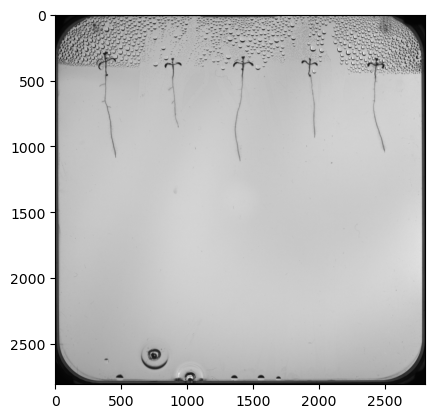

(2805, 2805, 3)
(2805, 2805, 3)


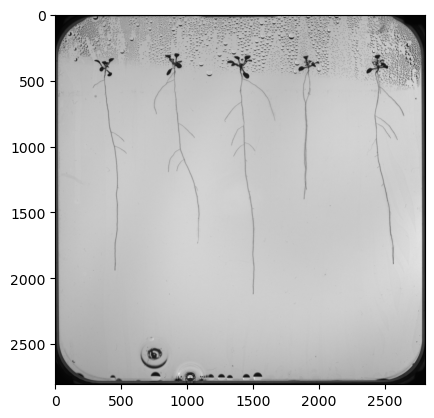

(2805, 2805, 3)
(2805, 2805, 3)


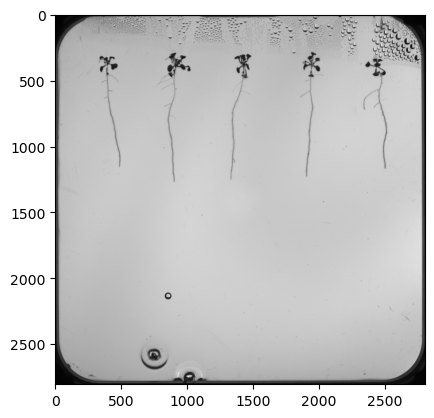

(2806, 2806, 3)
(2806, 2806, 3)


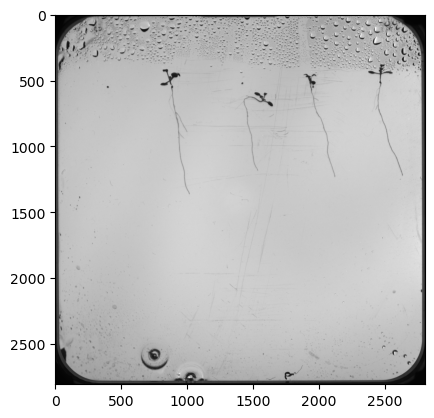

(2805, 2805, 3)
(2805, 2805, 3)


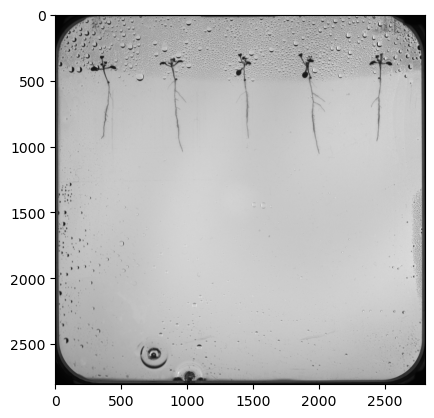

(2806, 2806, 3)
(2806, 2806, 3)


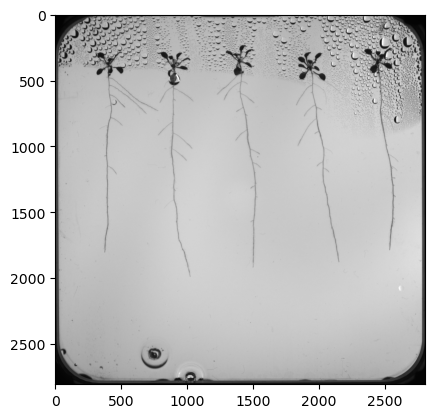

(2805, 2805, 3)
(2805, 2805, 3)


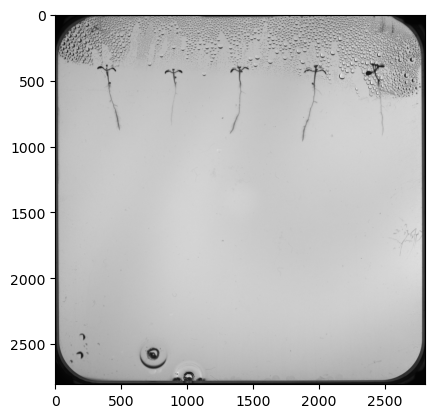

(2806, 2806, 3)
(2806, 2806, 3)


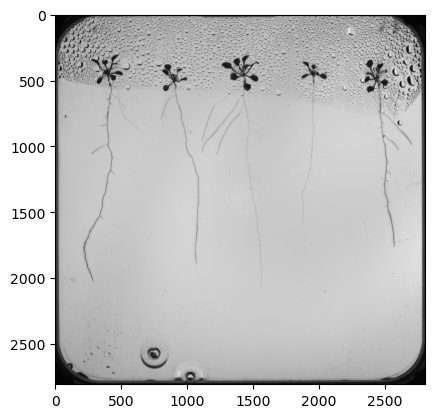

(2806, 2806, 3)
(2806, 2806, 3)


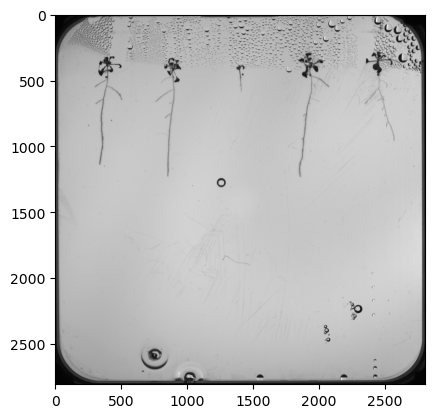

(2806, 2806, 3)
(2806, 2806, 3)


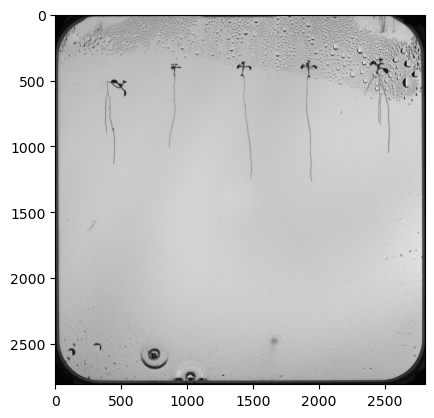

(2806, 2806, 3)
(2806, 2806, 3)


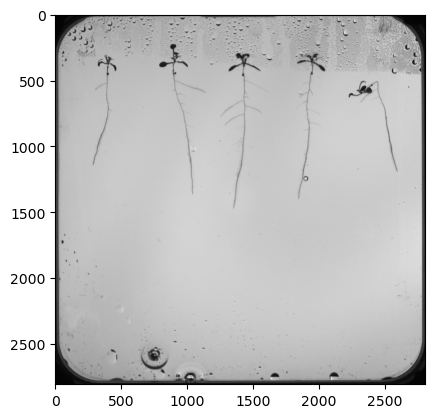

(2806, 2806, 3)
(2806, 2806, 3)


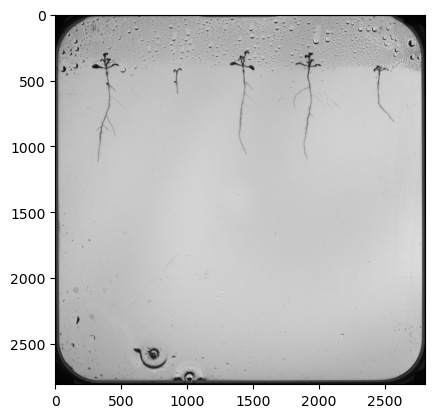

(2805, 2805, 3)
(2805, 2805, 3)


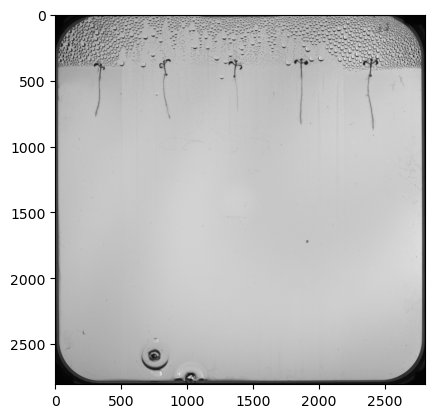

(2806, 2806, 3)
(2806, 2806, 3)


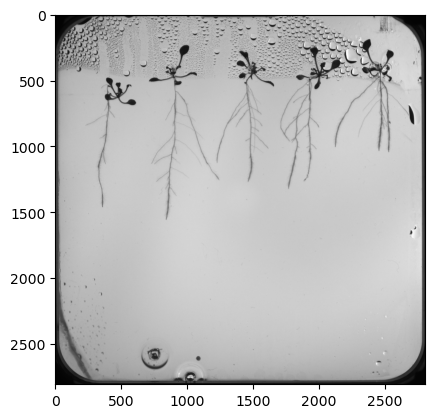

(2806, 2806, 3)
(2806, 2806, 3)


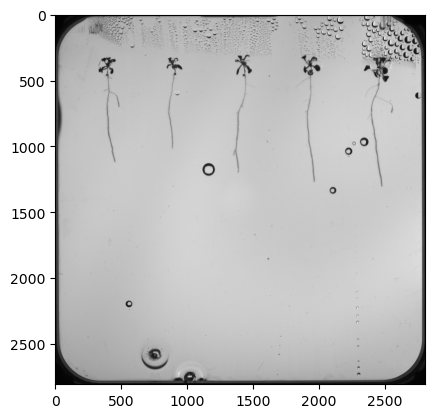

(2806, 2806, 3)
(2806, 2806, 3)


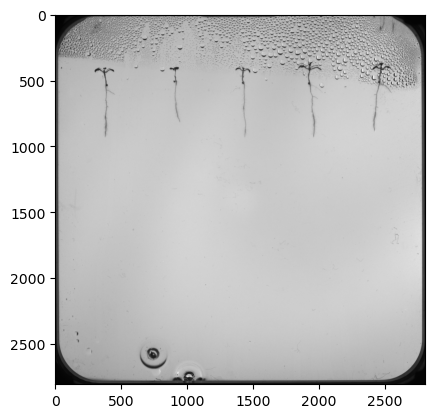

(2805, 2805, 3)
(2805, 2805, 3)


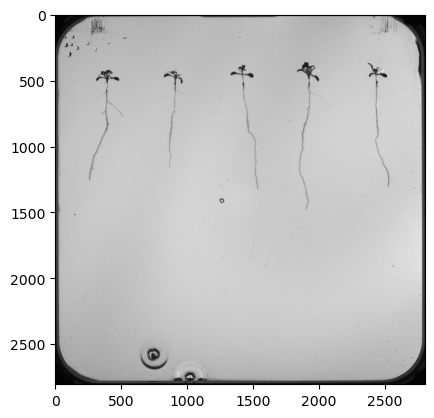

(2806, 2806, 3)
(2806, 2806, 3)


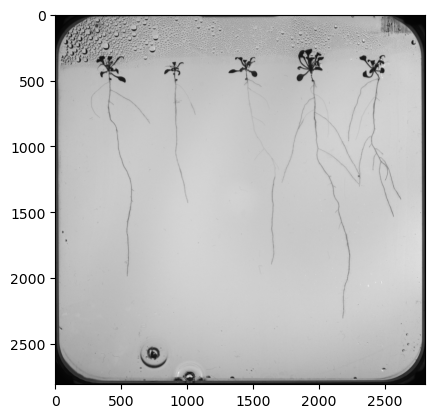

(2805, 2805, 3)
(2805, 2805, 3)


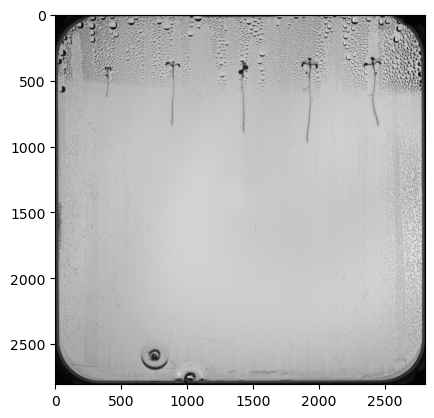

(2806, 2806, 3)
(2806, 2806, 3)


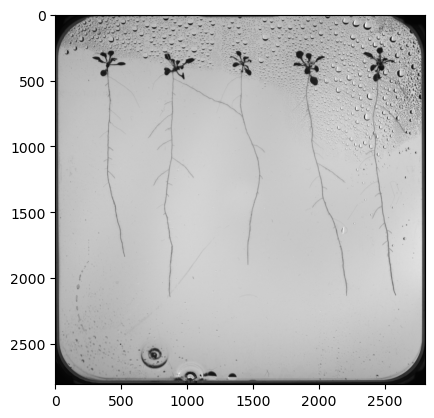

(2806, 2806, 3)
(2806, 2806, 3)


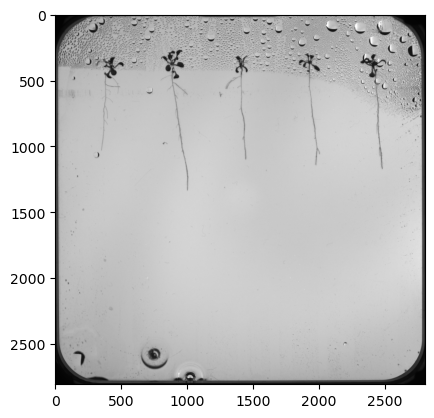

(2806, 2806, 3)
(2806, 2806, 3)


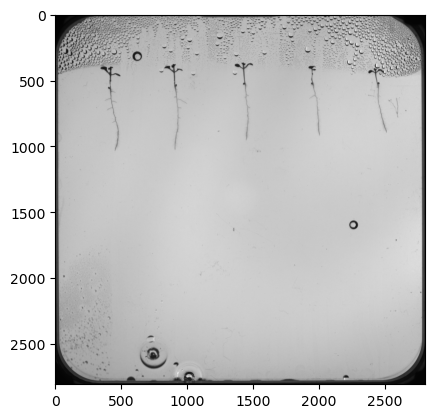

(2806, 2806, 3)
(2806, 2806, 3)


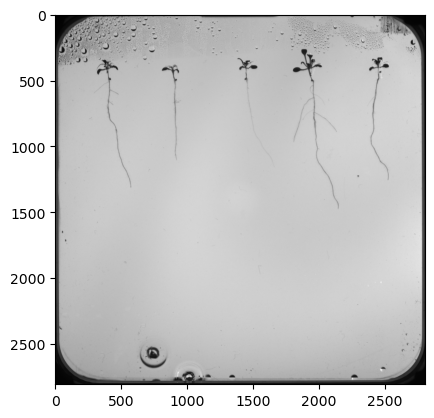

(2806, 2806, 3)
(2806, 2806, 3)


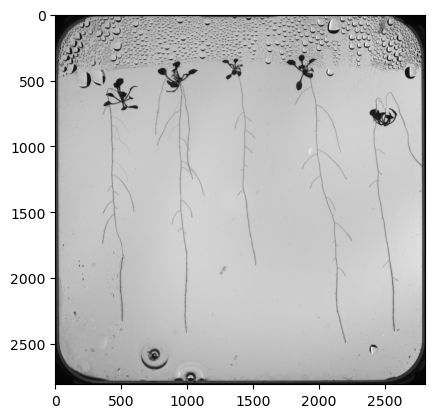

(2806, 2806, 3)
(2806, 2806, 3)


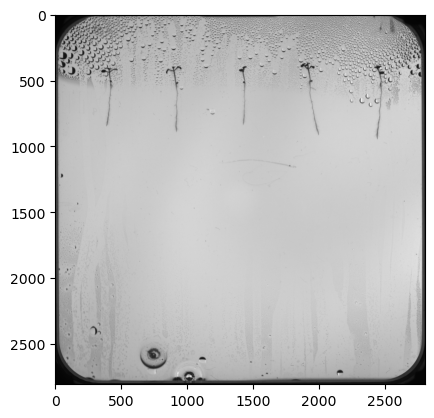

(2805, 2805, 3)
(2805, 2805, 3)


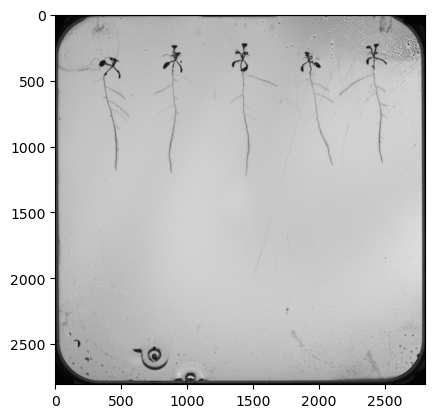

(2805, 2805, 3)
(2805, 2805, 3)


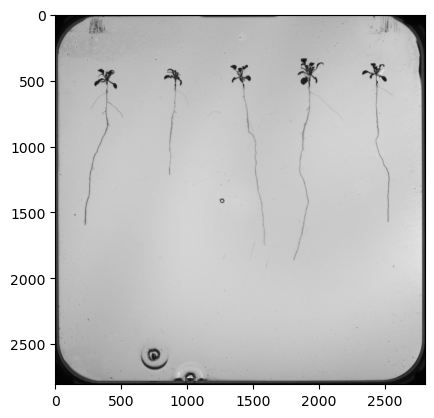

(2806, 2806, 3)
(2806, 2806, 3)


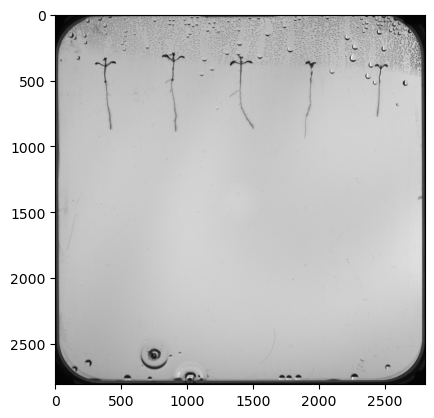

(2806, 2806, 3)
(2806, 2806, 3)


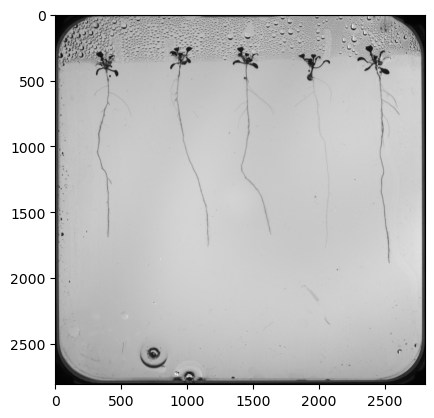

(2805, 2805, 3)
(2805, 2805, 3)


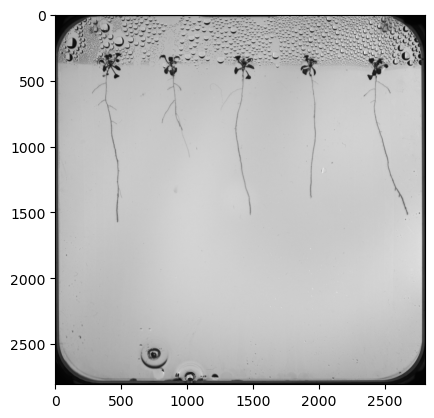

In [5]:
# Creating a list of the cropped images and masks
cropped_imgs = []
cropped_masks = []

# Cropping the images and masks
for i in range(len(images_with_masks)):
    current = images_with_masks[i]
    current = cv2.cvtColor(current, cv2.COLOR_BGR2GRAY)

    # Thresholding the image
    ret, thresh = cv2.threshold(current, 30, 100, cv2.THRESH_BINARY)

    # Getting connected components with stats
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(thresh)
    sorted_stats = stats[stats[:, cv2.CC_STAT_AREA].argsort()[::-1]]

    # Extracting the bounding box of the largest connected component
    x, y, w, h, _ = sorted_stats[0]  # using sorted_stats[1] as it is sorted and 0 is usually the background
    side_lenght = max(w, h)

    # Cropping the images to the bounding box
    cropped_image = images_with_masks[i][y:y+side_lenght, x:x+side_lenght]

    # Cropping the masks to the bounding box
    cropped_mask = masks[i][y:y+side_lenght, x:x+side_lenght]

    # Turning the images into numpy arrays
    cropped_image = np.array(cropped_image)

    # Sanity check
    print(cropped_image.shape)

    # Turning the masks into numpy arrays
    cropped_mask = np.array(cropped_mask)

    # Sanity check
    print(cropped_mask.shape)

    # Appending the cropped images and masks to a list
    cropped_imgs.append(cropped_image)
    cropped_masks.append(cropped_mask)

    # Printing the cropped images
    plt.imshow(cropped_image, cmap='nipy_spectral')
    plt.show()

In [6]:
# Sanity check
print('Number of cropped images: ', len(cropped_masks))
print('Number of images with masks: ', len(cropped_imgs))

Number of cropped images:  115
Number of images with masks:  115


In [7]:
# Setting the paths to save the images
train_path_im = r'C:\Users\daraz\Desktop\BUas\Year 2 Block B\Data for plants\train_images\train'
val_path_im = r'C:\Users\daraz\Desktop\BUas\Year 2 Block B\Data for plants\val_images\val'
test_path_im = r'C:\Users\daraz\Desktop\BUas\Year 2 Block B\Data for plants\test_images\test'

# Setting the paths to save the masks
train_path_msk = r'C:\Users\daraz\Desktop\BUas\Year 2 Block B\Data for plants\train_masks\train'
val_path_msk = r'C:\Users\daraz\Desktop\BUas\Year 2 Block B\Data for plants\val_masks\val'
test_path_msk = r'C:\Users\daraz\Desktop\BUas\Year 2 Block B\Data for plants\test_masks\test'

# Saving the images
for i, img in enumerate(cropped_imgs):
    # Using the original filenames
    filename = images_with_masks_names[i] + '.png'

    if i <= 85:
        # Saving the images in the train folder
        cv2.imwrite(os.path.join(train_path_im, filename), img)
    elif i > 85 and i <= 101:
        # Saving the images in the validation folder
        cv2.imwrite(os.path.join(val_path_im, filename), img)
    else:  # i > 90
        # Saving the images in the test folder
        cv2.imwrite(os.path.join(test_path_im, filename), img)

# Saving the masks
for i, msk in enumerate(cropped_masks):
    # Using the original filenames
    filename = images_with_masks_names[i] + '.tif'

    if i <= 85:
        # Saving the masks in the train folder
        cv2.imwrite(os.path.join(train_path_msk, filename), msk)
    elif i > 79 and i <= 101:
        # Saving the masks in the validation folder
        cv2.imwrite(os.path.join(val_path_msk, filename), msk)
    else:  # i > 90
        # Saving the masks in the test folder
        cv2.imwrite(os.path.join(test_path_msk, filename), msk)


Creating a model to detect roots

In [8]:
# Ensuring that TensorFlow is not locking down too much memory
os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'

In [9]:
# Setting the patch size and scaling factor
patch_size = 256
scaling_factor = 1

In [10]:
# Creating f1 and iou metrics
def f1(y_true, y_pred):
    def recall_m(y_true, y_pred):
        TP = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        Positives = K.sum(K.round(K.clip(y_true, 0, 1)))
        recall = TP / (Positives+K.epsilon())
        return recall
    
    def precision_m(y_true, y_pred):
        TP = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        Pred_Positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
        precision = TP / (Pred_Positives+K.epsilon())
        return precision
    
    precision, recall = precision_m(y_true, y_pred), recall_m(y_true, y_pred)
    
    return 2*((precision*recall)/(precision+recall+K.epsilon()))

def iou(y_true, y_pred):
    def f(y_true, y_pred):
        intersection = K.sum(K.abs(y_true * y_pred), axis=[1,2,3])
        total = K.sum(K.square(y_true),[1,2,3]) + K.sum(K.square(y_pred),[1,2,3])
        union = total - intersection
        return (intersection + K.epsilon()) / (union + K.epsilon())
    return K.mean(f(y_true, y_pred), axis=-1)

In [11]:
model = keras.models.load_model('C:/Users/daraz/Desktop/BUas/Year 2 Block B/modelV9.h5', custom_objects={'f1': f1, 'iou': iou})

In [12]:
# Setting input and output directories
image_dir = r'C:\Users\daraz\Desktop\BUas\Year 2 Block B\Data for plants\test_images\test'

# Creating lists for storing patches, images and reconstructed masks
patches_list = []
images = []
reconstructed_masks = []

# Looping through the images in the image directory
for image_filename in os.listdir(image_dir):
    if image_filename.endswith(".png"):
        image_path = os.path.join(image_dir, image_filename)
        image = cv2.imread(image_path)
        images.append(image)
 
        # Calculating new dimensions after scaling
        new_height = int(image.shape[0] * scaling_factor)
        new_width = int(image.shape[1] * scaling_factor)

        # Ensuring the new dimensions are divisible by the patch size
        if new_height % patch_size != 0:
            new_height += patch_size - (new_height % patch_size)
        if new_width % patch_size != 0:
            new_width += patch_size - (new_width % patch_size)

        # Resizing image
        resized_image = cv2.resize(image, (new_width, new_height))

        # Creating patches
        patches = patchify(resized_image, (patch_size, patch_size, 3), step=patch_size)
        patches = patches.reshape(-1, patch_size, patch_size, 3)
        patches_list.append(patches)

# Predicting and reconstructing masks 
for patches in patches_list:
    predicted_masks_batch = model.predict(patches/255)
    reshaped_masks_array = predicted_masks_batch.reshape(-1, patch_size, patch_size, 1)

    # Calculating grid size
    grid_size = int(np.sqrt(len(reshaped_masks_array)))

    # Unpatchifying the masks
    reshaped_masks_array = reshaped_masks_array.reshape(grid_size, grid_size, patch_size, patch_size)
    reconstructed_mask = unpatchify(reshaped_masks_array, (new_height, new_width))
    reconstructed_masks.append(reconstructed_mask > 0.05)

# Renaming the reconstructed masks
test_masks = reconstructed_masks

4/4 [==============================] - 0s 73ms/step


In [13]:
# Setting input and output directories
image_dir = r'C:\Users\daraz\Desktop\BUas\Year 2 Block B\Data for plants\train_images\train'

# Creating lists for storing patches, images and reconstructed masks
patches_list = []
images = []
reconstructed_masks = []

# Looping through the images in the image directory
for image_filename in os.listdir(image_dir):
    if image_filename.endswith(".png"):
        image_path = os.path.join(image_dir, image_filename)
        image = cv2.imread(image_path)
        images.append(image)

        # Calculating new dimensions after scaling
        new_height = int(image.shape[0] * scaling_factor)
        new_width = int(image.shape[1] * scaling_factor)

        # Ensuring the new dimensions are divisible by the patch size
        if new_height % patch_size != 0:
            new_height += patch_size - (new_height % patch_size)
        if new_width % patch_size != 0:
            new_width += patch_size - (new_width % patch_size)

        # Resizing image
        resized_image = cv2.resize(image, (new_width, new_height))

        # Creating patches
        patches = patchify(resized_image, (patch_size, patch_size, 3), step=patch_size)
        patches = patches.reshape(-1, patch_size, patch_size, 3)
        patches_list.append(patches)

# Predicting and reconstructing masks
for patches in patches_list:
    predicted_masks_batch = model.predict(patches/255)
    reshaped_masks_array = predicted_masks_batch.reshape(-1, patch_size, patch_size, 1)

    # Calculating grid size
    grid_size = int(np.sqrt(len(reshaped_masks_array)))

    # Unpatchifying the masks
    reshaped_masks_array = reshaped_masks_array.reshape(grid_size, grid_size, patch_size, patch_size)
    reconstructed_mask = unpatchify(reshaped_masks_array, (new_height, new_width))
    reconstructed_masks.append(reconstructed_mask > 0.05)

# Renaming the reconstructed masks
train_masks = reconstructed_masks

4/4 [==============================] - 0s 73ms/step


In [14]:
# Setting input and output directories
image_dir = r'C:\Users\daraz\Desktop\BUas\Year 2 Block B\Data for plants\val_images\val'

# Creating lists for storing patches, images and reconstructed masks
patches_list = []
images = []
reconstructed_masks = []

# Looping through the images in the image directory
for image_filename in os.listdir(image_dir):
    if image_filename.endswith(".png"):
        image_path = os.path.join(image_dir, image_filename)
        image = cv2.imread(image_path)
        images.append(image)

        # Calculating new dimensions after scaling
        new_height = int(image.shape[0] * scaling_factor)
        new_width = int(image.shape[1] * scaling_factor)

        # Ensuring the new dimensions are divisible by the patch size
        if new_height % patch_size != 0:
            new_height += patch_size - (new_height % patch_size)
        if new_width % patch_size != 0:
            new_width += patch_size - (new_width % patch_size)

        # Resizing image
        resized_image = cv2.resize(image, (new_width, new_height))

        # Creating patches
        patches = patchify(resized_image, (patch_size, patch_size, 3), step=patch_size)
        patches = patches.reshape(-1, patch_size, patch_size, 3)
        patches_list.append(patches)

# Predicting and reconstructing masks
for patches in patches_list:
    predicted_masks_batch = model.predict(patches/255)
    reshaped_masks_array = predicted_masks_batch.reshape(-1, patch_size, patch_size, 1)

    # Calculating grid size
    grid_size = int(np.sqrt(len(reshaped_masks_array)))

    # Unpatchifying the masks
    reshaped_masks_array = reshaped_masks_array.reshape(grid_size, grid_size, patch_size, patch_size)
    reconstructed_mask = unpatchify(reshaped_masks_array, (new_height, new_width))
    reconstructed_masks.append(reconstructed_mask > 0.05)

# Renaming the reconstructed masks
val_masks = reconstructed_masks

4/4 [==============================] - 0s 73ms/step


In [15]:
# Combining the masks
masks = np.concatenate((train_masks, val_masks, test_masks))

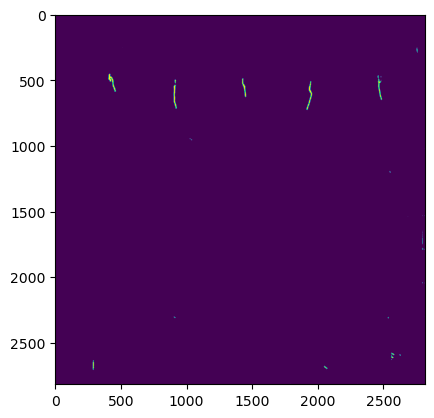

In [16]:
plt.imshow(masks[1], cmap='viridis')

Instance segmentation

In [17]:
# Setting the parameters
min_area_threshold = 50
top_position_threshold_bottom = 1300
top_position_threshold_top = 350
thin_line_threshold = 100
long_line_threshold = 200

In [18]:
np.unique(masks[0])

array([False,  True])

Number of components detected: 112


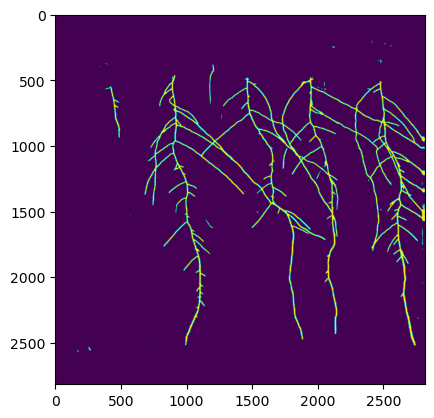

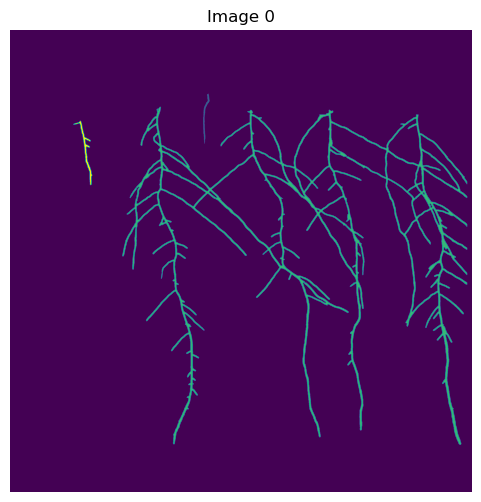

[[      0       0    2816    2816 7640221]
 [   1178     388      38     306    2349]
 [    685     468    2101    2060  282254]
 [    387     554     114     391    5032]]
Number of components detected: 66


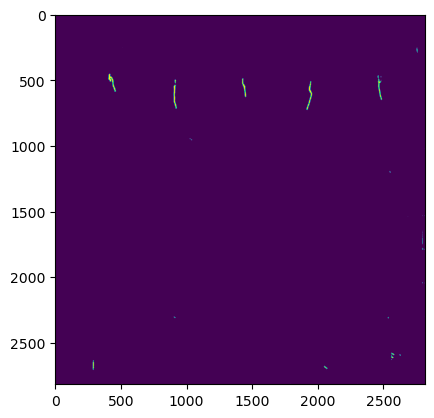

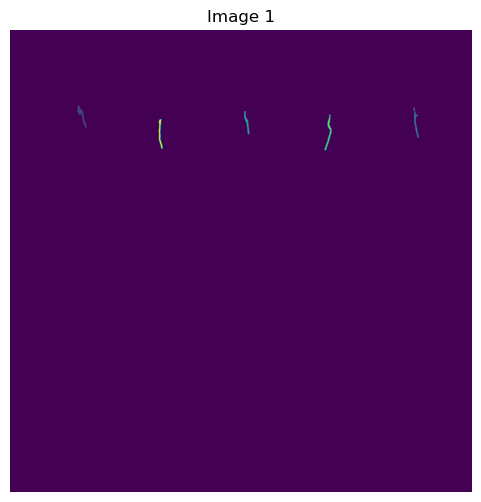

[[      0       0    2816    2816 7920769]
 [    409     459      59     136    2098]
 [   2460     470      32     188    1644]
 [   1428     494      30     142    1384]
 [   1918     515      42     219    2179]
 [    907     543      24     181    1782]]
Number of components detected: 155


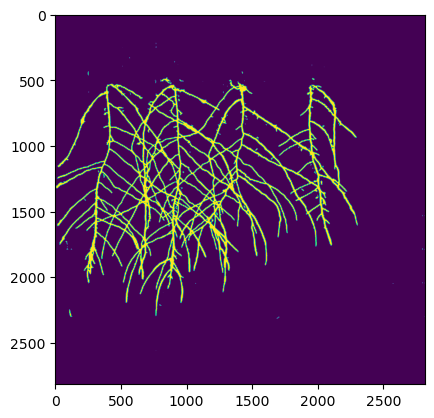

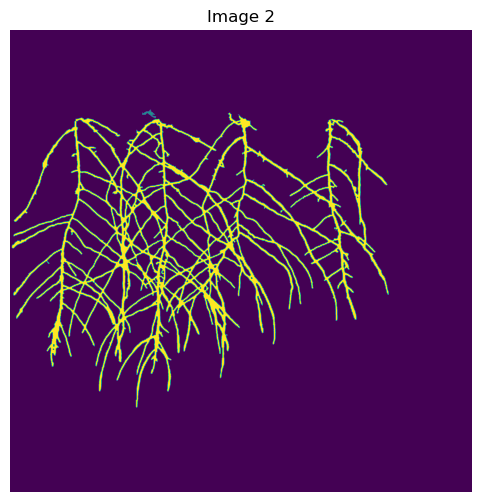

[[      0       0    2816    2816 7334491]
 [    805     486      85      52    1349]
 [     12     504    2296    1797  594016]]
Number of components detected: 45


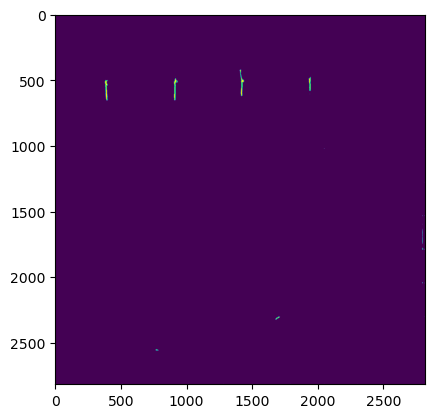

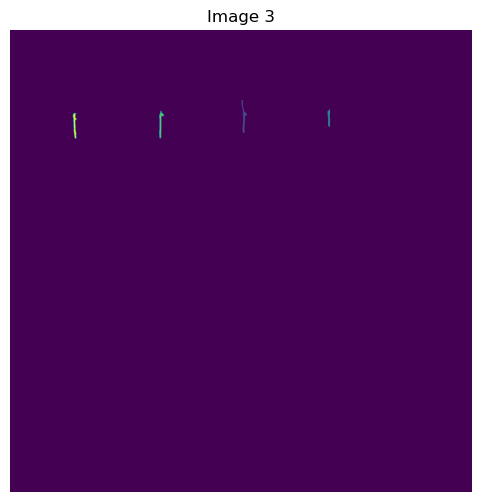

[[      0       0    2816    2816 7923188]
 [   1410     428      32     200    1863]
 [   1935     482      16     107    1081]
 [    910     492      28     168    1898]
 [    384     506      22     155    1826]]
Number of components detected: 100


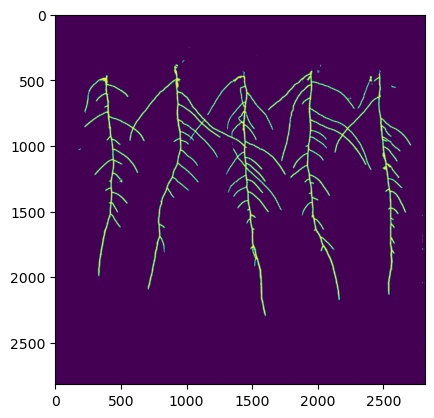

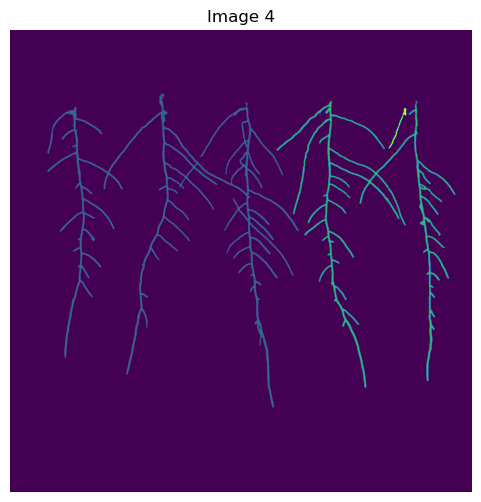

[[      0       0    2816    2816 7677539]
 [    227     387    1534    1915  150403]
 [   1626     428    1088    1752   99618]
 [   2308     476     110     247    2296]]
Number of components detected: 54


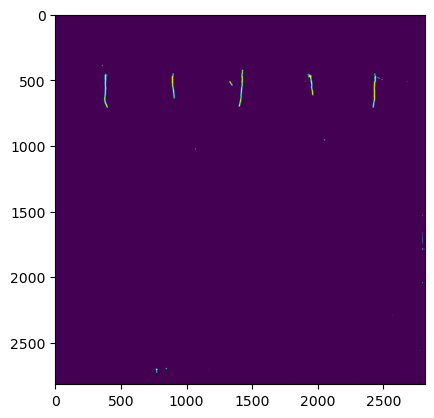

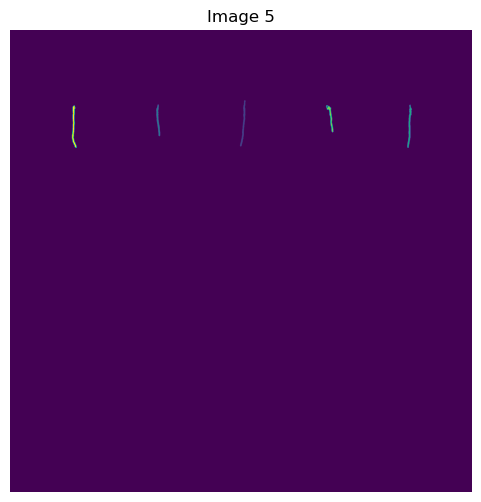

[[      0       0    2816    2816 7918357]
 [   1402     428      34     282    2683]
 [    892     454      23     193    1838]
 [   2422     454      28     264    2474]
 [   1927     458      44     165    1828]
 [    378     460      29     258    2676]]
Number of components detected: 61


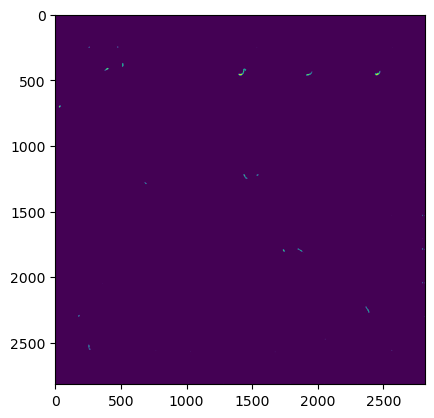

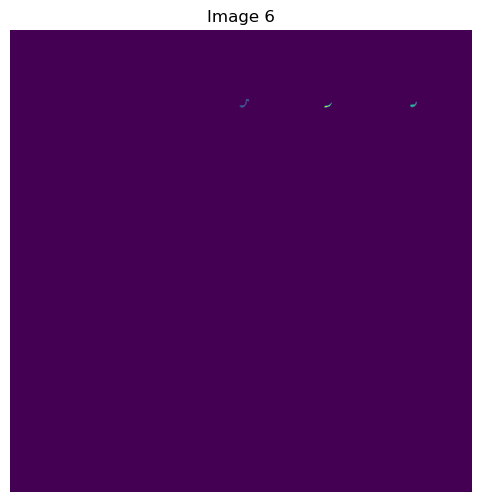

[[      0       0    2816    2816 7928428]
 [   1400     421      57      51     650]
 [   2440     437      40      33     470]
 [   1916     442      45      30     308]]
Number of components detected: 128


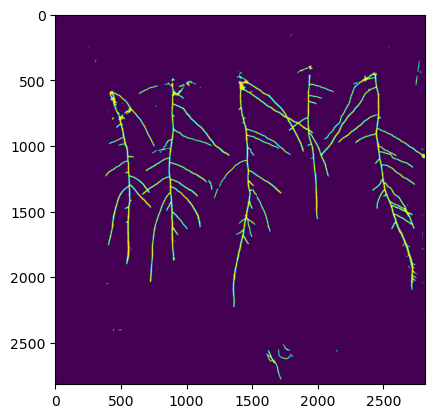

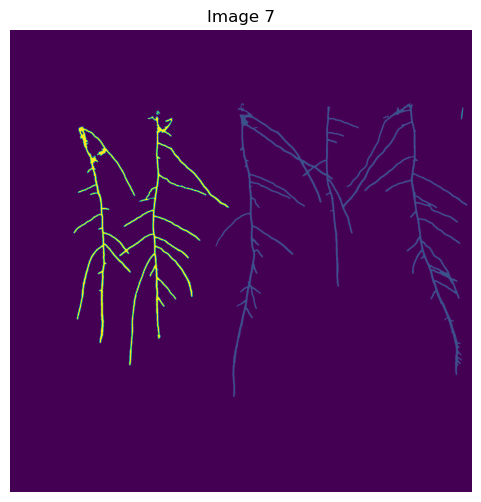

[[      0       0    2816    2816 7705429]
 [   1253     446    1533    1790  134841]
 [   2749     472      13      73     457]
 [    892     491      22      25     343]
 [    387     526     947    1518   88786]]
Number of components detected: 222


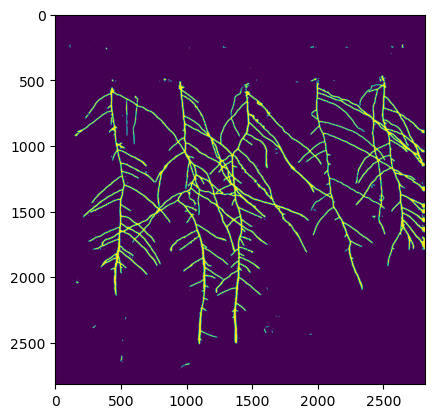

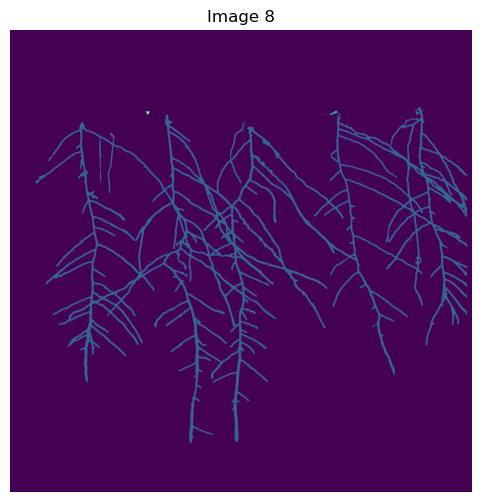

[[      0       0    2816    2816 7446427]
 [    154     469    2632    2048  482643]
 [   1949     491      51      25     498]
 [    827     494      22      22     288]]
Number of components detected: 48


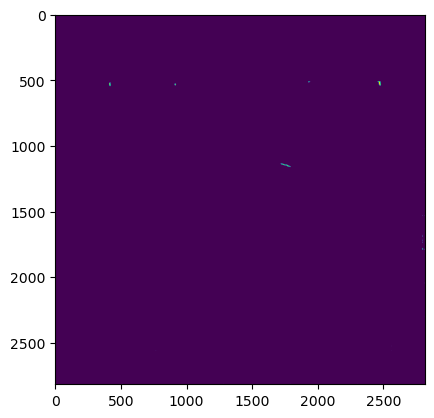

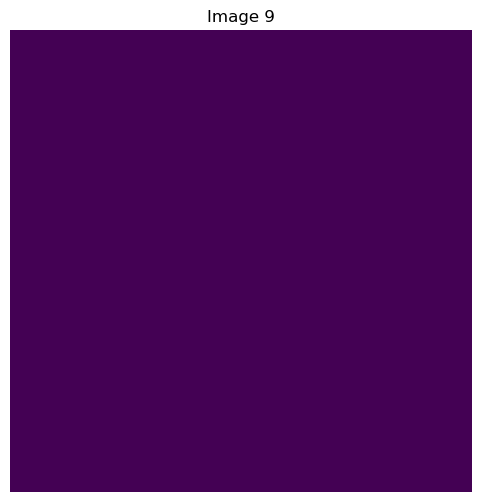

[[      0       0    2816    2816 7929856]]
Number of components detected: 82


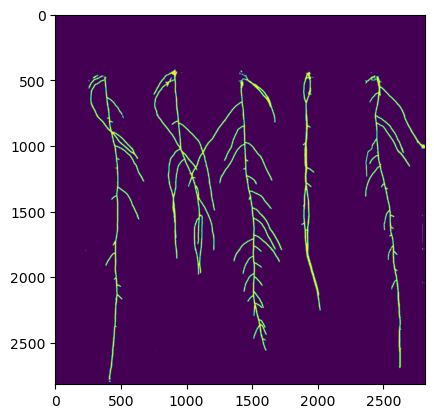

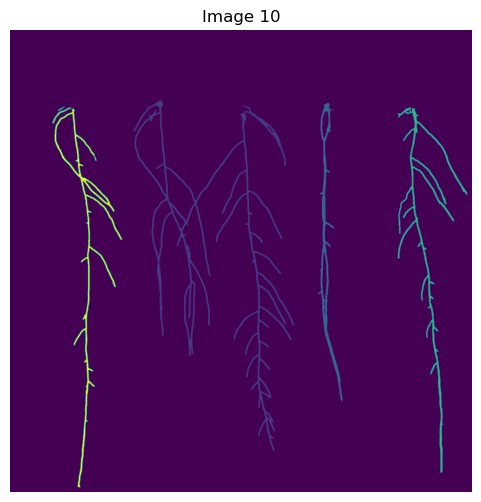

[[      0       0    2816    2816 7664326]
 [    754     425     981    2139  132747]
 [   1879     445     147    1816   34522]
 [    292     467      44      28     435]
 [   2363     470     423    2229   50873]
 [    260     472     114     100    1483]
 [    272     477     412    2310   45470]]
Number of components detected: 72


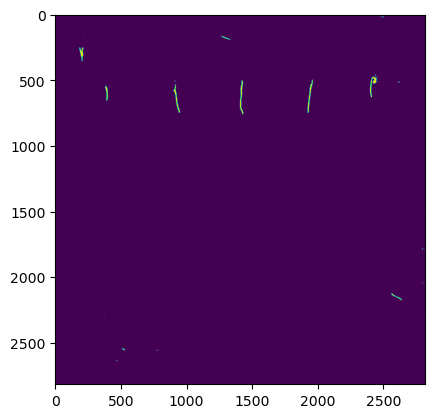

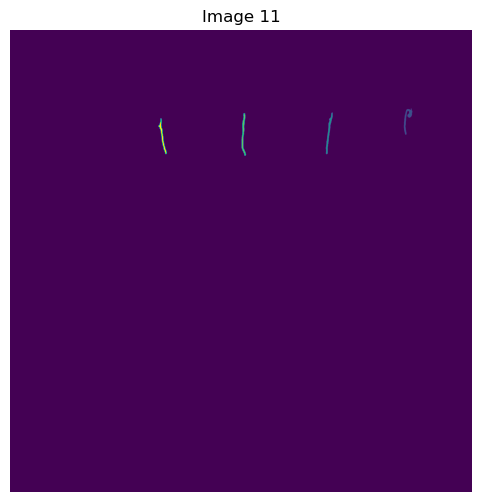

[[      0       0    2816    2816 7919977]
 [   2401     478      51     160    2475]
 [   1926     503      40     254    2499]
 [   1412     506      26     260    2684]
 [    903     537      53     219    2221]]
Number of components detected: 239


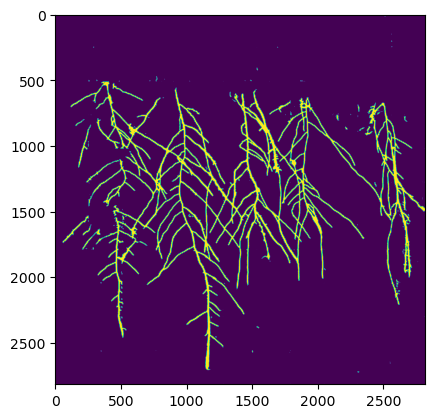

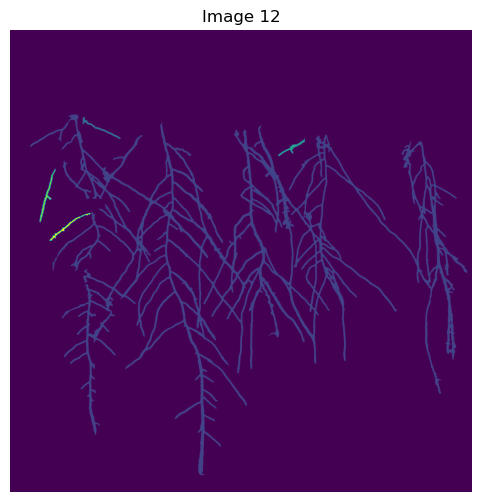

[[      0       0    2816    2816 7386139]
 [    123     516    2663    2197  531934]
 [    442     529     232     135    2707]
 [   1635     662     161     106    2406]
 [    180     847      98     325    3853]
 [    240    1116     250     168    2817]]
Number of components detected: 55


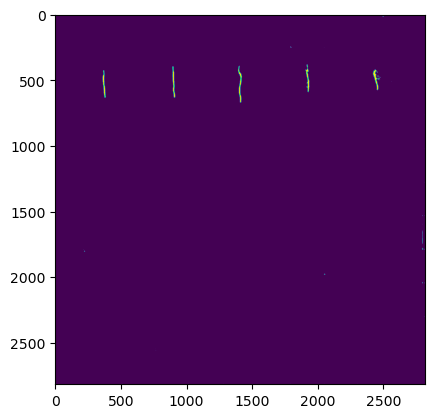

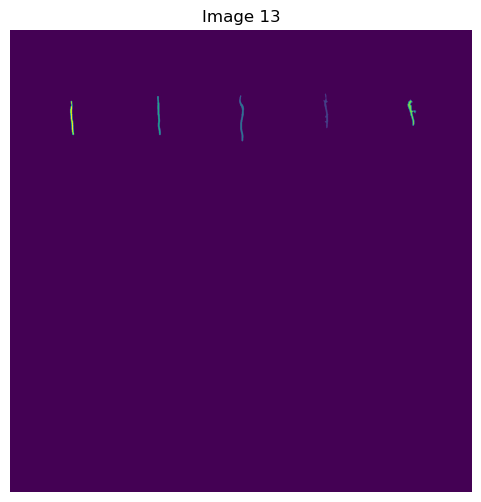

[[      0       0    2816    2816 7918520]
 [   1911     386      30     212    2157]
 [   1398     399      28     279    2720]
 [    897     404      21     236    2252]
 [   2424     425      52     158    2219]
 [    367     433      23     207    1988]]
Number of components detected: 170


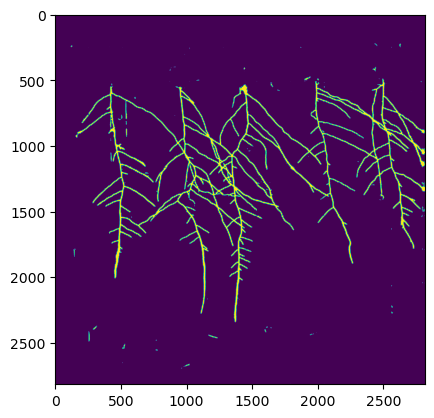

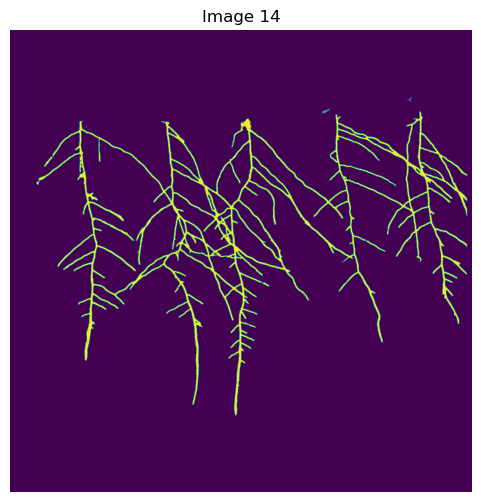

[[      0       0    2816    2816 7587120]
 [   2421     407      26      34     323]
 [   1902     481      48      31     480]
 [    161     496    2625    1853  341933]]
Number of components detected: 25


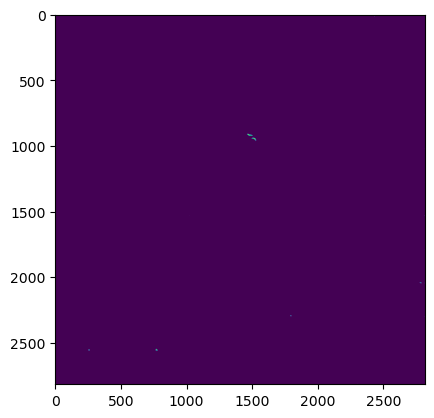

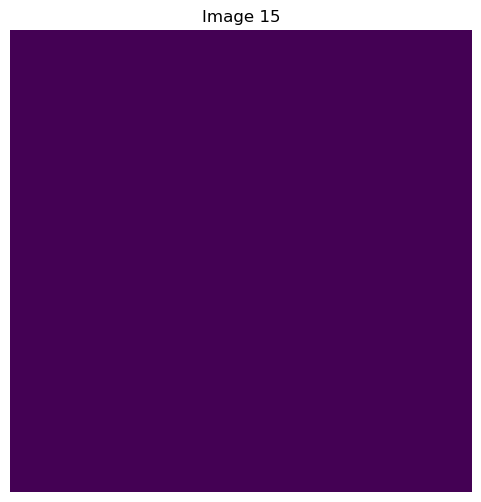

[[      0       0    2816    2816 7929856]]
Number of components detected: 192


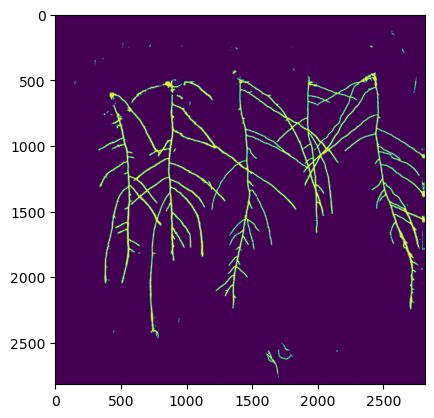

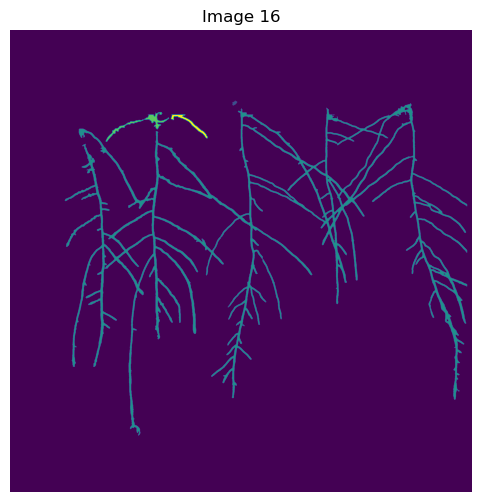

[[      0       0    2816    2816 7586141]
 [   1355     431      30      29     508]
 [    334     447    2452    2024  332105]
 [    584     501     385     180    7219]
 [    982     515     223     145    3883]]
Number of components detected: 22


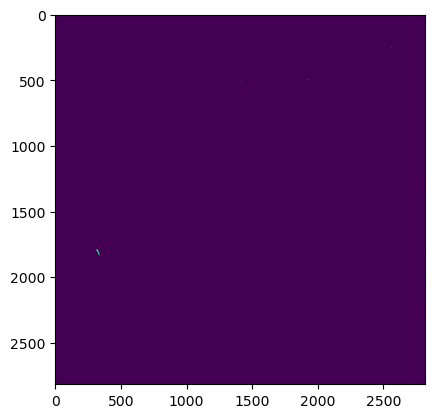

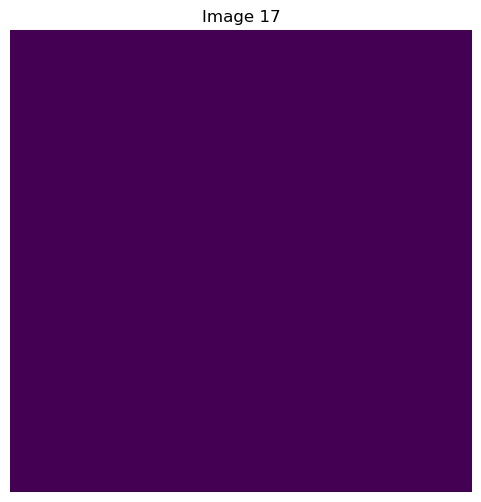

[[      0       0    2816    2816 7929856]]
Number of components detected: 25


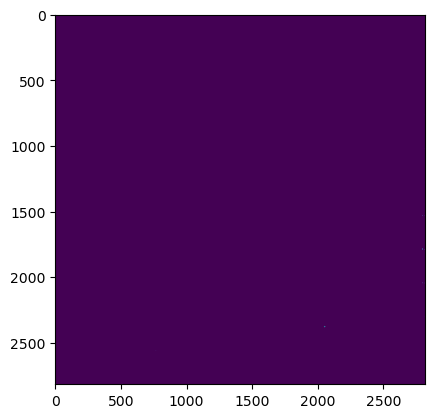

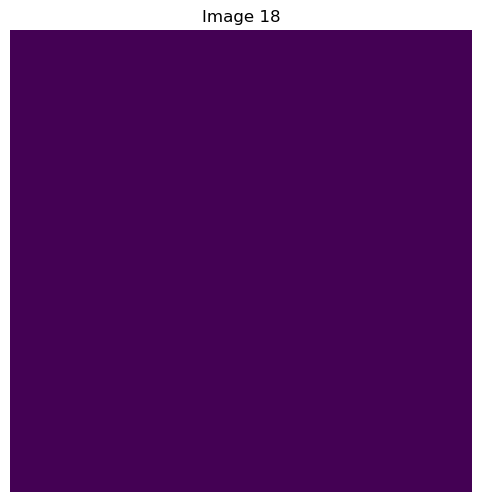

[[      0       0    2816    2816 7929856]]
Number of components detected: 214


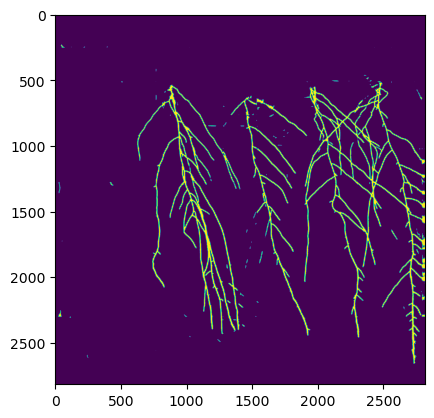

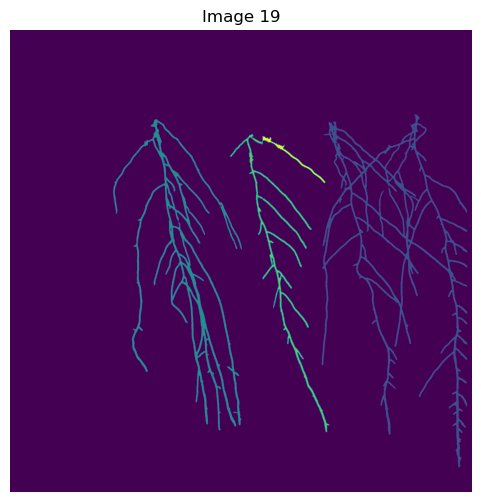

[[      0       0    2816    2816 7573850]
 [   1900     515     886    2150  179271]
 [    629     542     785    1897  125824]
 [   1341     633     605    1818   45045]
 [   1540     646     382     286    5866]]
Number of components detected: 119


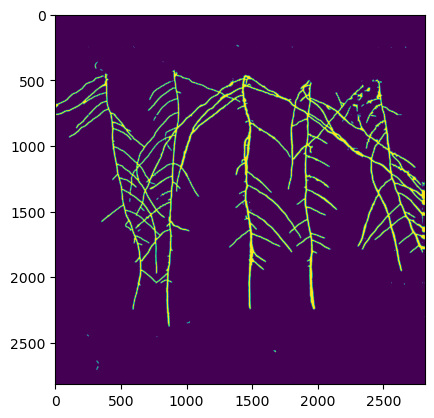

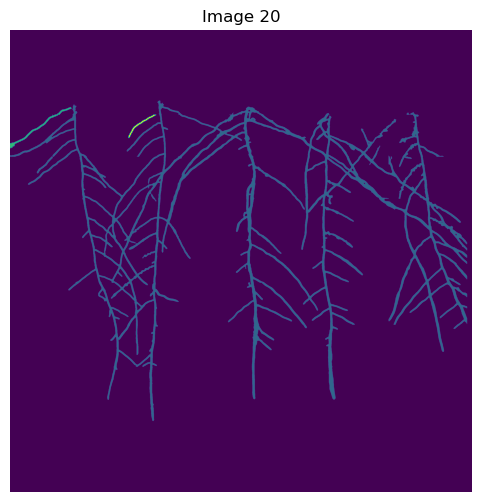

[[      0       0    2816    2816 7500361]
 [      0     428    2786    1955  422984]
 [      0     470     374     250    4645]
 [    721     516     170     142    1866]]
Number of components detected: 52


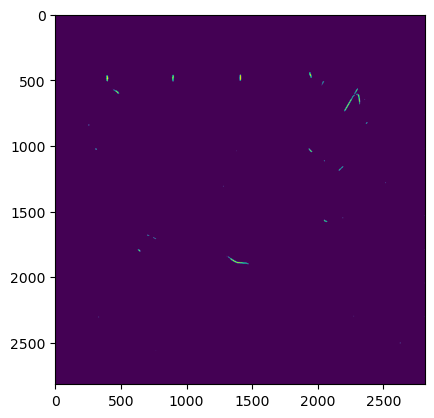

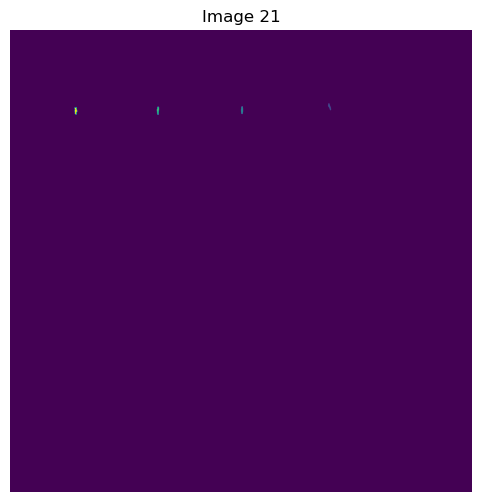

[[      0       0    2816    2816 7928094]
 [   1938     447      19      42     371]
 [   1408     466      12      46     436]
 [    896     468      12      48     463]
 [    394     470      17      46     492]]
Number of components detected: 131


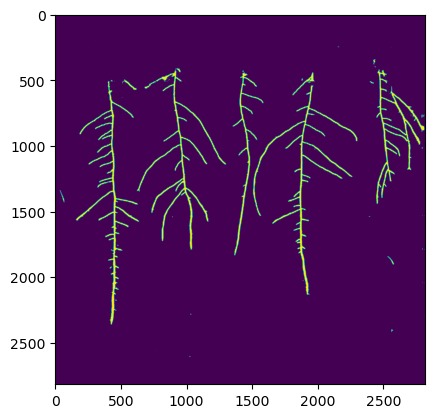

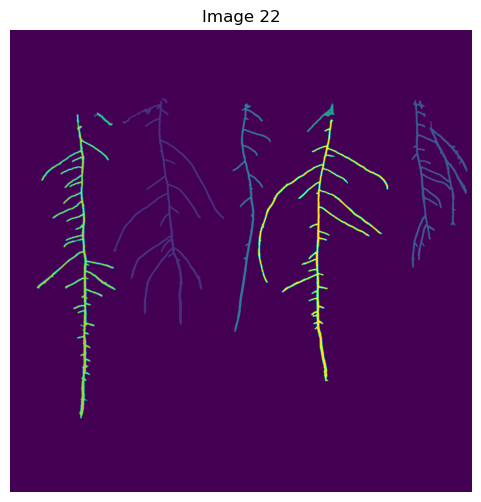

[[      0       0    2816    2816 7685373]
 [    628     416     678    1380   55537]
 [   2448     427     338    1022   43334]
 [   1356     446     234    1394   24277]
 [   1811     447     170     175    3487]
 [    515     502     110      80    1532]
 [    164     512     480    1855   57188]
 [   1512     543     794    1599   59128]]
Number of components detected: 62


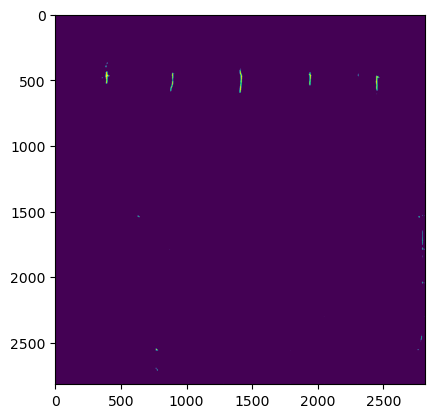

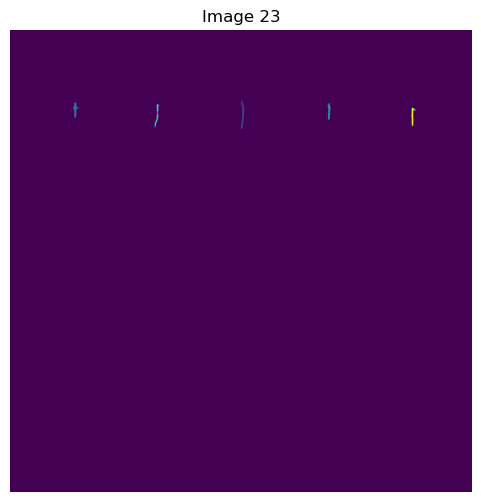

[[      0       0    2816    2816 7923683]
 [   1408     429      20     175    1680]
 [    385     440      33      94    1242]
 [   1936     446      18     101     986]
 [    882     452      29     140    1066]
 [   2446     473      26     113    1199]]
Number of components detected: 118


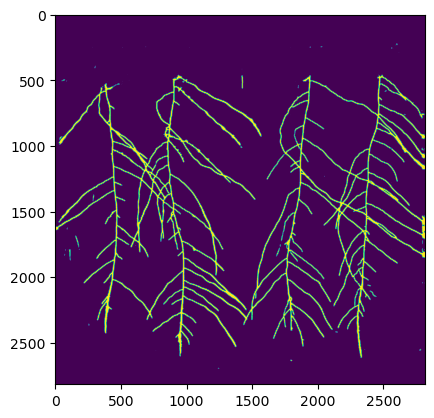

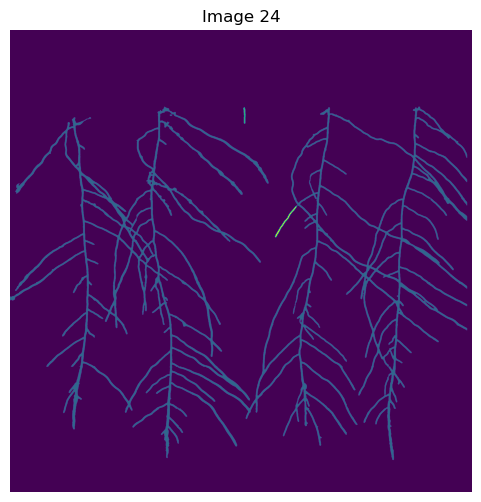

[[      0       0    2816    2816 7440378]
 [      0     467    2786    2154  486930]
 [   1422     470      14     101     821]
 [   1616    1071     134     192    1727]]
Number of components detected: 54


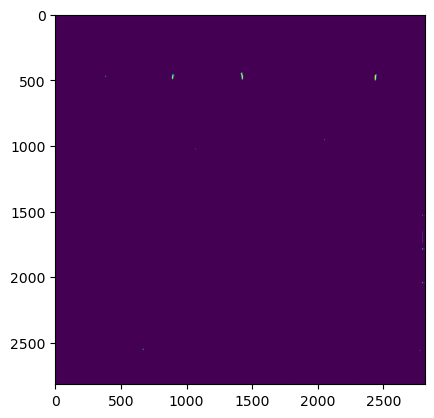

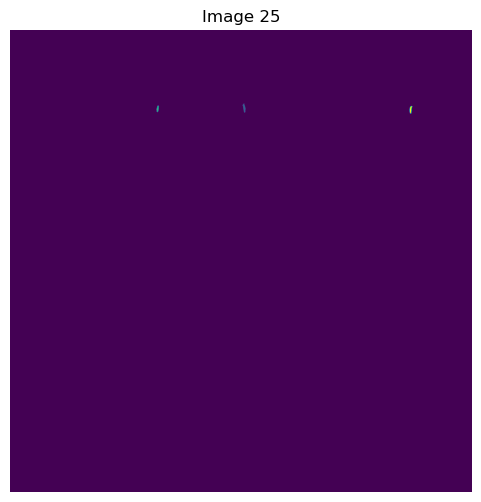

[[      0       0    2816    2816 7928522]
 [   1418     448      17      55     516]
 [    894     461      13      39     348]
 [   2436     464      16      46     470]]
Number of components detected: 58


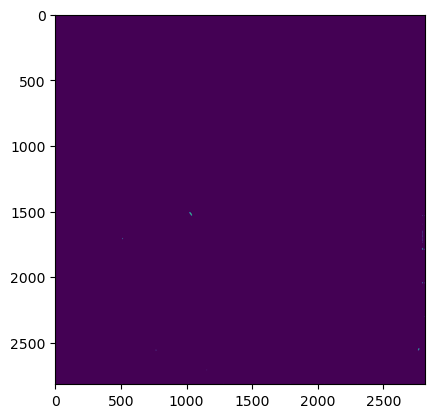

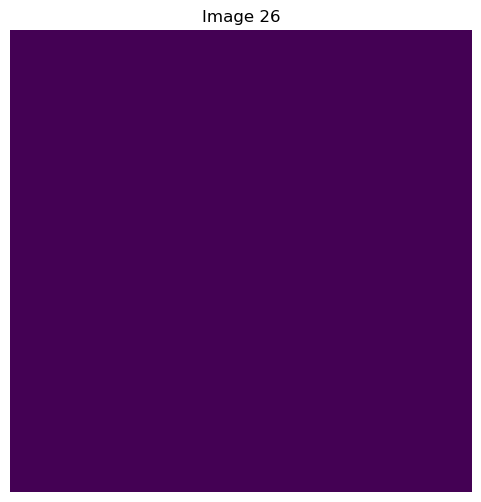

[[      0       0    2816    2816 7929856]]
Number of components detected: 124


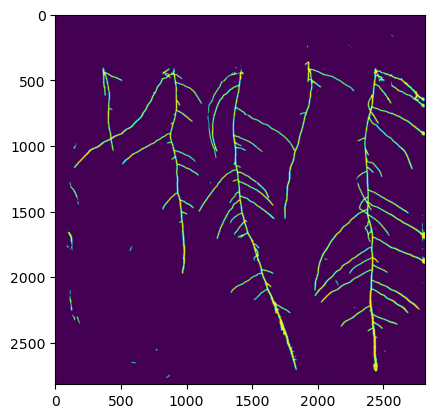

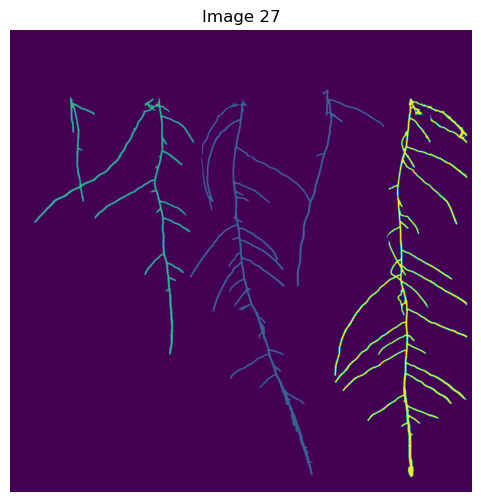

[[      0       0    2816    2816 7666863]
 [   1097     365    1184    2348   97000]
 [    148     406     974    1573   54881]
 [   1977     416     809    2309  111112]]
Number of components detected: 29


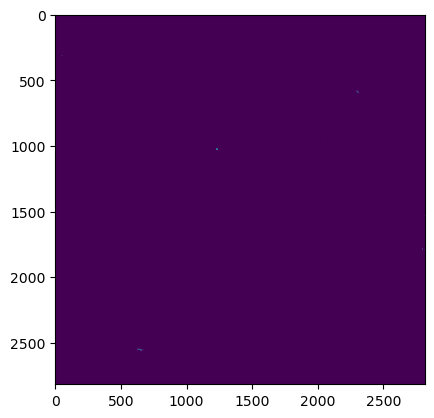

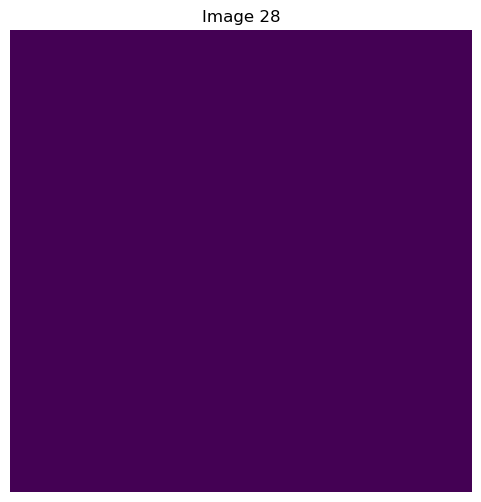

[[      0       0    2816    2816 7929856]]
Number of components detected: 156


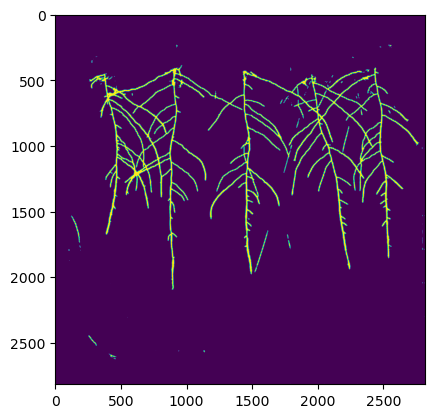

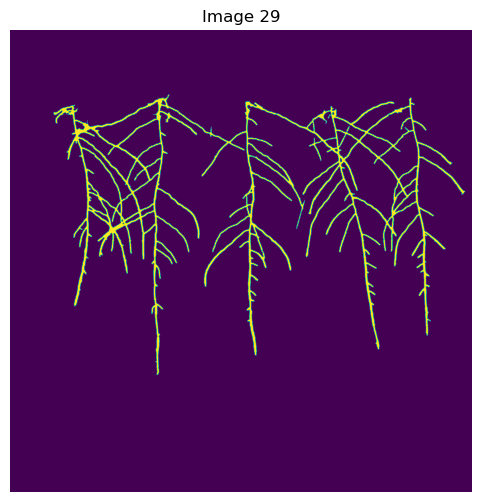

[[      0       0    2816    2816 7598209]
 [    265     392    2509    1710  331647]]
Number of components detected: 51


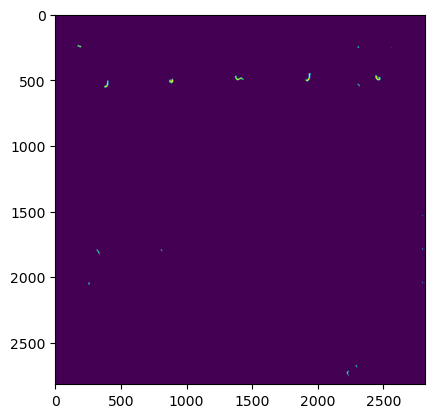

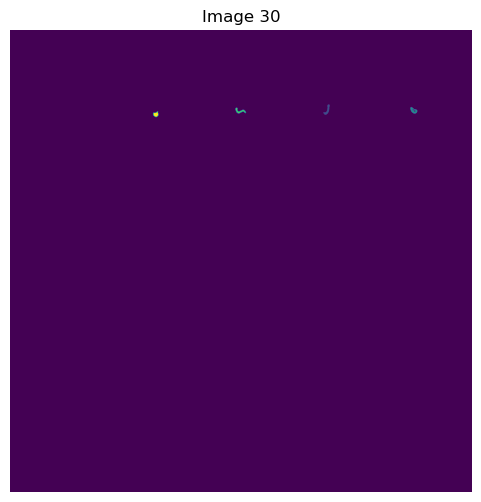

[[      0       0    2816    2816 7926595]
 [   1910     454      39      62     855]
 [   2440     470      42      39     850]
 [   1374     474      64      34     832]
 [    872     494      33      36     724]]
Number of components detected: 107


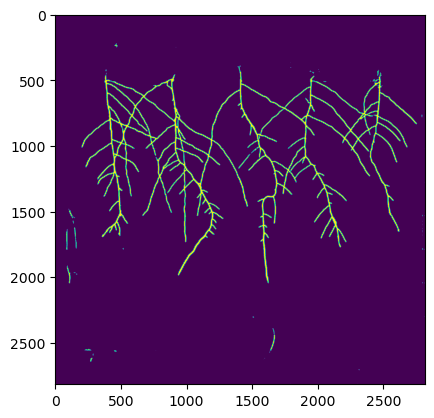

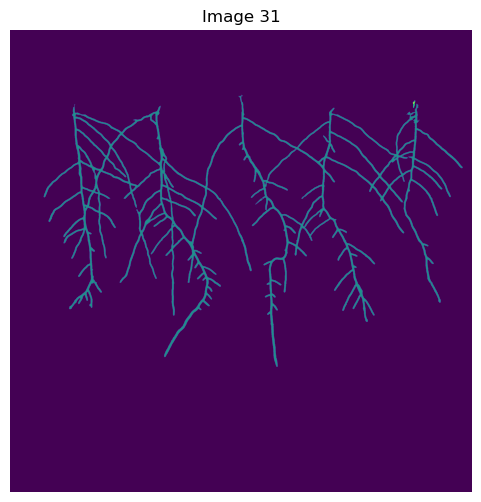

[[      0       0    2816    2816 7648929]
 [    206     396    2552    1656  280637]
 [   2456     430      13      45     290]]
Number of components detected: 20


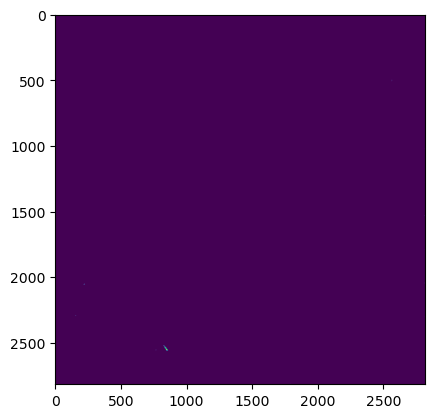

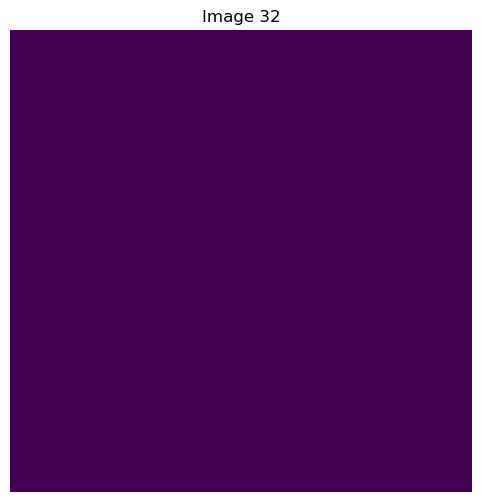

[[      0       0    2816    2816 7929856]]
Number of components detected: 209


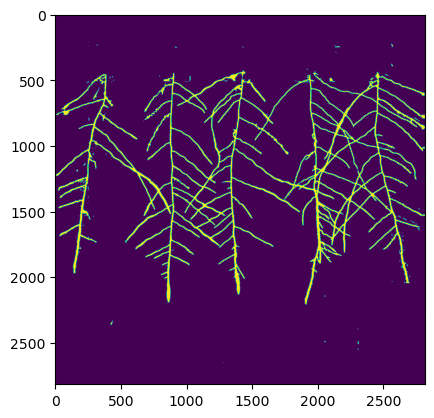

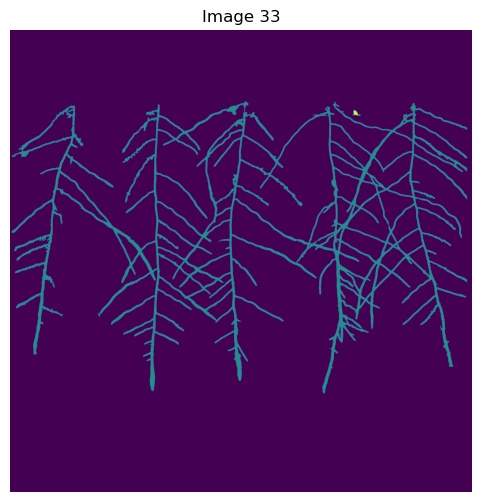

[[      0       0    2816    2816 7428803]
 [     10     433    2776    1782  500340]
 [   2090     488      45      34     713]]
Number of components detected: 43


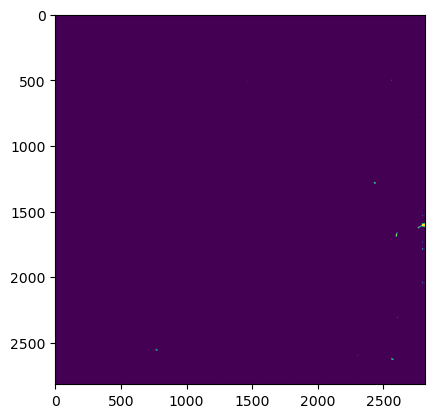

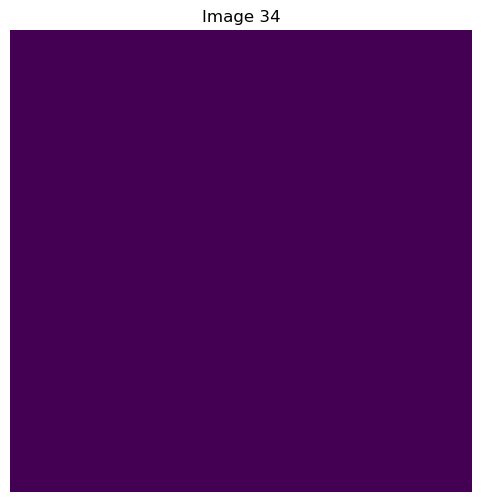

[[      0       0    2816    2816 7929856]]
Number of components detected: 94


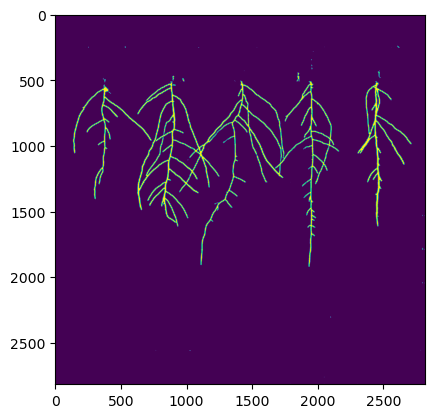

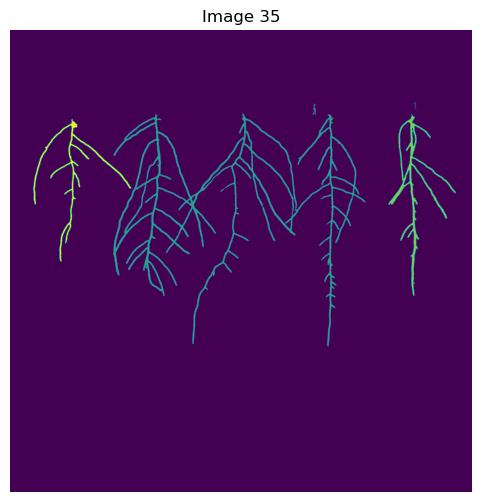

[[      0       0    2816    2816 7711494]
 [   2462     440      22      49     293]
 [   1843     449      24      67     672]
 [    630     508    1536    1419  155169]
 [   2308     516     410    1104   36684]
 [    141     542     597     870   25544]]
Number of components detected: 51


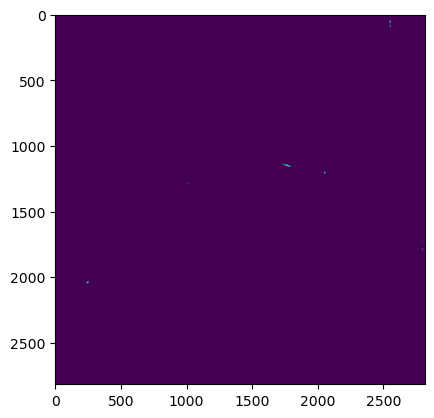

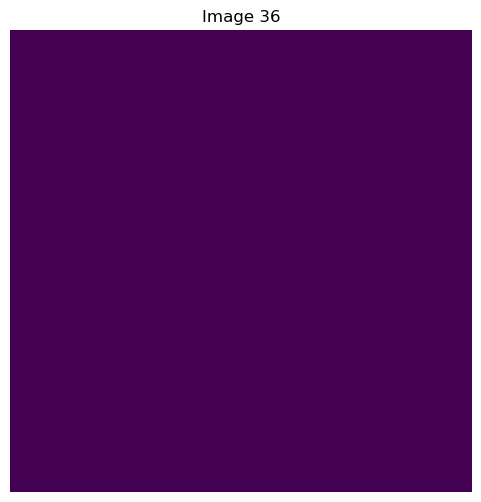

[[      0       0    2816    2816 7929856]]
Number of components detected: 101


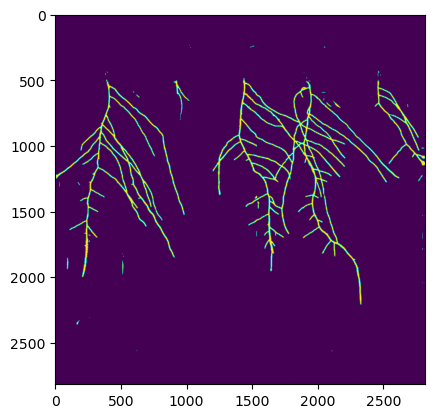

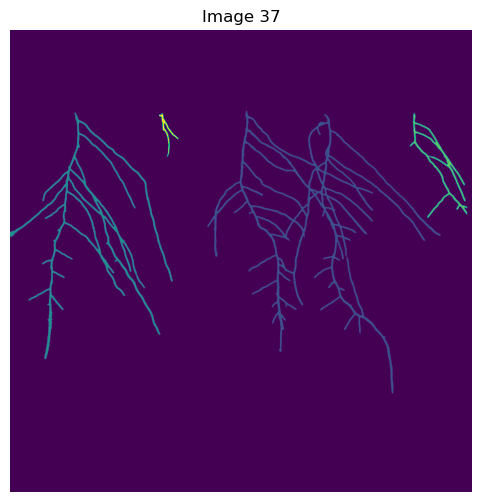

[[      0       0    2816    2816 7658928]
 [   1204     490    1421    1725  157242]
 [      0     502     991    1504   88622]
 [   2438     504     348     641   21218]
 [    909     508     119     264    3846]]
Number of components detected: 159


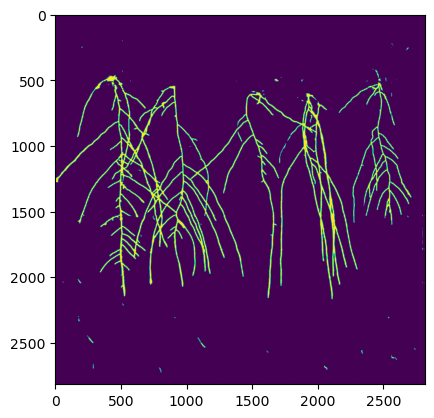

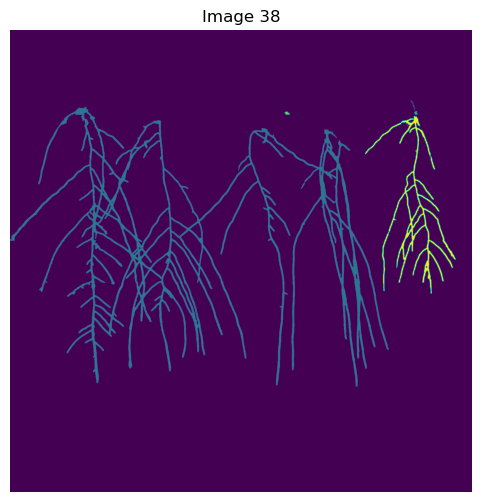

[[      0       0    2816    2816 7514869]
 [   2441     429      30      61     485]
 [      0     469    2308    1705  361814]
 [   2464     494      20      23     301]
 [   1674     498      33      18     399]
 [   2164     524     553    1083   51988]]
Number of components detected: 65


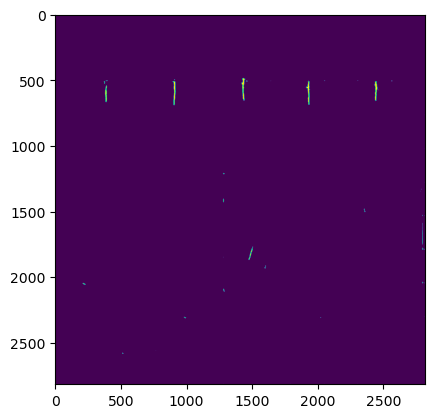

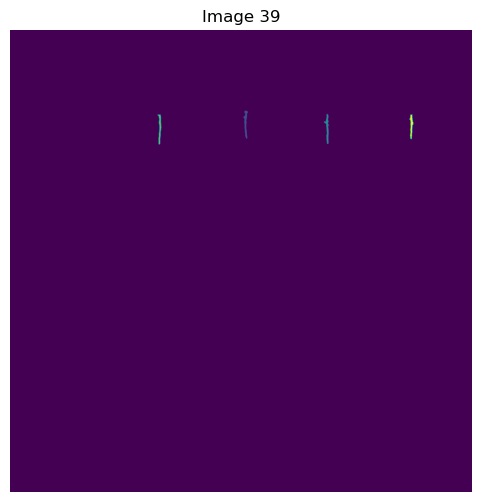

[[      0       0    2816    2816 7922190]
 [   1424     492      26     170    2008]
 [   1914     510      30     184    1955]
 [    900     516      22     181    1887]
 [   2432     516      27     149    1816]]
Number of components detected: 25


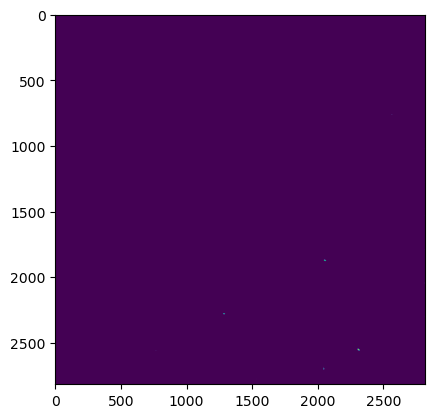

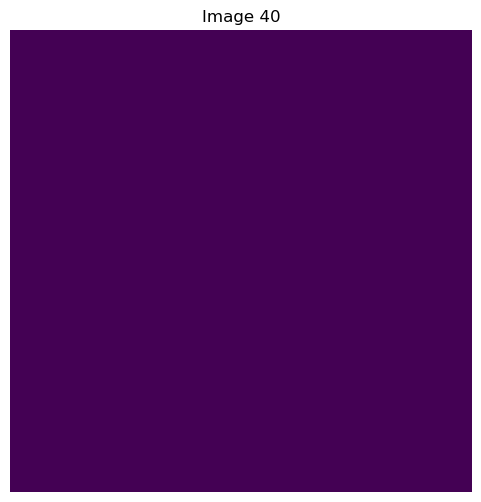

[[      0       0    2816    2816 7929856]]
Number of components detected: 130


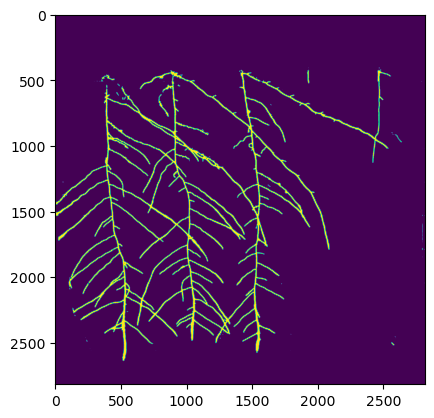

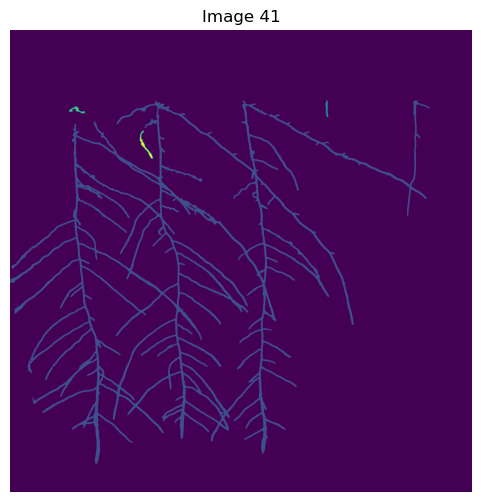

[[      0       0    2816    2816 7515260]
 [      0     423    2561    2221  410238]
 [   1923     428      18     103     998]
 [    360     465      97      44    1272]
 [    792     614      79     171    2088]]
Number of components detected: 29


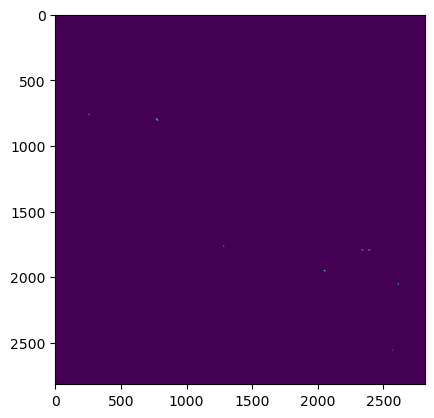

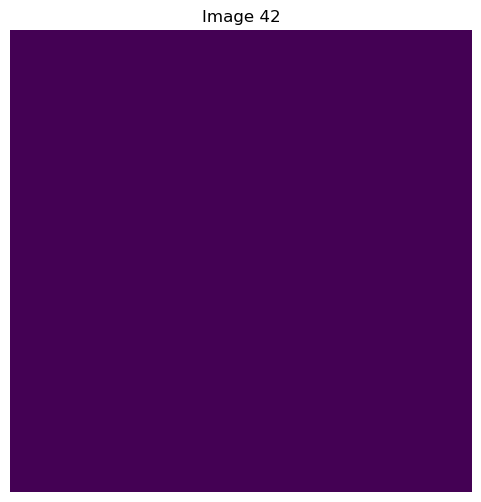

[[      0       0    2816    2816 7929856]]
Number of components detected: 92


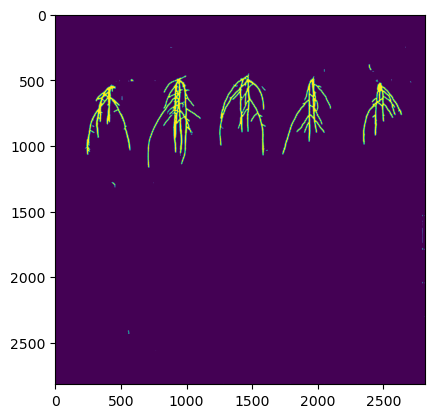

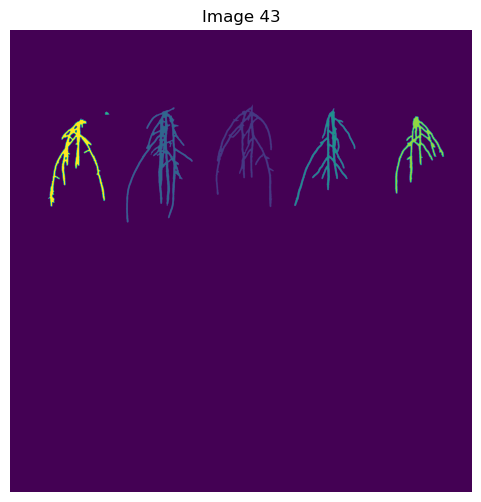

[[      0       0    2816    2816 7771554]
 [   1254     454     354     625   35132]
 [    708     472     405     701   44588]
 [   1733     476     371     596   27444]
 [    578     499      29      17     306]
 [   2347     526     299     471   22963]
 [    232     540     347     535   27869]]
Number of components detected: 104


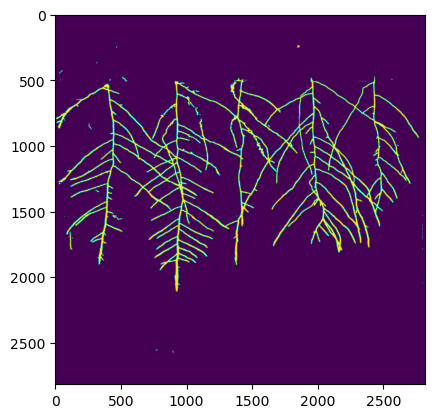

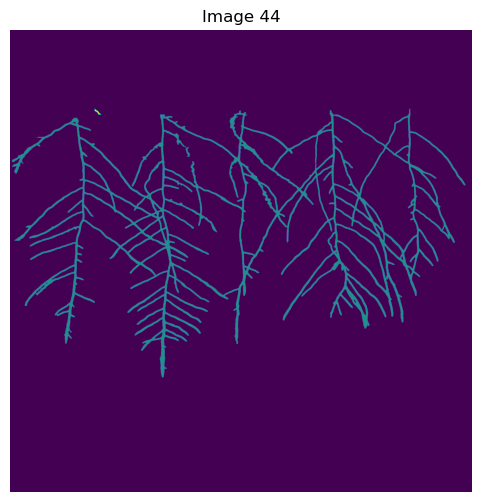

[[      0       0    2816    2816 7506783]
 [     12     479    2763    1639  422658]
 [    516     480      40      36     415]]
Number of components detected: 59


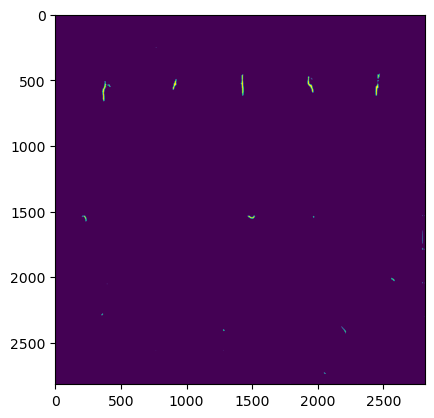

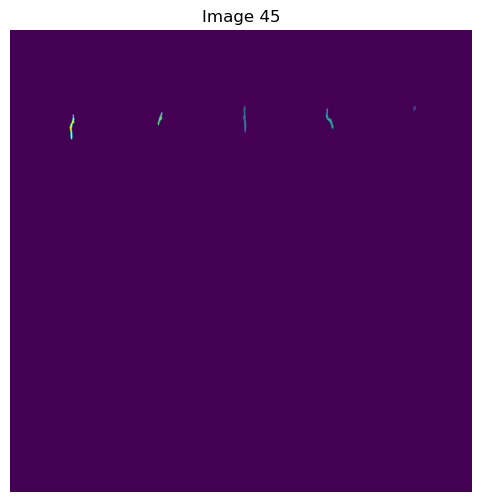

[[      0       0    2816    2816 7923759]
 [   2458     457      18      38     377]
 [   1419     465      21     160    1676]
 [   1925     478      47     123    1484]
 [    900     499      28      82     906]
 [    364     516      30     151    1654]]
Number of components detected: 121


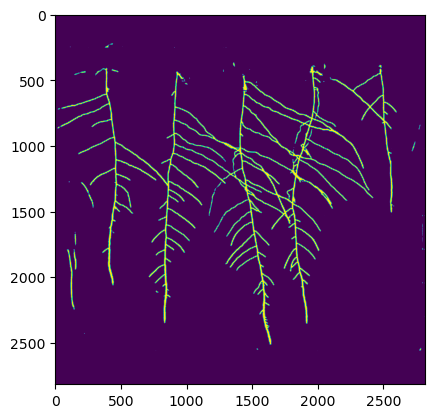

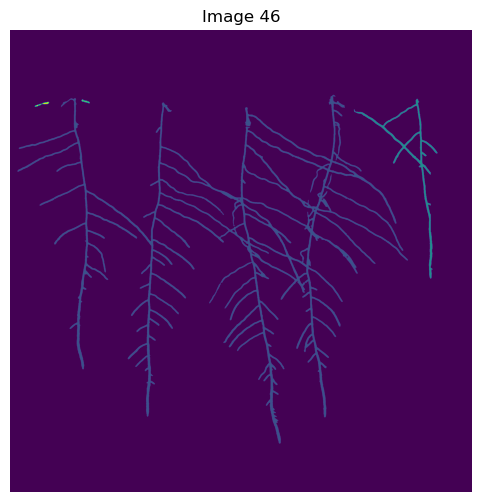

[[      0       0    2816    2816 7602902]
 [     46     395    2380    2126  301164]
 [   2097     419     508    1096   24762]
 [    436     423      50      23     440]
 [    152     439      86      29     588]]
Number of components detected: 39


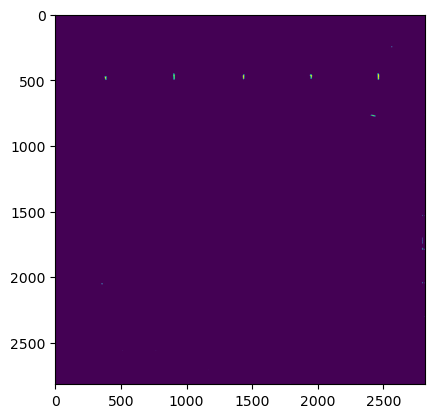

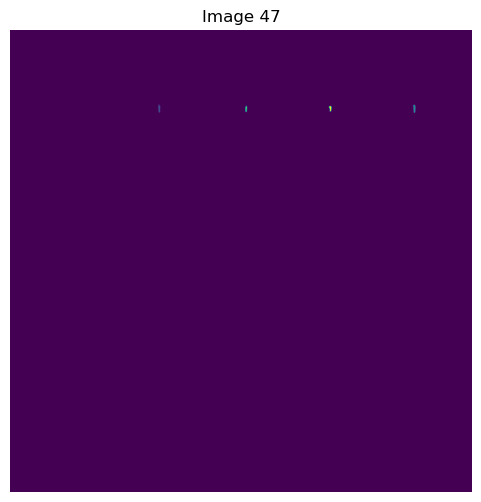

[[      0       0    2816    2816 7928309]
 [    904     453      13      50     424]
 [   2457     456      14      49     471]
 [   1434     462      11      38     315]
 [   1944     463      16      34     337]]
Number of components detected: 87


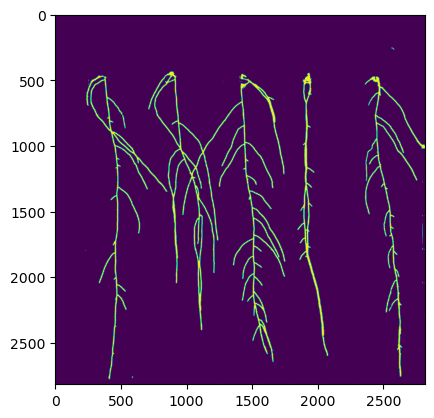

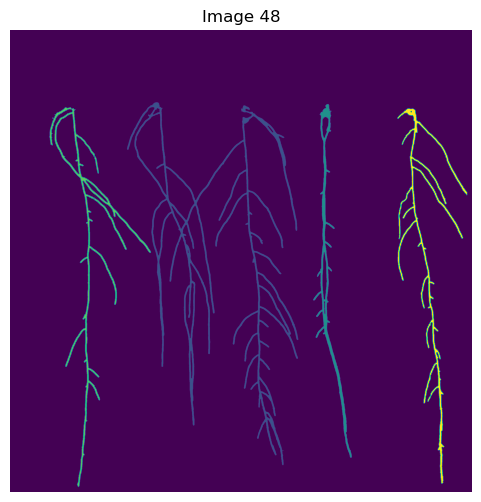

[[      0       0    2816    2816 7602743]
 [    714     441    1043    2212  166636]
 [   1848     452     235    2154   43403]
 [    241     472     618    2313   57578]
 [   2362     478     424    2287   59496]]
Number of components detected: 63


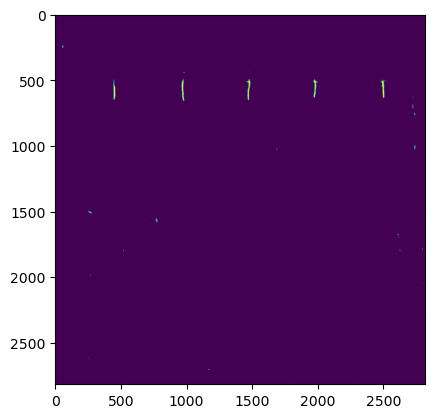

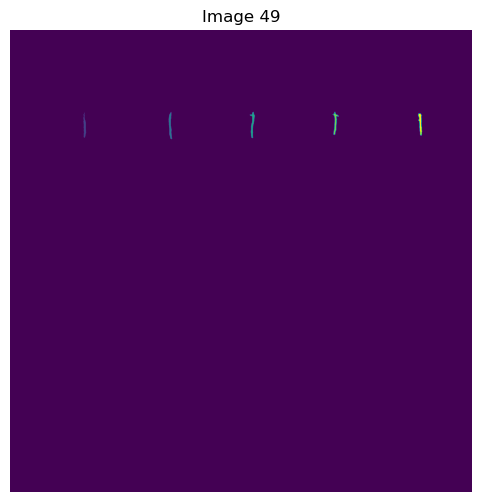

[[      0       0    2816    2816 7921477]
 [    448     499      16     157    1456]
 [    967     499      21     166    1775]
 [   1462     499      31     159    1795]
 [   1966     498      38     141    1608]
 [   2487     507      24     136    1745]]
Number of components detected: 148


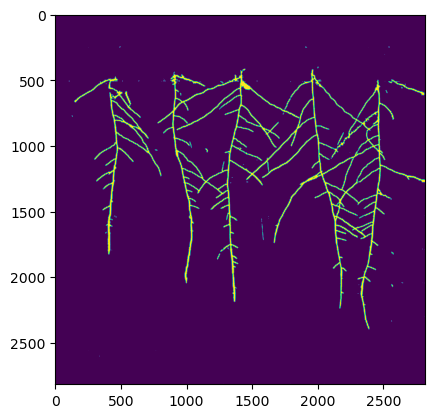

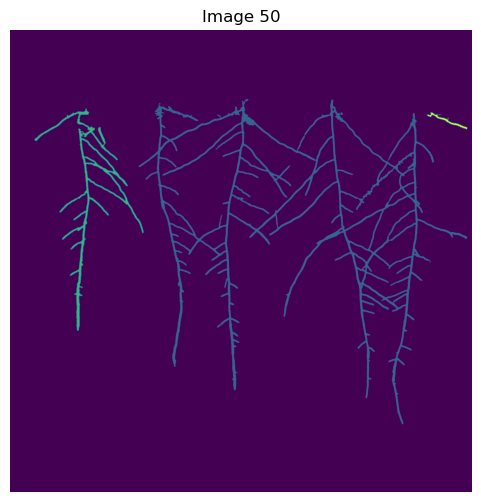

[[      0       0    2816    2816 7623343]
 [    784     421    2002    1982  253382]
 [    150     479     664    1354   50147]
 [   2541     502     245     103    2984]]
Number of components detected: 24


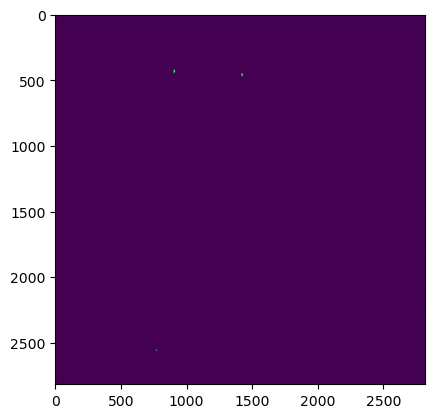

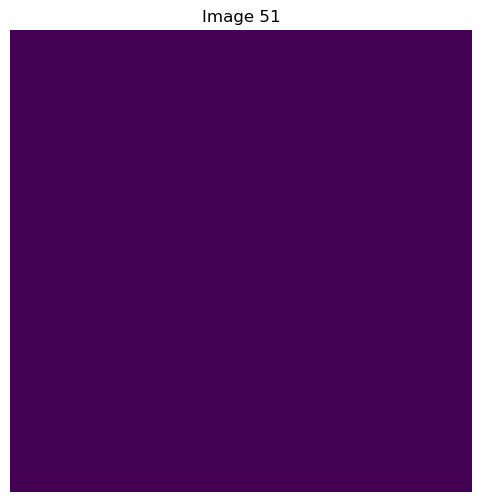

[[      0       0    2816    2816 7929856]]
Number of components detected: 175


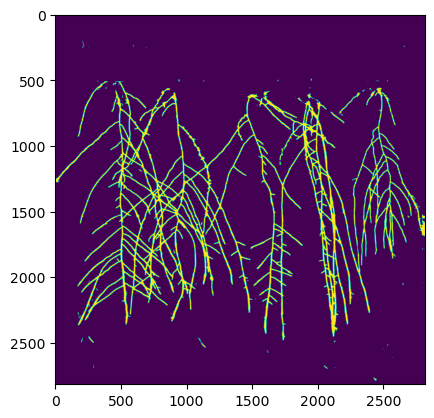

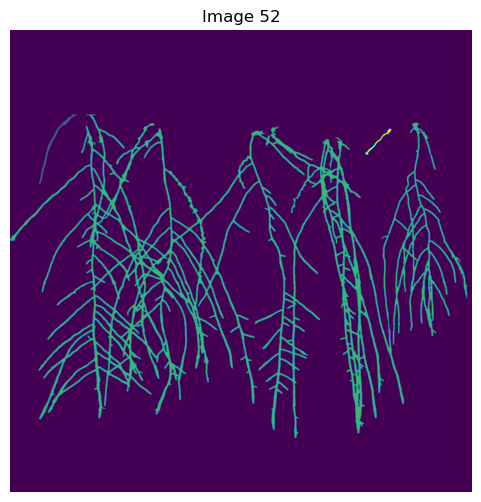

[[      0       0    2816    2816 7270808]
 [    177     515     230     423    5259]
 [      0     514    2786    1973  651608]
 [   2166     599     161     162    2181]]
Number of components detected: 49


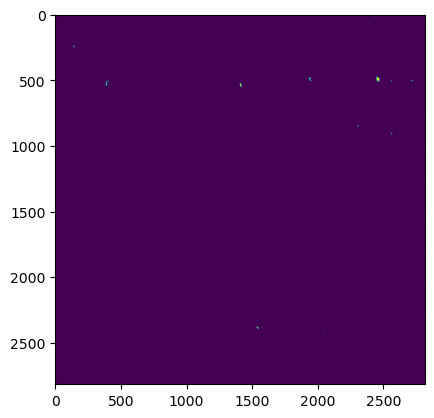

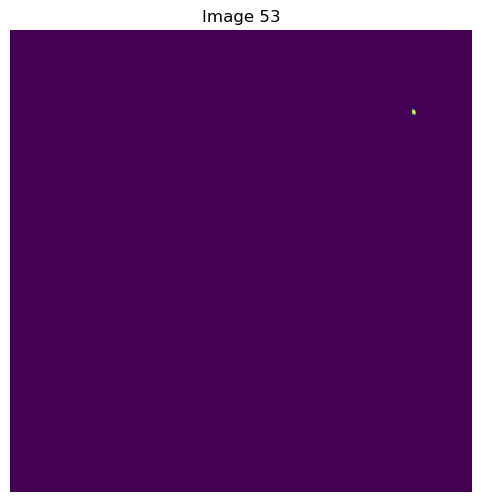

[[      0       0    2816    2816 7929238]
 [   2448     478      28      38     618]]
Number of components detected: 131


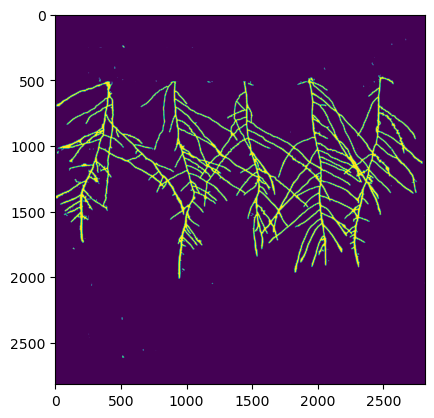

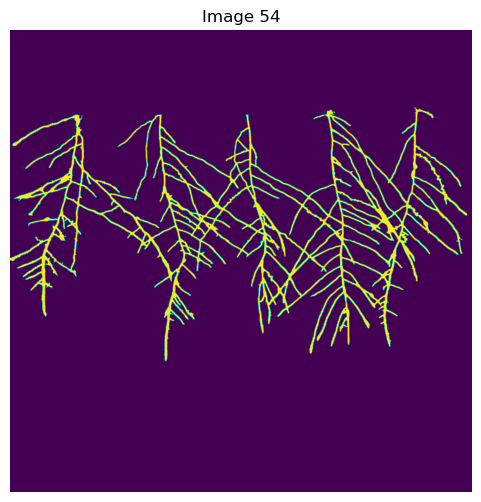

[[      0       0    2816    2816 7431795]
 [      0     470    2786    1549  498061]]
Number of components detected: 47


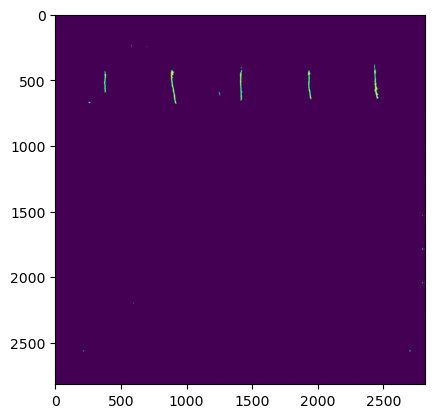

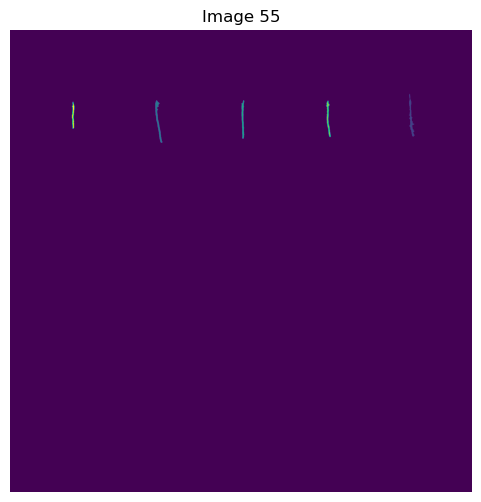

[[      0       0    2816    2816 7918296]
 [   2431     389      35     261    2833]
 [    886     428      42     259    2878]
 [   1412     428      15     234    2210]
 [   1926     431      29     221    2198]
 [    378     436      15     165    1441]]
Number of components detected: 113


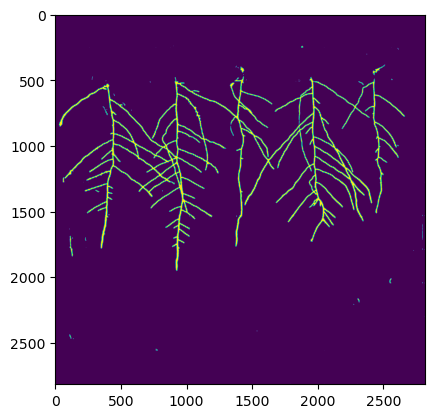

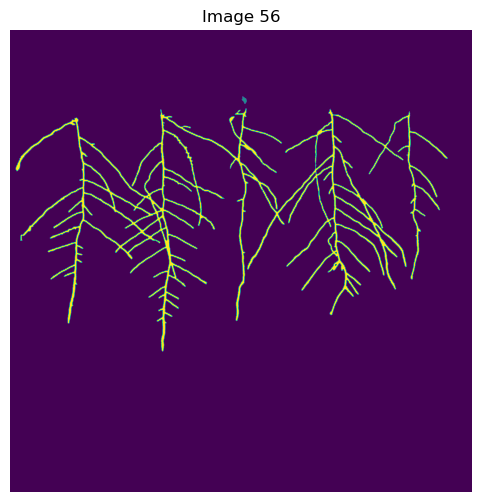

[[      0       0    2816    2816 7645271]
 [   1413     405      31      45     739]
 [     35     479    2632    1480  283846]]
Number of components detected: 59


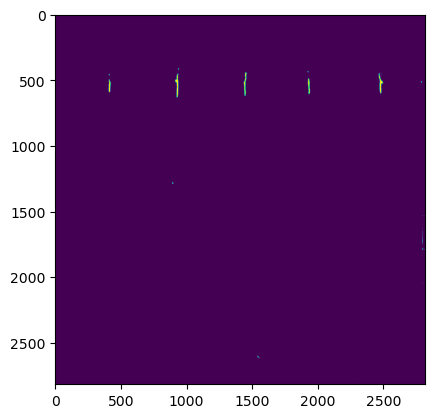

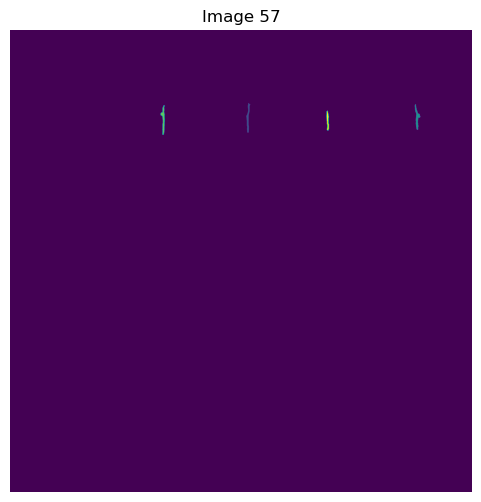

[[      0       0    2816    2816 7922860]
 [   1441     446      23     180    1778]
 [   2468     451      33     157    1856]
 [    918     458      26     181    2099]
 [   1929     492      15     121    1263]]
Number of components detected: 77


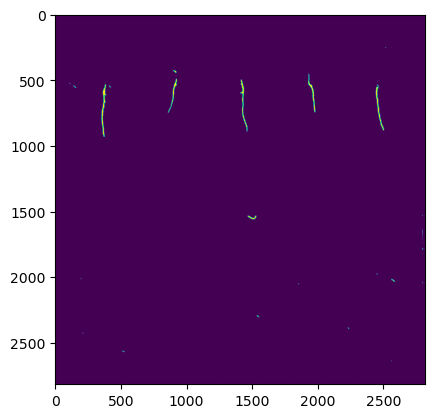

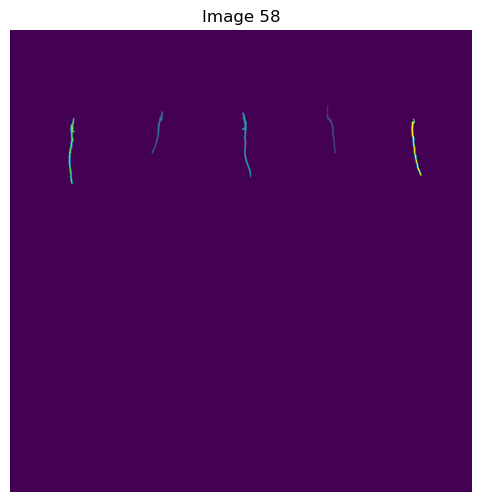

[[      0       0    2816    2816 7912741]
 [   1930     458      56     294    2849]
 [    864     496      68     259    2281]
 [   1414     502      55     398    3816]
 [    358     534      36     405    4580]
 [   2446     540      62     349    3589]]
Number of components detected: 114


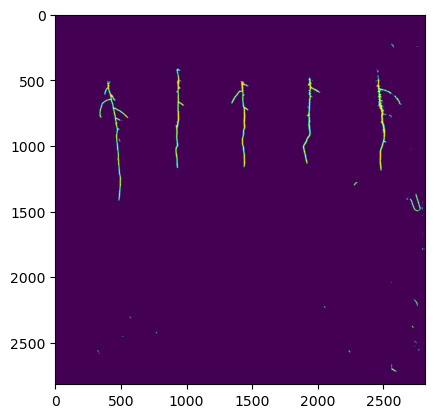

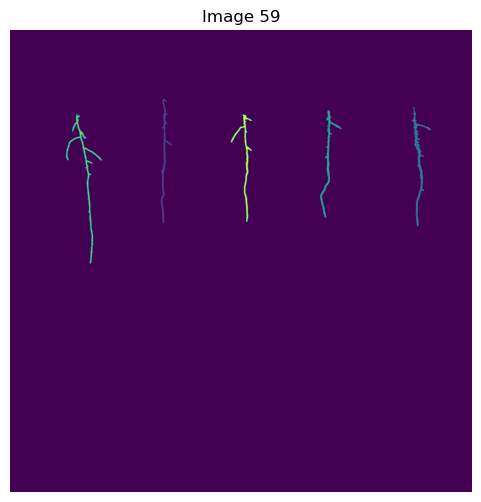

[[      0       0    2816    2816 7878549]
 [    919     418      67     759    8979]
 [   2449     468     115     728   11366]
 [   1890     490     132     654    8898]
 [    342     516     219     907   12964]
 [   1346     516     130     653    9100]]
Number of components detected: 132


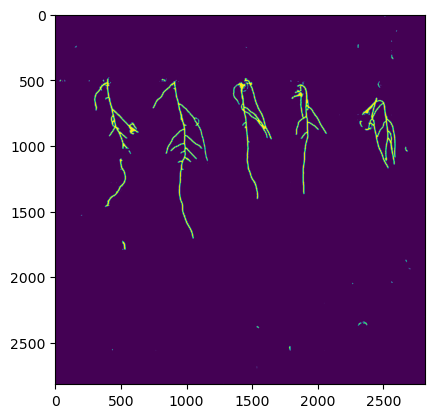

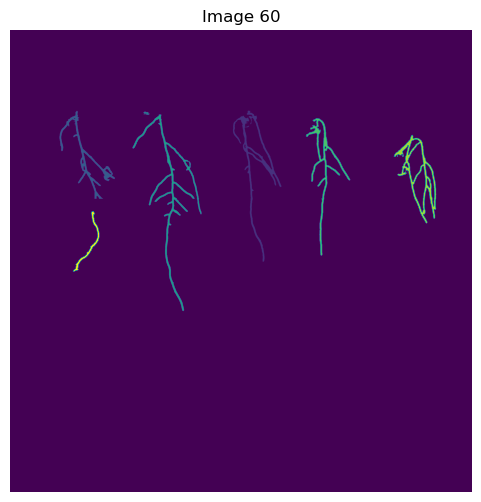

[[      0       0    2816    2816 7811738]
 [   1359     491     295     921   24356]
 [    302     493     337     536   17658]
 [    814     497      36      19     390]
 [    748     516     419    1196   27666]
 [   1804     538     269     836   19503]
 [   2340     640     257     538   23726]
 [    384    1105     160     367    4819]]
Number of components detected: 94


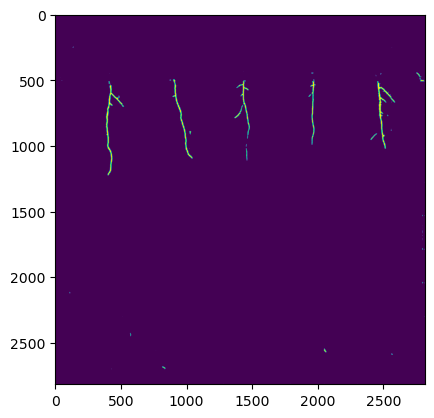

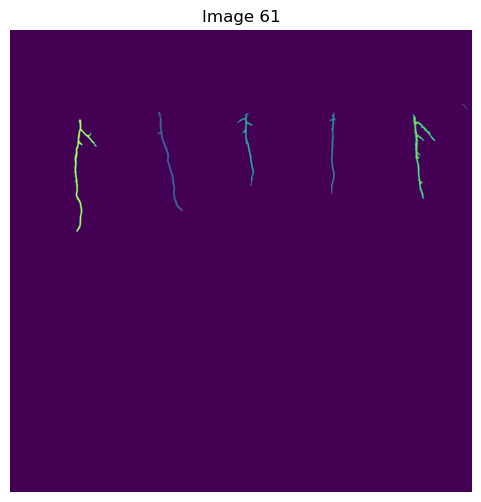

[[      0       0    2816    2816 7896553]
 [   2754     450      32      36     314]
 [    899     500     153     603    6537]
 [   1947     501      39     497    4303]
 [   1385     508     101     443    4515]
 [   2456     516     136     512    8414]
 [    391     540     137     691    9220]]
Number of components detected: 68


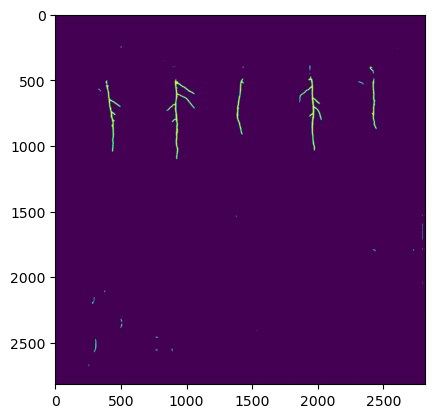

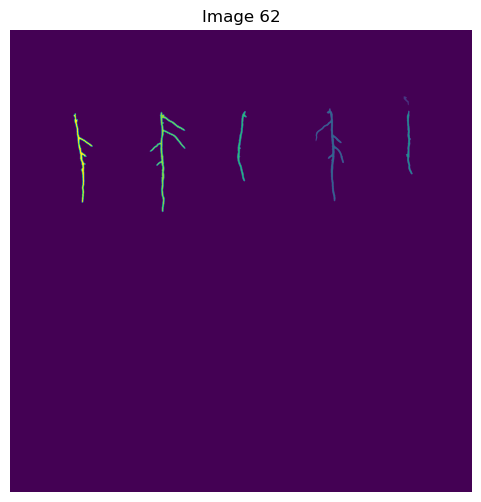

[[      0       0    2816    2816 7892043]
 [   2399     405      32      53     567]
 [   1864     476     171     567    9931]
 [   2414     492      39     387    4064]
 [   1384     495      58     426    4793]
 [    853     500     215     609   11140]
 [    388     508     115     544    7318]]
Number of components detected: 101


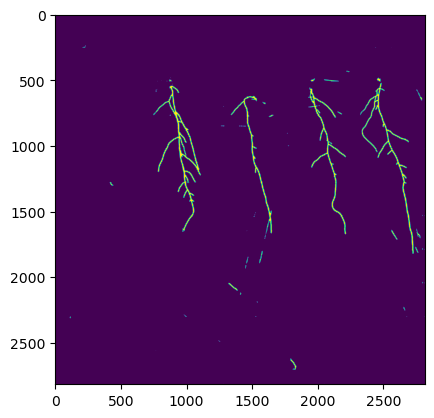

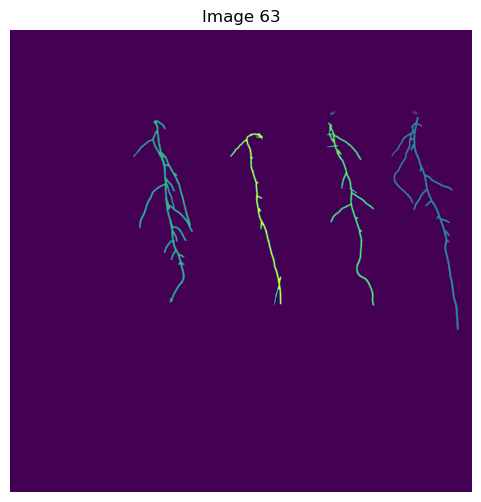

[[      0       0    2816    2816 7837278]
 [   2455     489      28      27     478]
 [   1951     495      31      21     331]
 [   2326     528     408    1300   25186]
 [    752     550     362    1110   31925]
 [   1931     562     288    1118   19812]
 [   1342     628     313    1048   14846]]
Number of components detected: 59


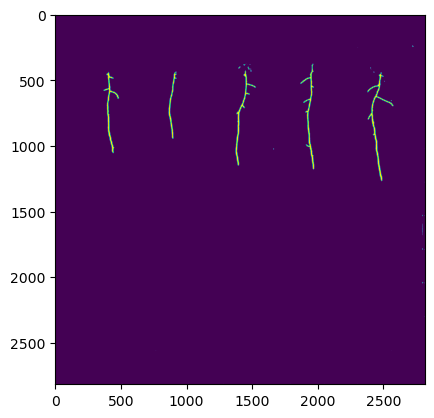

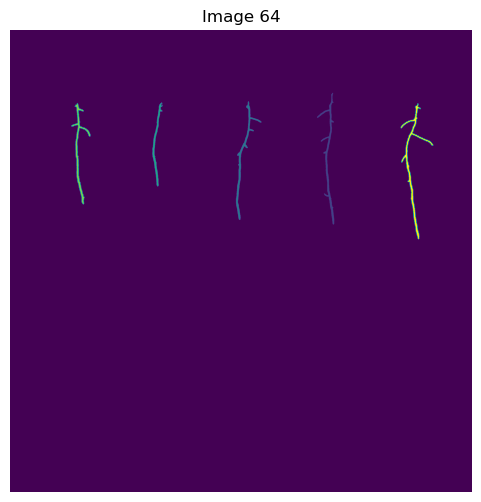

[[      0       0    2816    2816 7882904]
 [   1872     383     105     803   10472]
 [   1377     435     156     722    9385]
 [    868     442      63     511    5610]
 [    374     445     116     617    8953]
 [   2382     447     198     828   12532]]
Number of components detected: 119


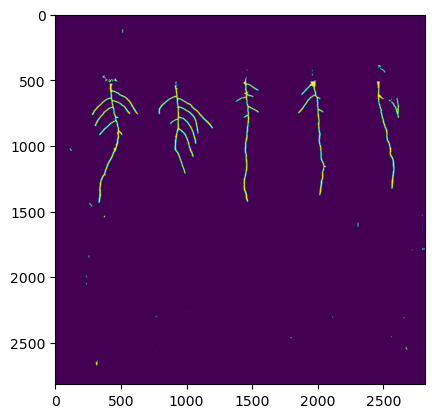

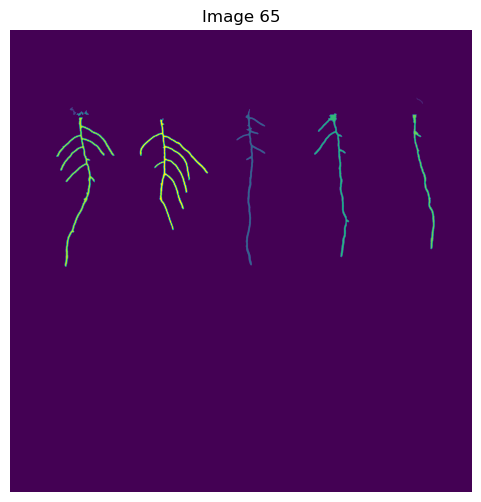

[[      0       0    2816    2816 7849503]
 [   2477     411      40      40     306]
 [    364     471      39      45     526]
 [   1381     482     175     952   13487]
 [    454     490      26      26     305]
 [    402     497      45      28     402]
 [   1854     509     212     875   13482]
 [   2454     516     135     819    9666]
 [    282     533     354     910   21272]
 [    792     538     415     681   20907]]
Number of components detected: 80


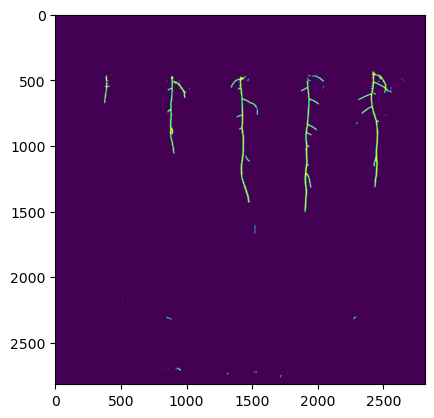

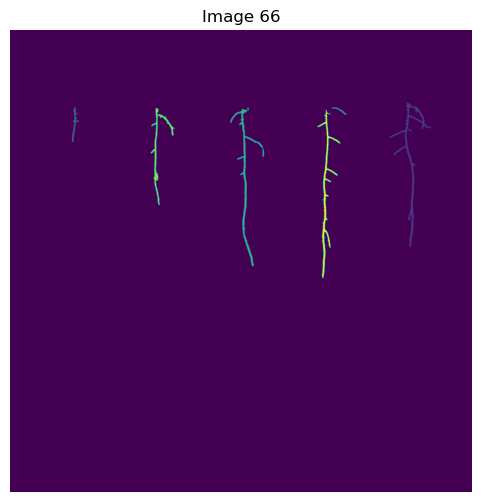

[[      0       0    2816    2816 7870807]
 [   2310     441     254     882   16695]
 [    377     469      42     214    2296]
 [   1958     471      94      45     816]
 [   1343     474     206     966   14580]
 [    858     476     147     591    9350]
 [   1875     487     139    1026   15312]]
Number of components detected: 73


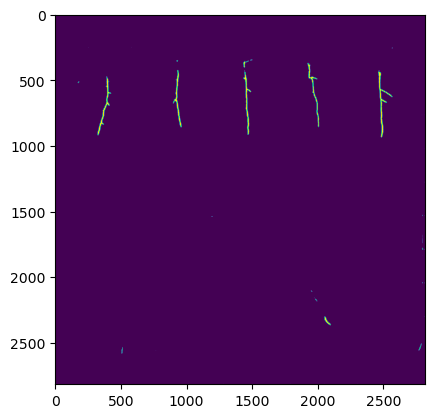

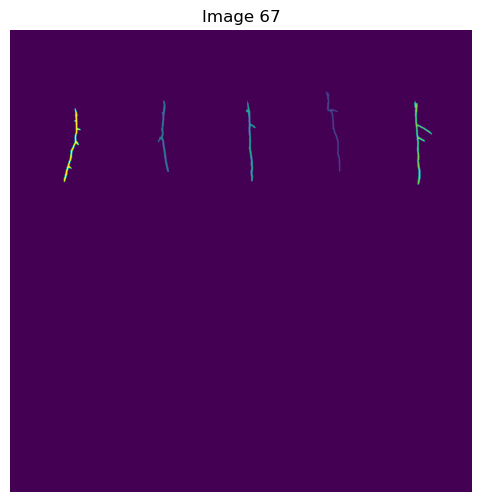

[[      0       0    2816    2816 7901789]
 [   1925     376      88     488    5048]
 [    902     430      66     435    4954]
 [   1438     432      58     490    5444]
 [   2464     434     108     509    7002]
 [    328     476     103     450    5619]]
Number of components detected: 77


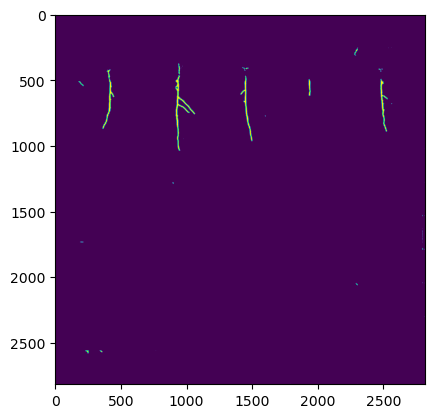

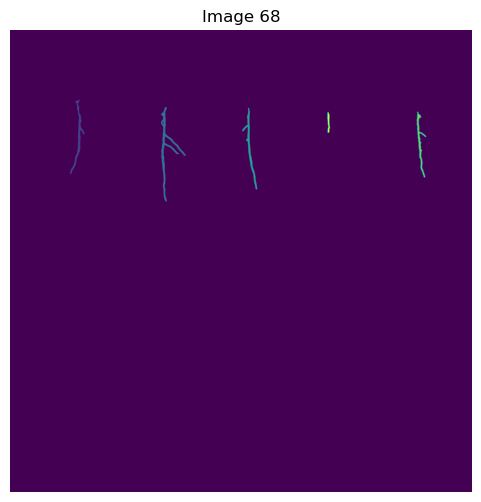

[[      0       0    2816    2816 7901404]
 [    366     425      88     453    5839]
 [    921     470     149     575   10076]
 [   1415     474      91     498    5995]
 [   2480     498      57     401    5189]
 [   1934     500      16     127    1353]]
Number of components detected: 95


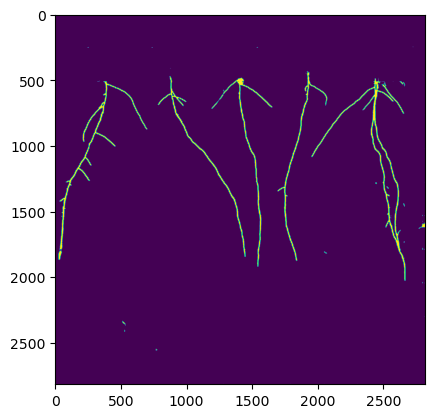

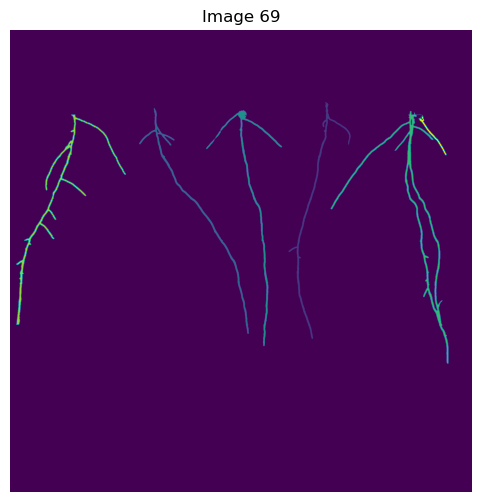

[[      0       0    2816    2816 7797734]
 [   1698     438     378    1445   18836]
 [    787     476     668    1376   19573]
 [   1196     489     462    1438   21222]
 [   1955     494     717    1539   41000]
 [     38     516     668    1281   28661]
 [   2491     519     170     244    2830]]
Number of components detected: 85


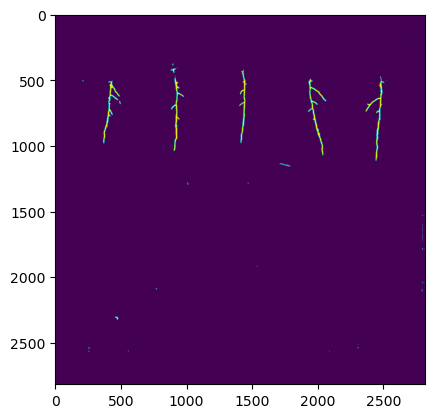

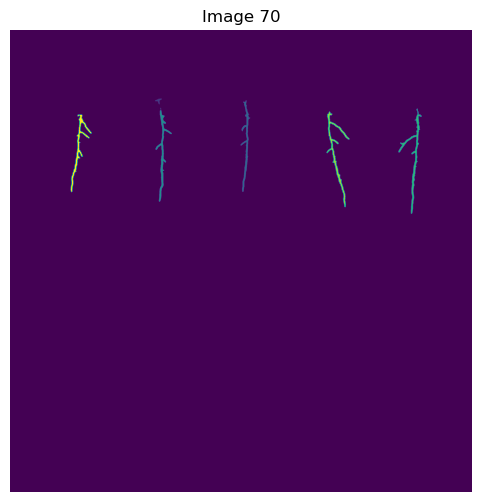

[[      0       0    2816    2816 7889000]
 [    883     418      43      36     550]
 [   1405     427      59     559    6723]
 [    888     474      98     572    7631]
 [   2368     479     142     641    9244]
 [   1930     497     139     583    9073]
 [    370     516     128     472    7635]]
Number of components detected: 82


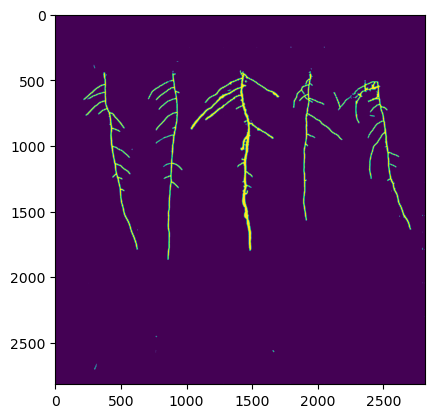

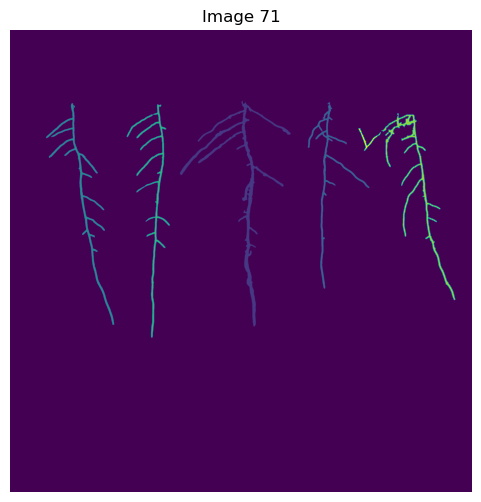

[[      0       0    2816    2816 7769322]
 [   1036     432     674    1375   53589]
 [   1816     440     375    1136   21471]
 [    220     447     416    1349   26948]
 [    712     452     262    1423   25668]
 [   2265     507     449    1139   30708]
 [   2124     599     136     137    2150]]
Number of components detected: 76


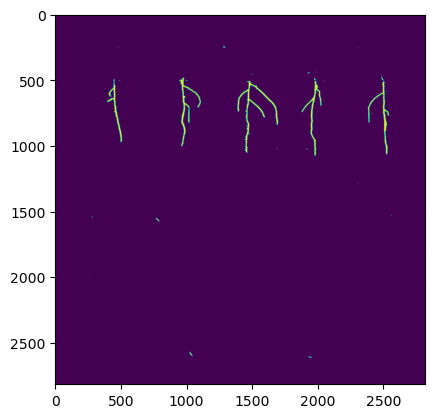

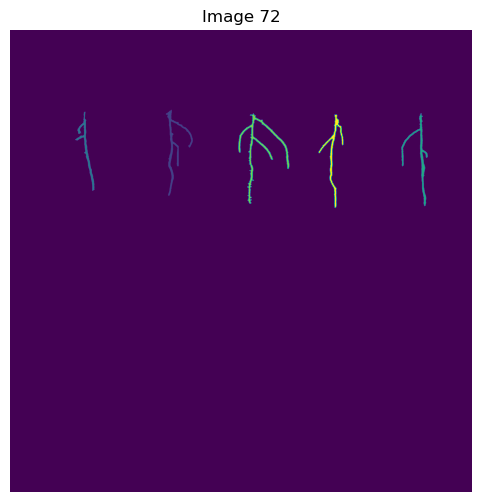

[[      0       0    2816    2816 7876176]
 [    950     485     164     525   10924]
 [    398     498     117     482    7252]
 [   2386     507     160     566   10213]
 [   1392     508     310     550   15532]
 [   1881     516     151     568    9759]]
Number of components detected: 66


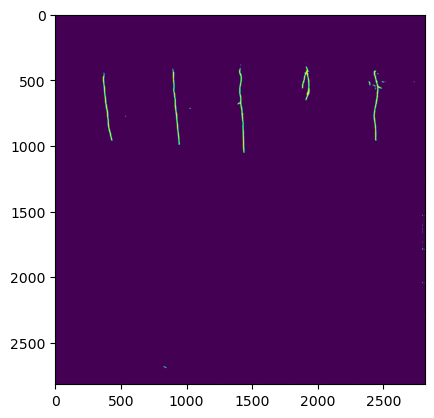

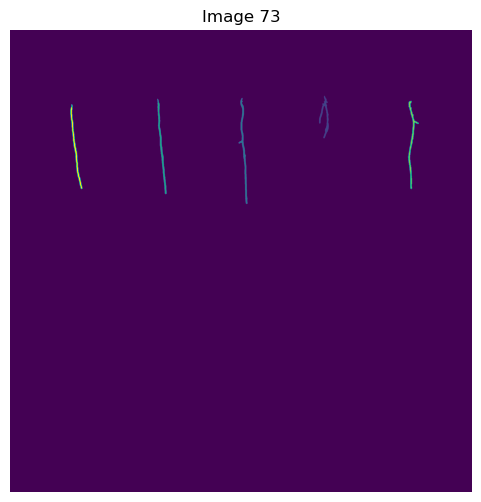

[[      0       0    2816    2816 7902149]
 [   1884     400      59     260    4228]
 [   1393     414      54     646    6737]
 [    898     420      56     580    5741]
 [   2426     432      66     537    5741]
 [    368     452      73     517    5260]]
Number of components detected: 64


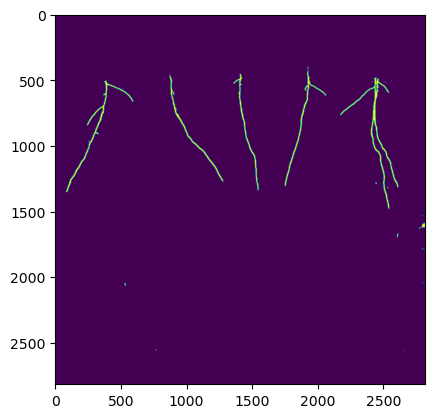

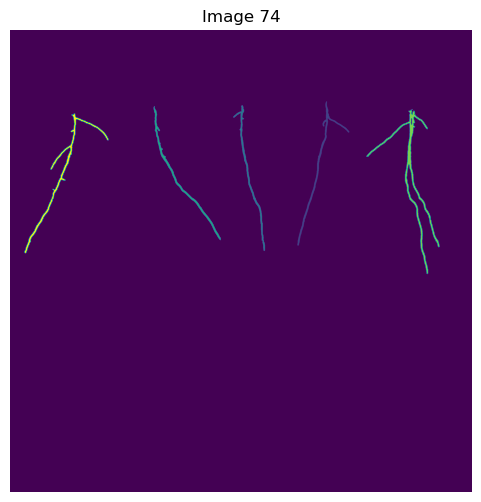

[[      0       0    2816    2816 7859390]
 [   1752     434     316     880   11366]
 [   1361     458     193     888    9933]
 [    876     464     408     817   10502]
 [   2172     482     446    1005   23874]
 [     88     508     513     852   14791]]
Number of components detected: 112


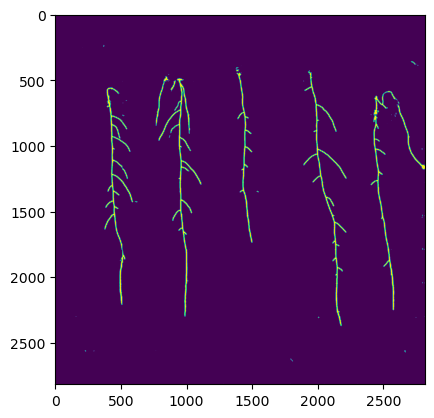

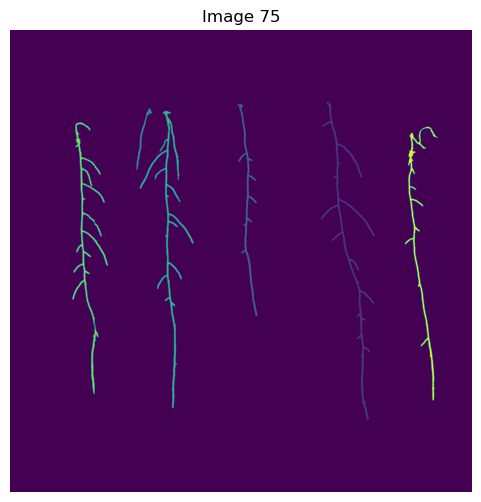

[[      0       0    2816    2816 7789933]
 [   1894     434     330    1944   31598]
 [   1387     451     120    1293   15846]
 [    772     476      95     380    3861]
 [    792     493     327    1812   34216]
 [    380     563     218    1655   30675]
 [   2407     590     201    1668   23727]]
Number of components detected: 78


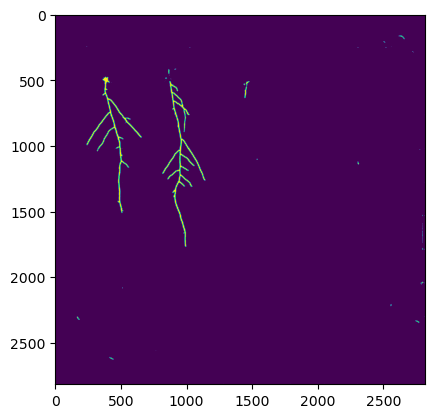

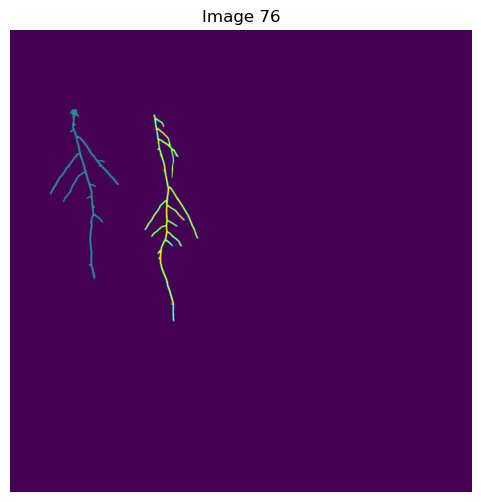

[[      0       0    2816    2816 7877958]
 [    244     482     420    1036   23008]
 [    820     516     328    1260   28890]]
Number of components detected: 86


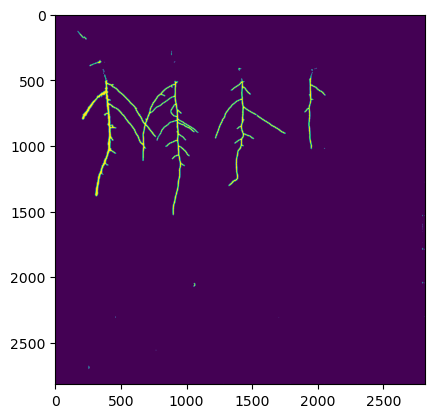

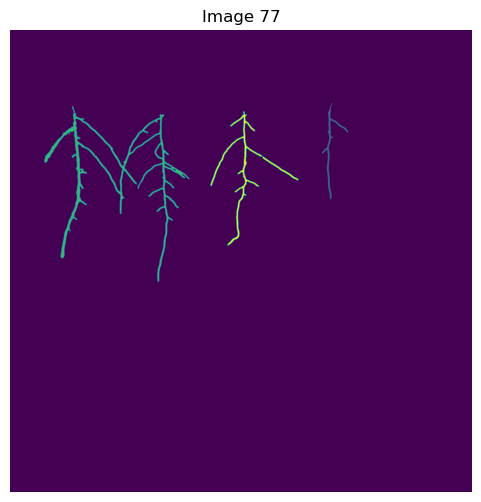

[[      0       0    2816    2816 7838655]
 [   1902     445     161     588    7568]
 [    209     465     886    1070   63649]
 [   1222     495     537     818   19984]]
Number of components detected: 71


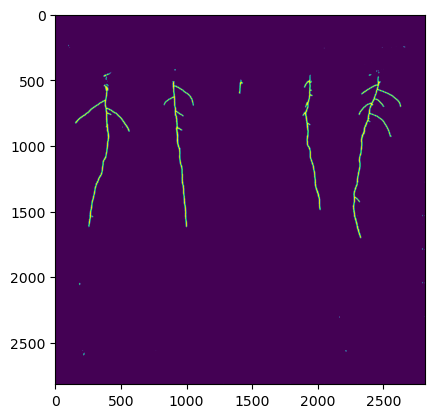

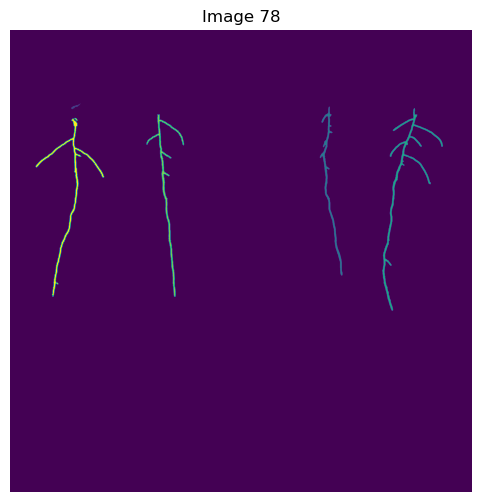

[[      0       0    2816    2816 7861714]
 [    373     448      57      34     497]
 [   1889     468     137    1028   12564]
 [   2270     476     368    1234   21614]
 [    832     515     228    1111   15608]
 [    157     536     416    1090   17859]]
Number of components detected: 73


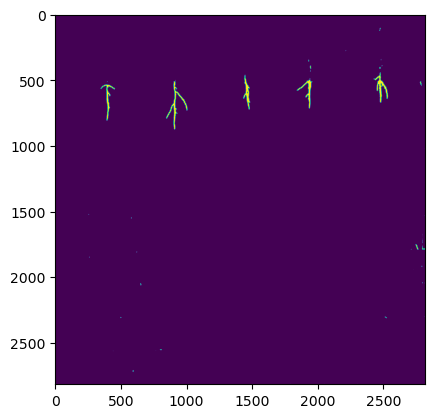

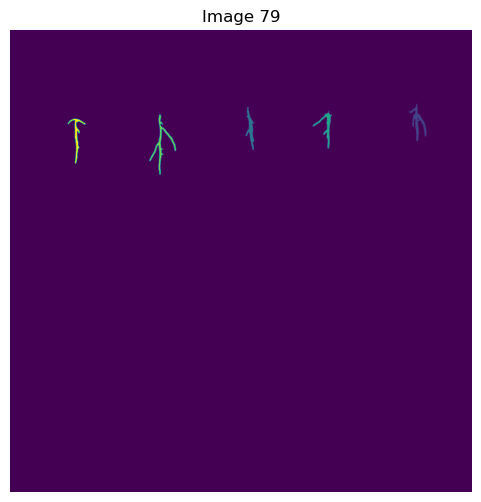

[[      0       0    2816    2816 7901970]
 [   2428     448     110     231    6294]
 [   1436     466      52     264    4730]
 [   1845     492     116     231    4834]
 [    850     516     162     366    7388]
 [    352     540     108     274    4640]]
Number of components detected: 105


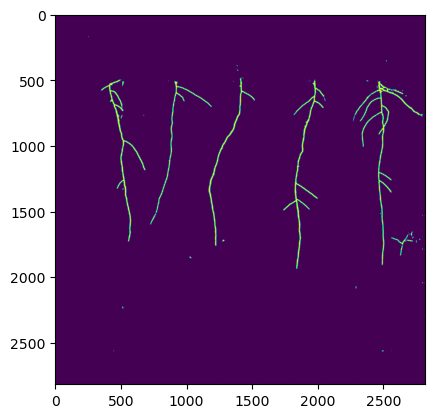

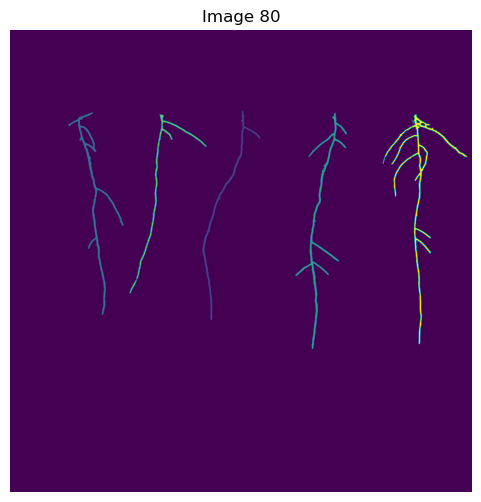

[[      0       0    2816    2816 7827634]
 [   1172     484     354    1285   15462]
 [    354     503     338    1233   20676]
 [   1740     502     312    1442   23302]
 [    729     515     469    1090   12971]
 [   2273     516     513    1399   29811]]
Number of components detected: 77


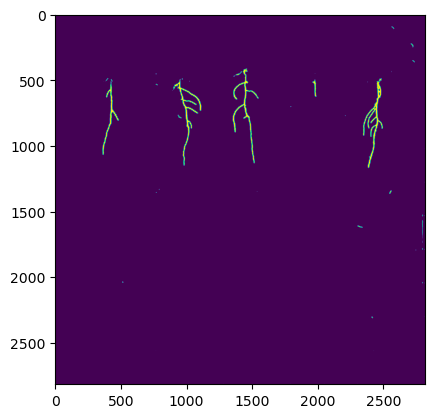

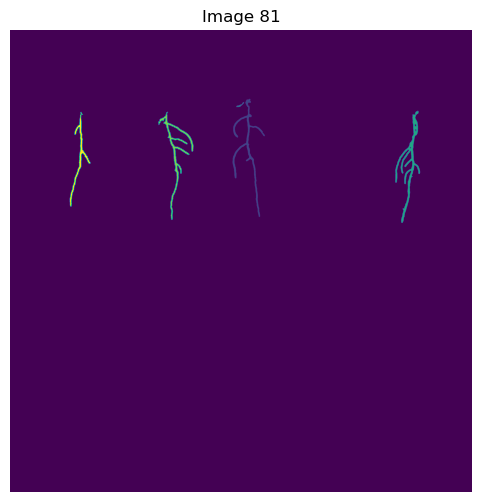

[[      0       0    2816    2816 7878690]
 [   1357     420     197     720   13882]
 [   1377     440      49      31     347]
 [   2349     492     150     684   15926]
 [    904     498     214     659   13160]
 [    364     500     126     576    7851]]
Number of components detected: 108


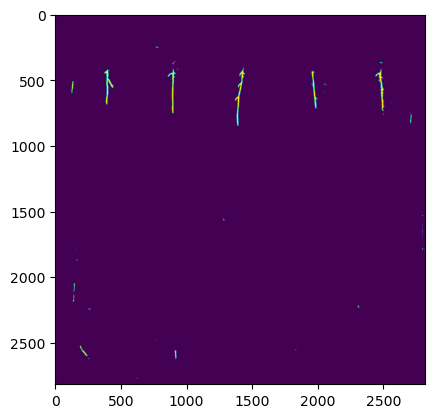

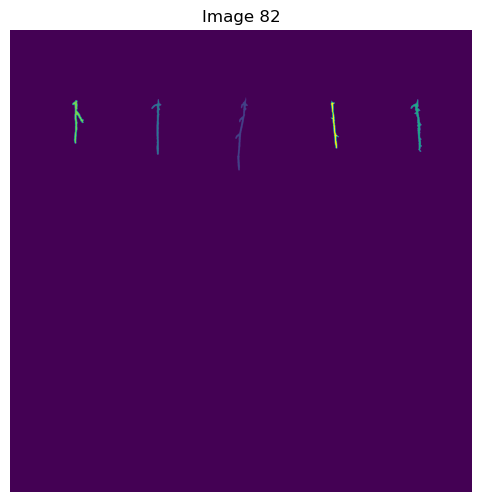

[[      0       0    2816    2816 7906925]
 [   1374     411      76     445    5956]
 [    862     422      60     338    4280]
 [   2442     422      68     320    4808]
 [    380     428      70     264    4467]
 [   1956     432      48     290    3420]]
Number of components detected: 76


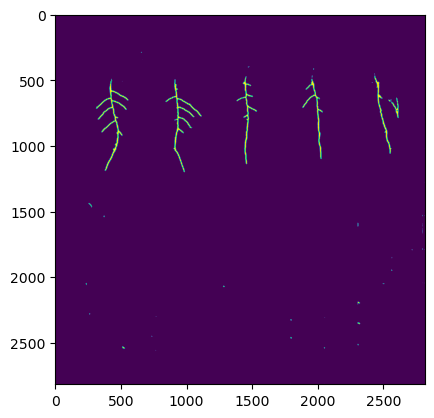

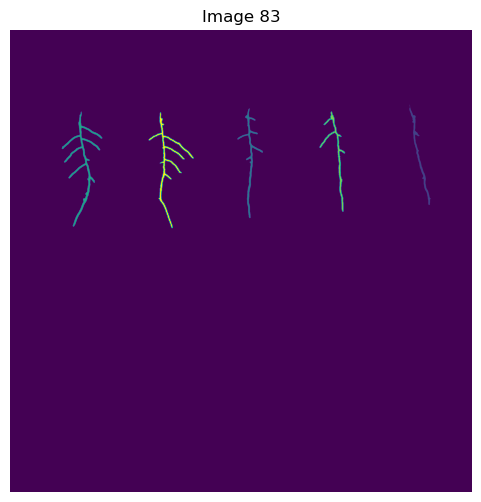

[[      0       0    2816    2816 7875961]
 [   2434     455     130     612    7102]
 [   1386     478     154     668    9307]
 [    316     496     246     702   15091]
 [   1887     497     155     610    8693]
 [    846     502     274     705   13702]]
Number of components detected: 74


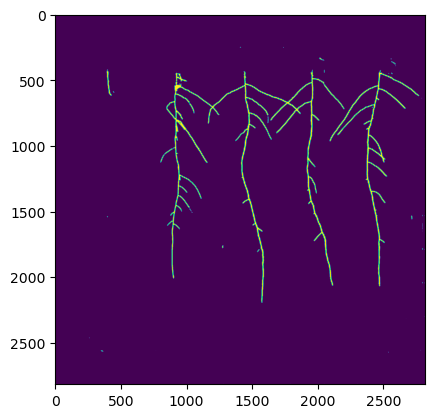

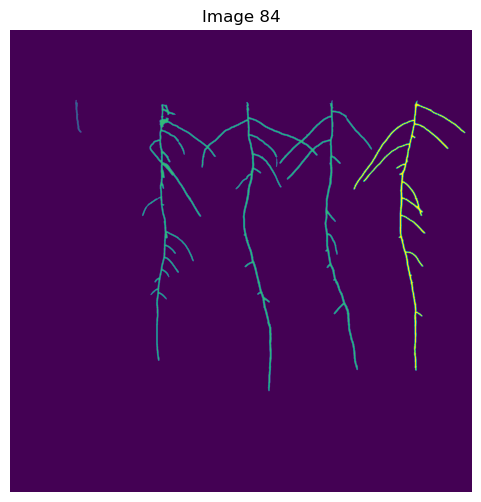

[[      0       0    2816    2816 7786531]
 [    398     426      38     199    1989]
 [    806     428    1400    1773  101965]
 [   2094     430     681    1646   39371]]
Number of components detected: 75


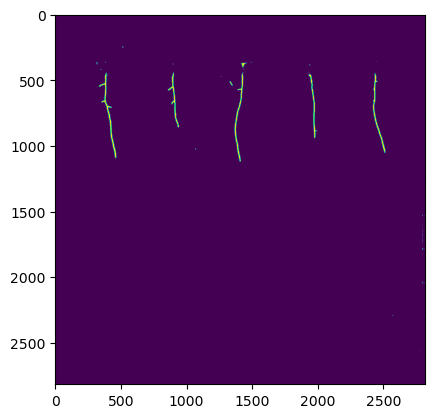

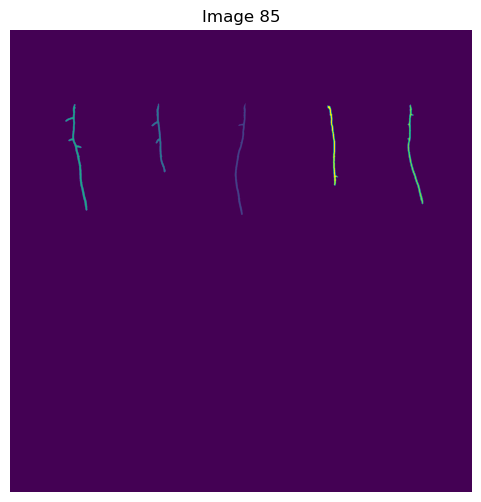

[[      0       0    2816    2816 7897970]
 [   1370     444      66     683    7267]
 [    863     449      85     418    4943]
 [    338     451     133     649    8141]
 [   2424     454      94     607    6436]
 [   1934     462      66     486    5099]]
Number of components detected: 58


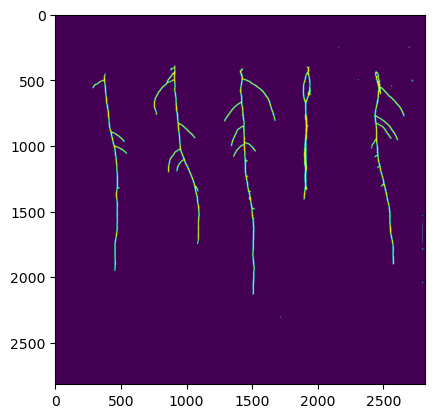

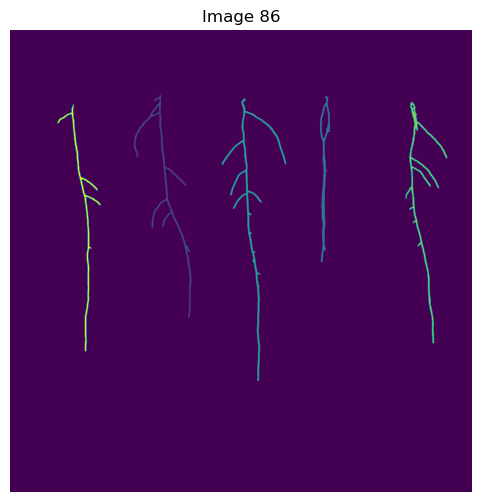

[[      0       0    2816    2816 7819078]
 [    755     397     351    1358   23009]
 [   1890     404      63    1012   16336]
 [   1290     417     393    1723   28349]
 [   2409     436     256    1474   24968]
 [    289     452     264    1507   18116]]
Number of components detected: 93


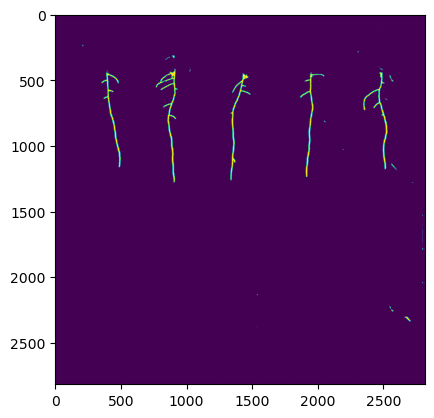

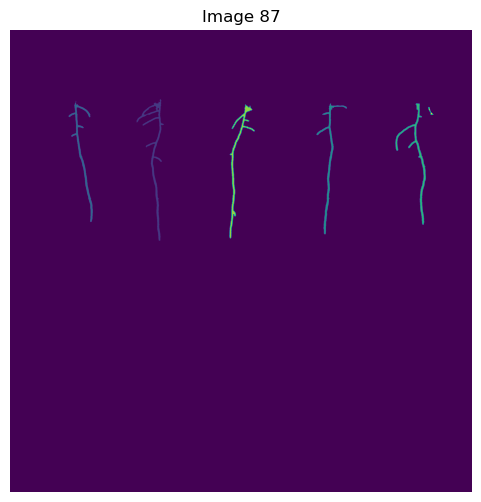

[[      0       0    2816    2816 7869531]
 [    772     421     165     863   14901]
 [    358     432     146     738   10419]
 [   1869     448     183     797   10808]
 [   2350     448     184     738   11720]
 [   1338     455     154     815   12165]
 [   2550     470      30      46     312]]
Number of components detected: 88


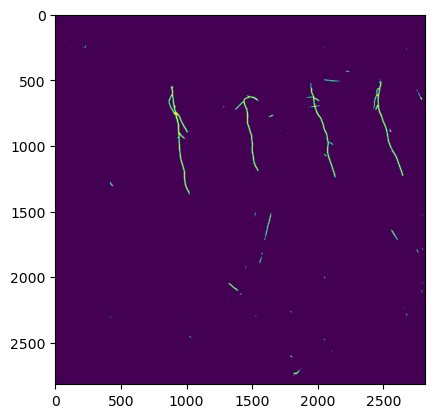

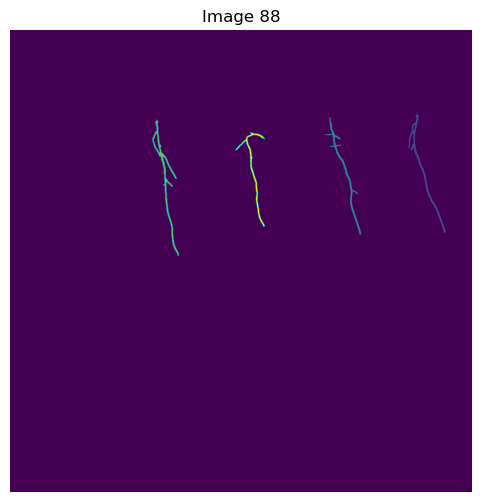

[[      0       0    2816    2816 7892443]
 [   2428     501     226     736    9091]
 [   1916     533     224     714    8308]
 [    868     544     162     834   12505]
 [   1374     624     180     575    7509]]
Number of components detected: 56


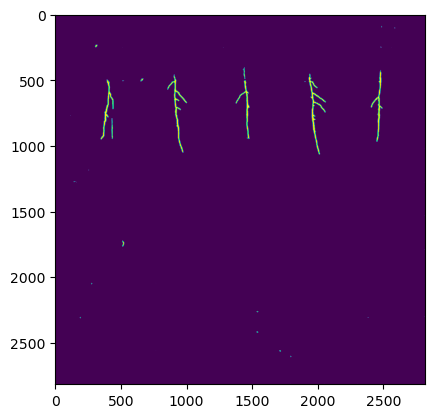

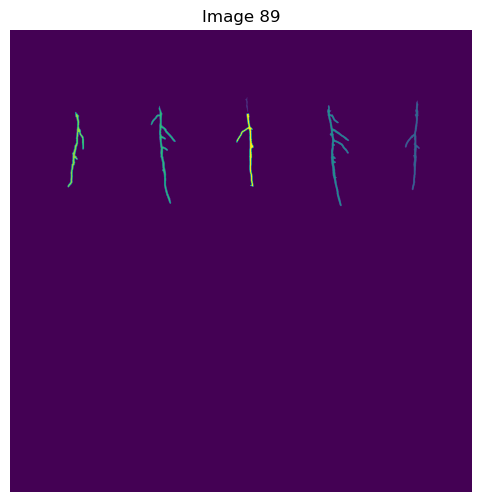

[[      0       0    2816    2816 7888526]
 [   1434     408      17      90     562]
 [   2408     430      89     545    7416]
 [   1934     458     132     615   10630]
 [    859     462     150     596    9291]
 [    352     500      98     458    6946]
 [   1380     507     106     448    6485]]
Number of components detected: 126


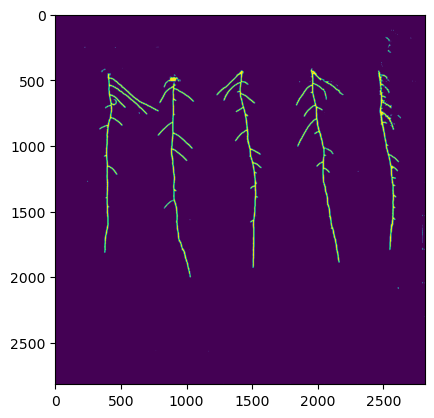

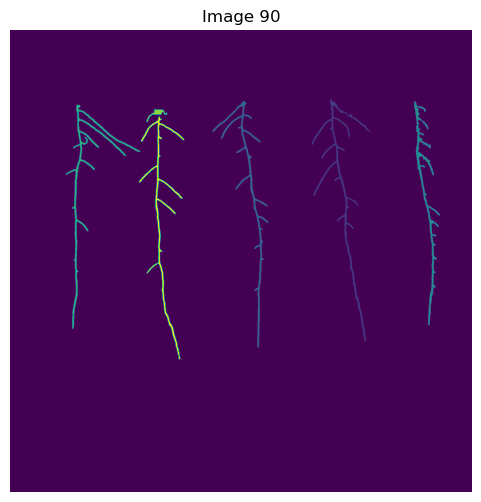

[[      0       0    2816    2816 7796464]
 [   1838     418     362    1477   28765]
 [   1233     431     343    1504   26520]
 [   2463     435     159    1366   23627]
 [    341     455     453    1366   27765]
 [    832     481     126      81    2437]
 [    786     524     276    1484   24278]]
Number of components detected: 66


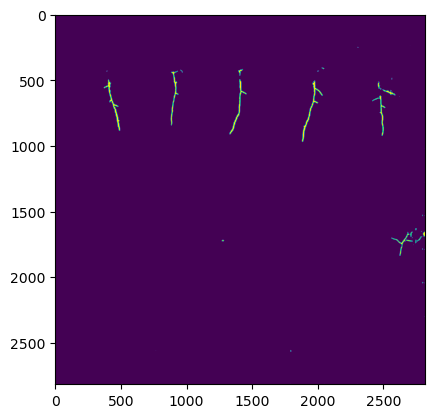

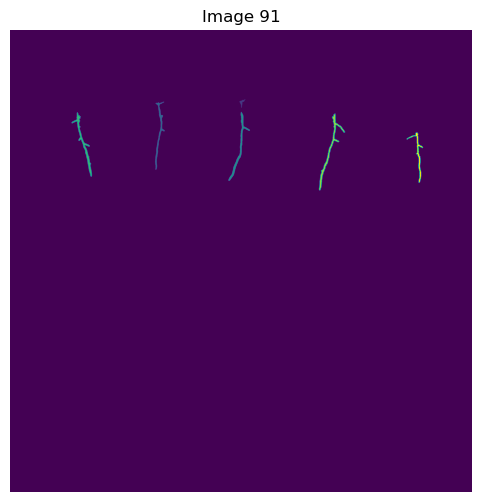

[[      0       0    2816    2816 7904386]
 [   1399     422      37      52     571]
 [    885     437      58     415    4173]
 [   1332     500     130     419    5093]
 [    376     502     123     391    5620]
 [   1884     509     158     468    6468]
 [   2418     623      99     308    3545]]
Number of components detected: 122


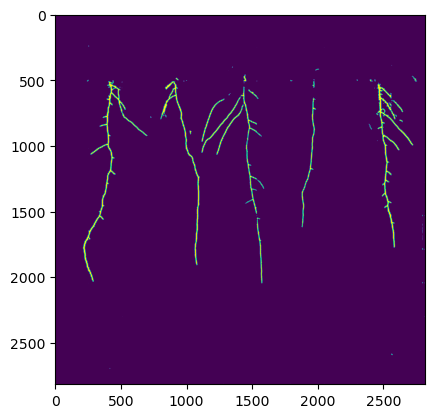

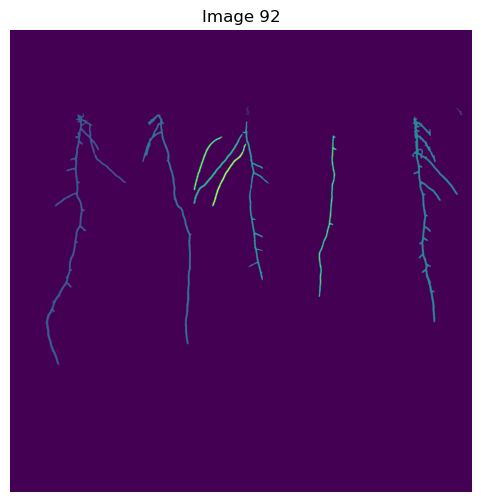

[[      0       0    2816    2816 7823038]
 [   1439     465      21      51     583]
 [   2721     476      38      40     343]
 [    218     510     488    1531   28489]
 [    807     515     299    1400   19452]
 [   2449     526     281    1255   26440]
 [   1418     558     159     968   10622]
 [   1118     633     300     426    4945]
 [   1882     640     108     986    8437]
 [   1120     648     173     328    3448]
 [   1232     693     206     381    4059]]
Number of components detected: 106


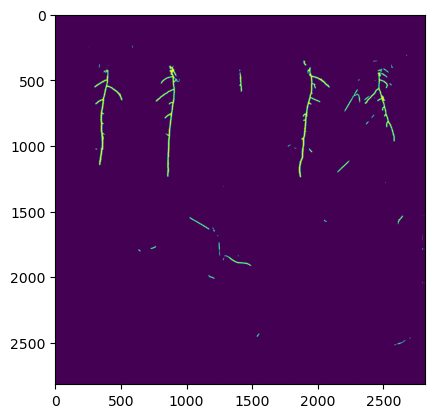

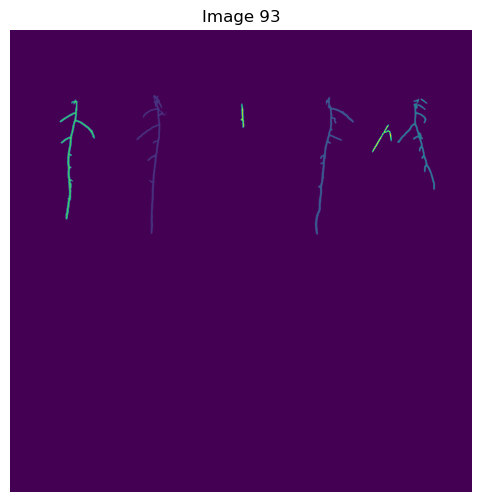

[[      0       0    2816    2816 7873771]
 [    772     397     182     846   14972]
 [   1859     407     237     840   13937]
 [   2361     418     229     556   10414]
 [   2503     419      40      30     289]
 [    303     423     213     732   13027]
 [   1407     448      21     148    1462]
 [   2207     575     119     171    1984]]
Number of components detected: 70


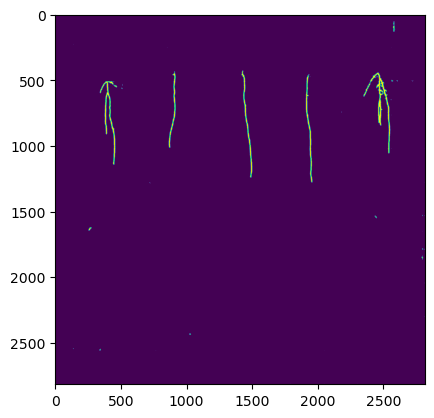

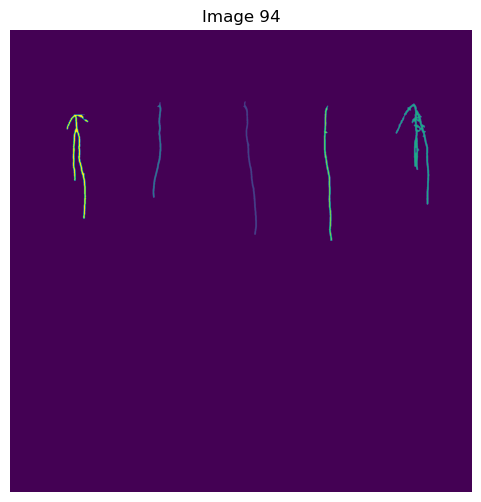

[[      0       0    2816    2816 7881538]
 [   1422     435      83     813    7964]
 [    870     440      52     582    5627]
 [   2351     448     204     616   15462]
 [   1914     460      50     824    8090]
 [    346     516     130     634   11175]]
Number of components detected: 94


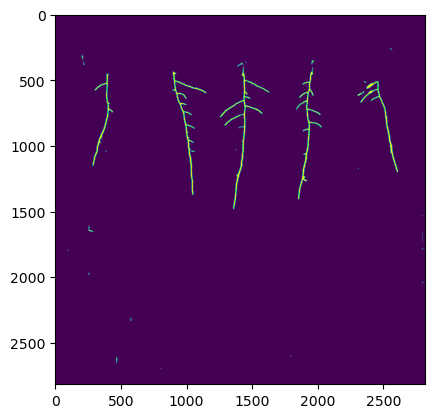

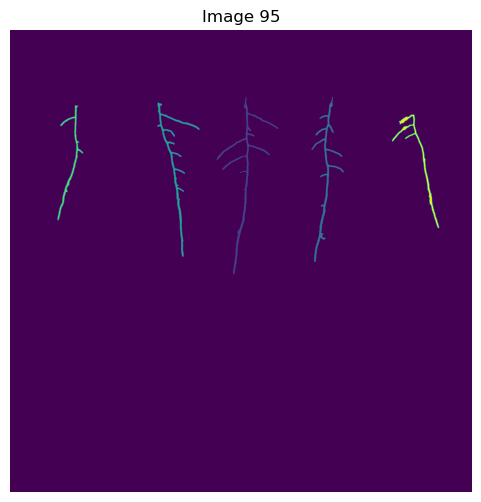

[[      0       0    2816    2816 7858058]
 [   1260     407     376    1082   19309]
 [   1838     407     197    1007   16006]
 [    898     441     257     941   15505]
 [    289     457     157     703    9234]
 [   2328     516     288     691   11744]]
Number of components detected: 80


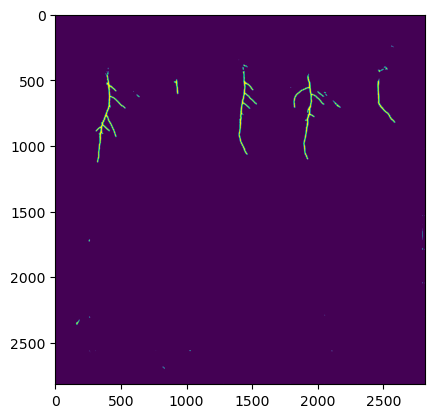

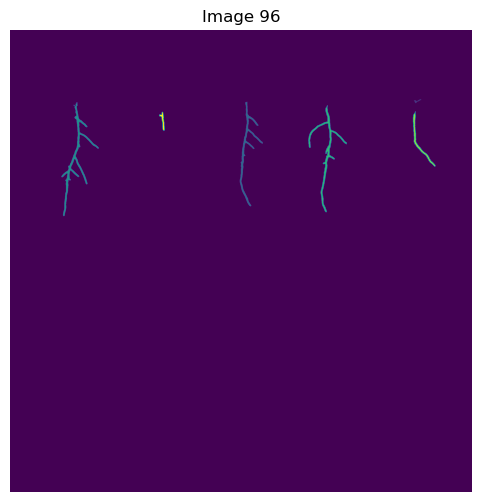

[[      0       0    2816    2816 7890062]
 [   2462     421      45      25     338]
 [   1401     436     139     638    9622]
 [    314     440     227     694   13197]
 [   1819     459     233     651   11168]
 [   2457     496     136     336    4141]
 [    910     500      33     113    1328]]
Number of components detected: 62


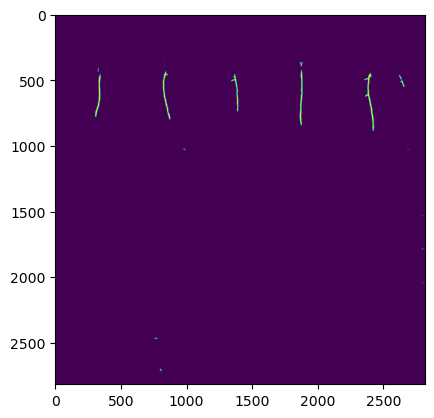

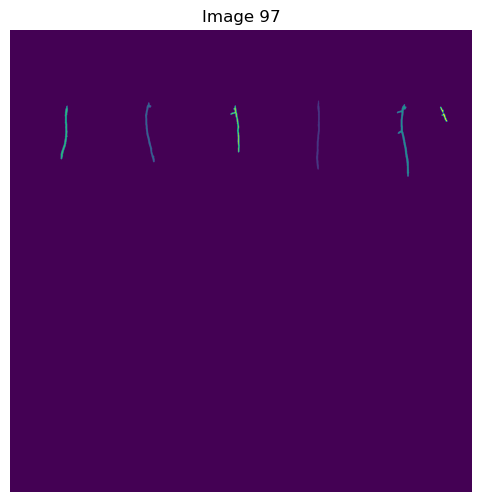

[[      0       0    2816    2816 7908743]
 [   1865     428      24     423    4418]
 [    824     440      57     366    3989]
 [   2359     452      73     441    5445]
 [    309     460      43     328    3596]
 [   1344     460      56     286    2844]
 [   2622     468      43      91     821]]
Number of components detected: 112


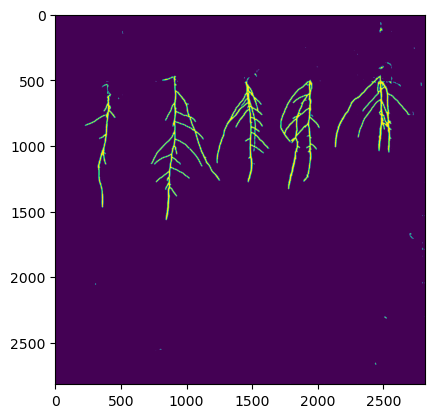

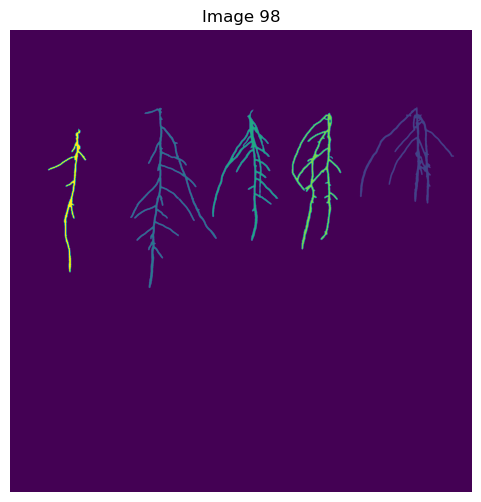

[[      0       0    2816    2816 7772343]
 [   2133     468     574     590   35105]
 [    733     475     527    1097   39507]
 [   1232     486     403     798   32897]
 [   1718     505     300     832   34369]
 [    232     603     232     874   15635]]
Number of components detected: 69


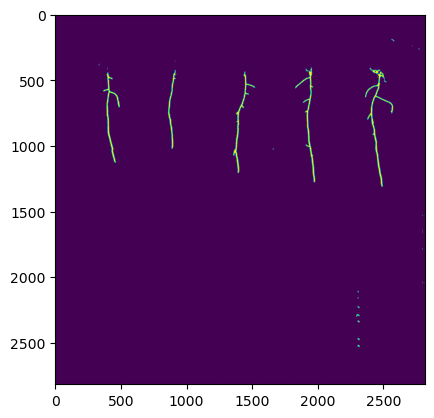

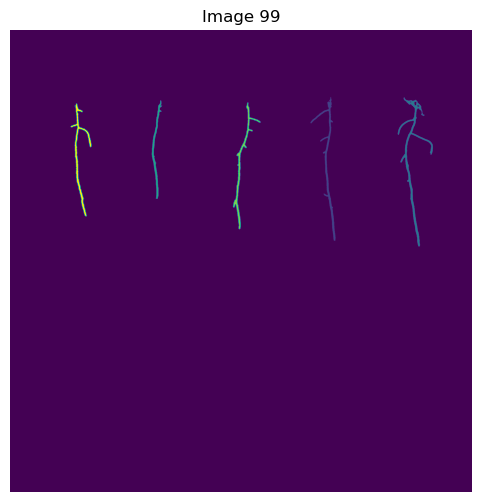

[[      0       0    2816    2816 7874327]
 [   1832     408     152     876   12264]
 [   2364     410     213     909   16315]
 [    865     429      61     599    6463]
 [   1360     440     167     774   10234]
 [    370     447     127     689   10253]]
Number of components detected: 87


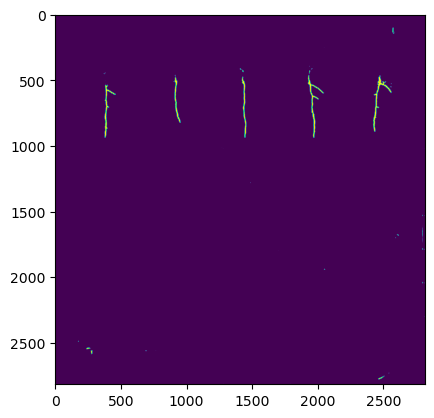

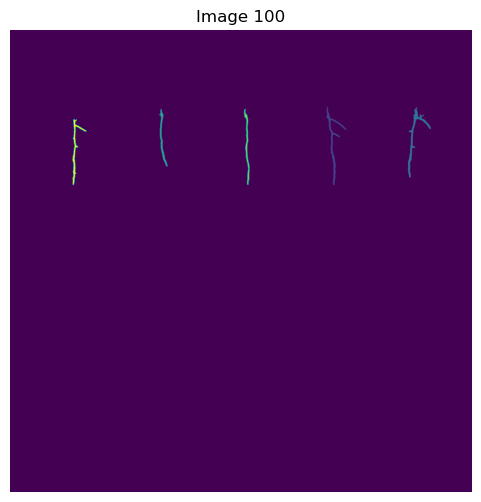

[[      0       0    2816    2816 7902543]
 [   1929     466     122     480    6696]
 [   2426     472     138     428    6867]
 [    906     480      54     352    3768]
 [   1427     480      33     464    4667]
 [    381     542      85     403    5315]]
Number of components detected: 107


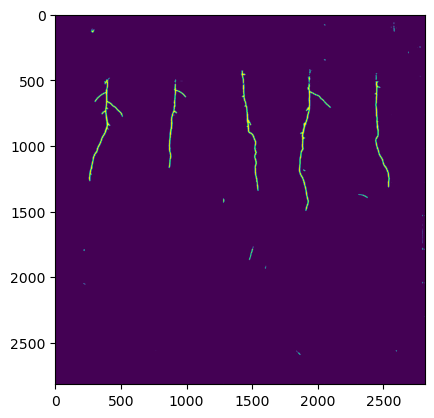

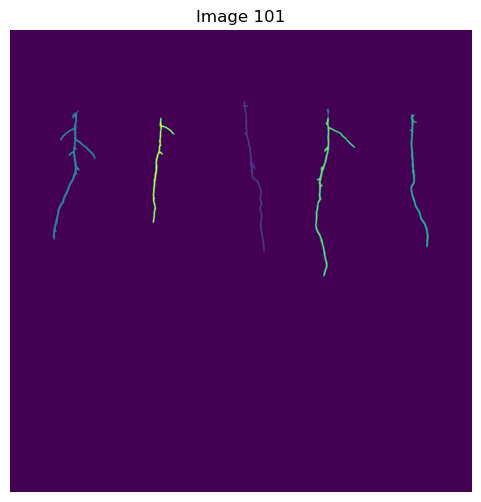

[[      0       0    2816    2816 7876447]
 [   1420     432     133     918   10580]
 [   1930     476      16      50     469]
 [    261     489     259     787   12577]
 [   2438     512     114     811    8942]
 [   1860     528     244     974   13138]
 [    869     534     133     642    7703]]
Number of components detected: 86


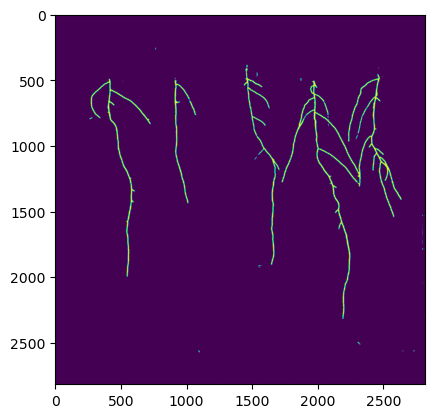

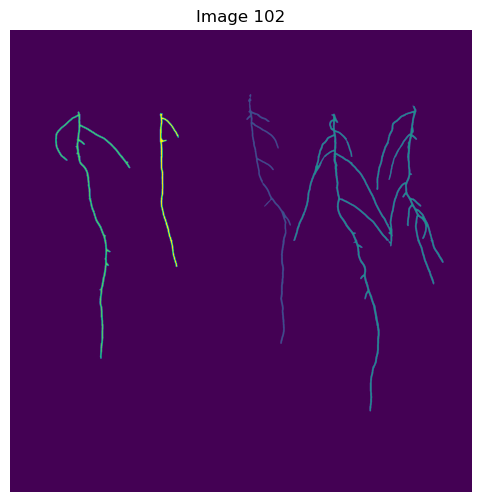

[[      0       0    2816    2816 7803641]
 [   1441     391     271    1522   20289]
 [   1727     456     915    1868   71192]
 [    276     496     457    1507   23707]
 [    913     507     115     937   11027]]
Number of components detected: 63


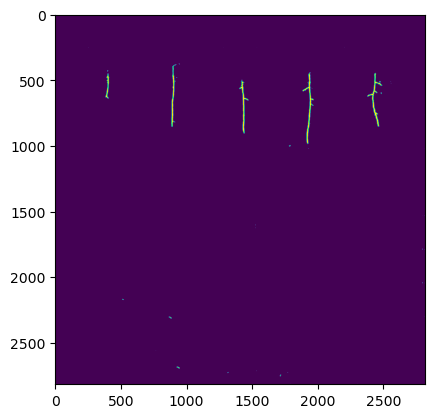

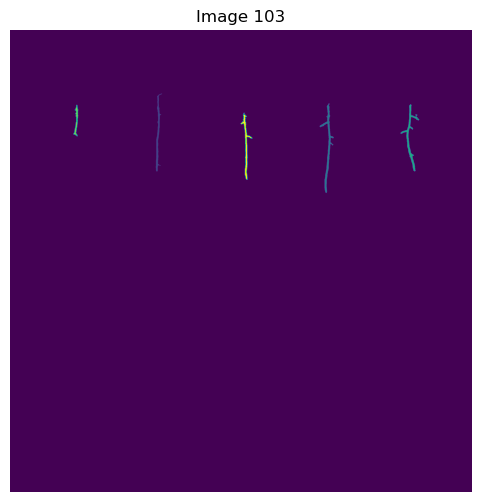

[[      0       0    2816    2816 7905409]
 [    889     387      39     476    4913]
 [   1888     448      84     545    6792]
 [   2381     453     113     408    5729]
 [    388     456      28     192    2027]
 [   1406     504      71     408    4986]]
Number of components detected: 188


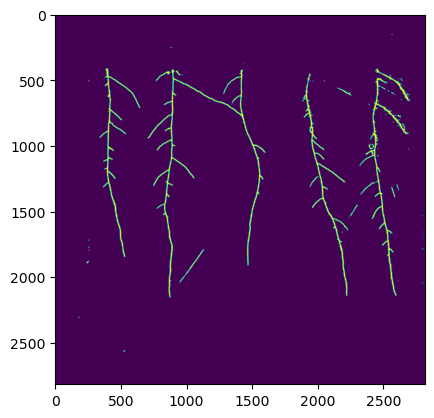

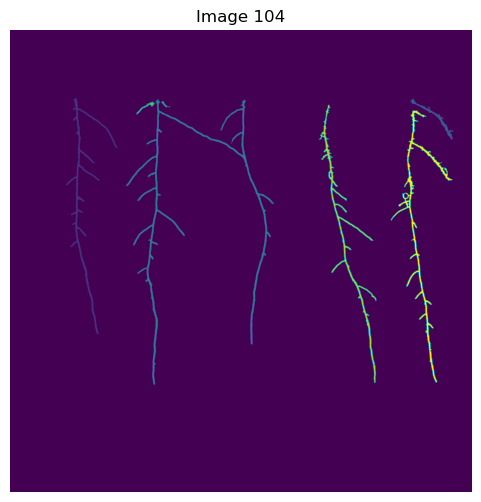

[[      0       0    2816    2816 7783435]
 [    341     416     313    1438   24818]
 [   2439     419     263     249    5291]
 [    708     421     899    1741   53399]
 [    922     433      54      39     509]
 [    772     438     112      78    1408]
 [   1882     457     351    1694   28456]
 [   2322     491     375    1657   32540]]
Number of components detected: 74


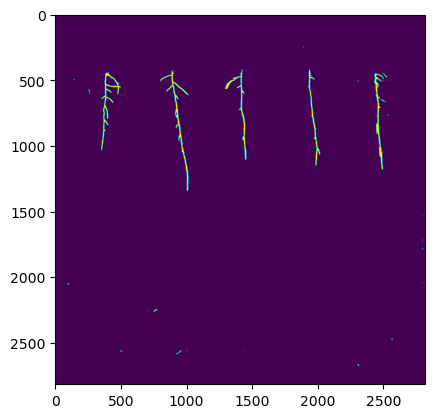

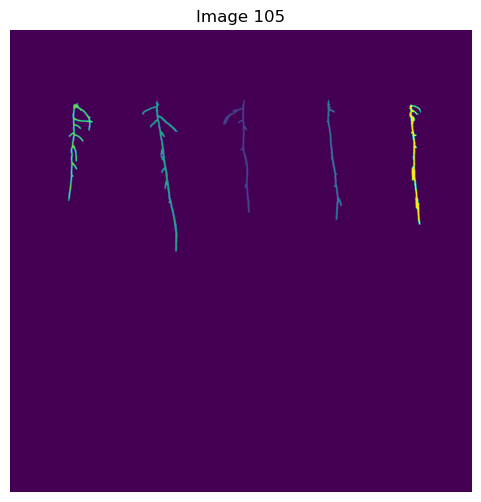

[[      0       0    2816    2816 7873231]
 [   1298     422     163     692   10230]
 [   1930     422      92     736    8552]
 [    806     430     216     920   14819]
 [    354     445     151     597   11452]
 [   2432     452      72     735   11572]]
Number of components detected: 69


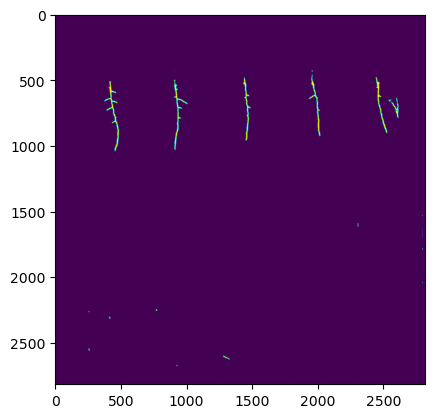

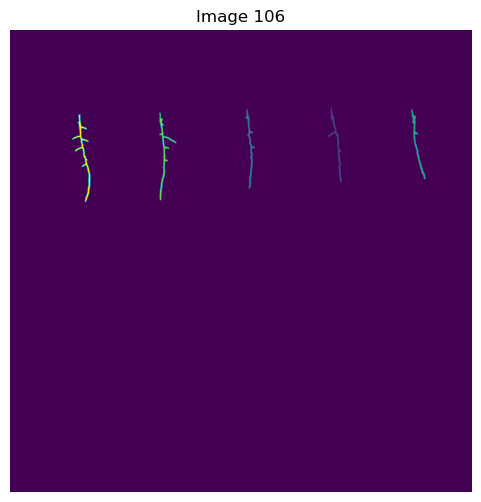

[[      0       0    2816    2816 7899705]
 [   1937     464      87     470    5292]
 [   1436     480      58     488    5393]
 [   2446     482      87     428    4884]
 [    909     503     106     535    6905]
 [    380     515     111     533    7677]]
Number of components detected: 74


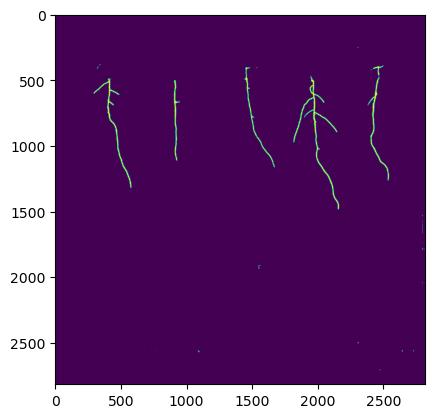

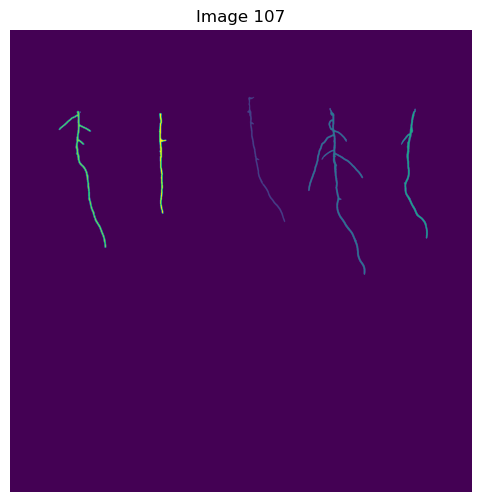

[[      0       0    2816    2816 7875985]
 [   1447     407     230     764    7517]
 [   1818     476     348    1016   19106]
 [   2384     480     162     791    9280]
 [    298     494     288     833   11488]
 [    909     507      44     613    6480]]
Number of components detected: 110


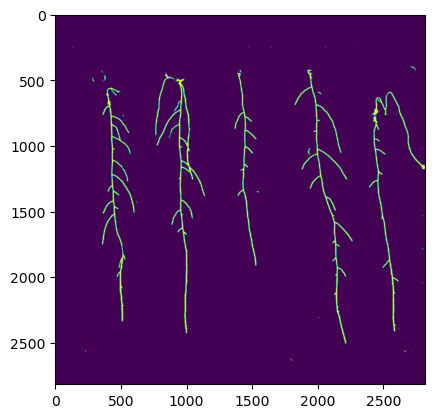

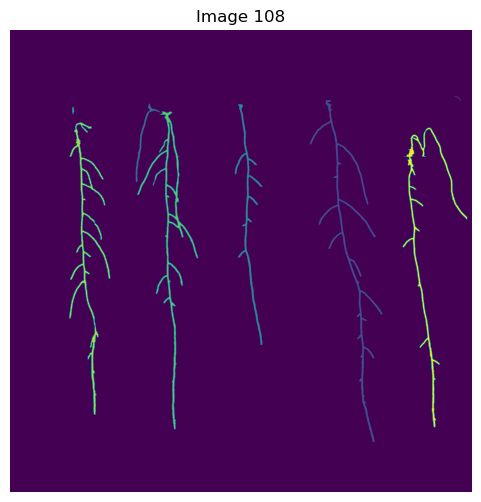

[[      0       0    2816    2816 7752576]
 [   2704     403      44      28     299]
 [   1828     426     442    2087   39351]
 [    767     447     149     481    5129]
 [   1370     451     169    1469   19673]
 [    378     468      13      45     347]
 [    776     496     370    1938   42259]
 [    361     564     249    1781   37575]
 [   2394     596     392    1825   32647]]
Number of components detected: 79


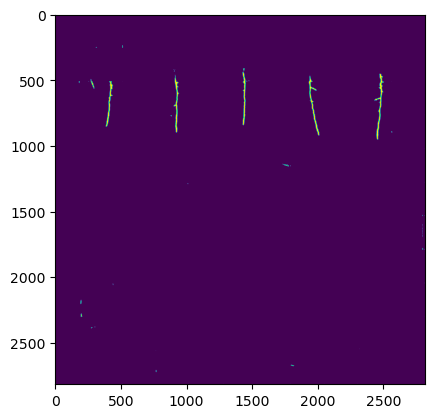

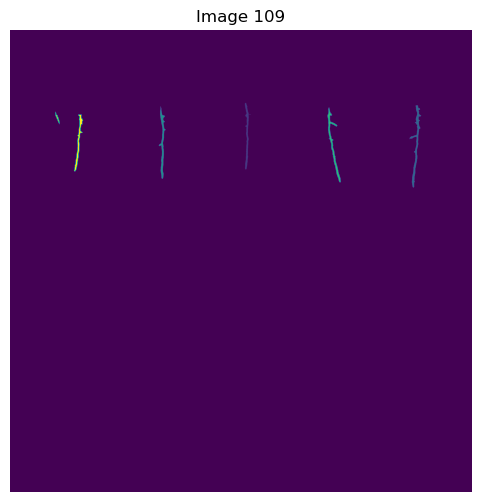

[[      0       0    2816    2816 7904161]
 [   1432     444      36     406    4338]
 [   2436     459      70     501    6486]
 [    908     464      39     442    4886]
 [   1936     470      80     458    5374]
 [    276     498      26      76     546]
 [    391     515      53     346    4065]]
Number of components detected: 128


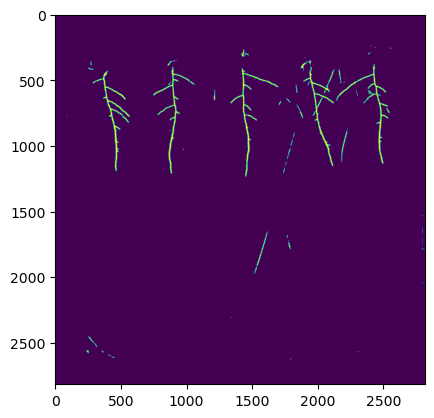

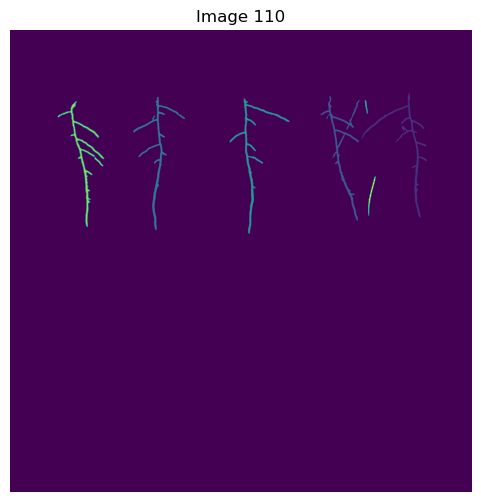

[[      0       0    2816    2816 7850057]
 [   2144     384     397     759   16088]
 [   1889     401     241     761   14875]
 [    752     408     314     811   14919]
 [   1338     418     365     823   15163]
 [   2163     428      17      83     555]
 [    291     435     283     765   16506]
 [   2183     893      46     238    1693]]
Number of components detected: 108


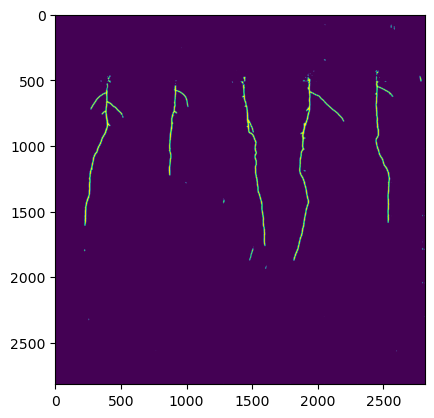

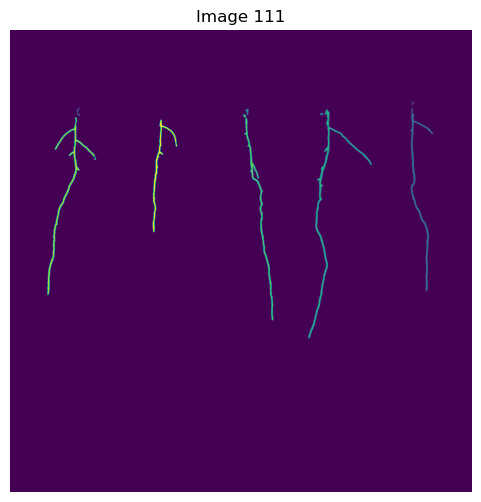

[[      0       0    2816    2816 7858014]
 [   2444     432      22      36     337]
 [    402     472      26      53     489]
 [   2440     476     138    1118   12634]
 [   1437     482      18      34     377]
 [   1818     483     386    1397   19259]
 [   1418     515     187    1255   14213]
 [    227     530     298    1085   15712]
 [    870     546     149     687    8821]]
Number of components detected: 75


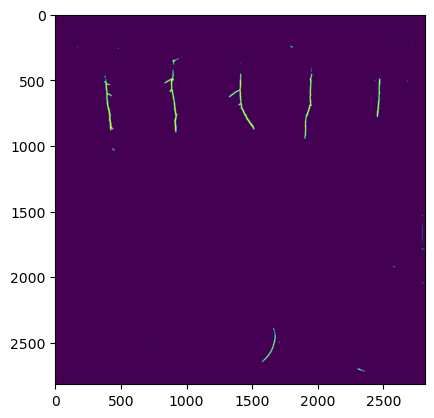

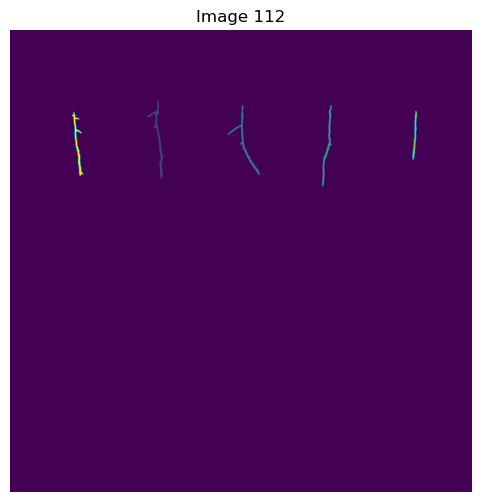

[[      0       0    2816    2816 7904000]
 [    836     430     105     475    6206]
 [   1328     456     194     427    6059]
 [   1902     459      60     495    5081]
 [   2452     492      30     298    3165]
 [    378     496      71     394    5345]]
Number of components detected: 89


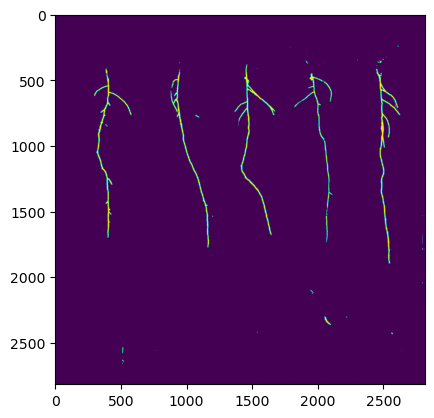

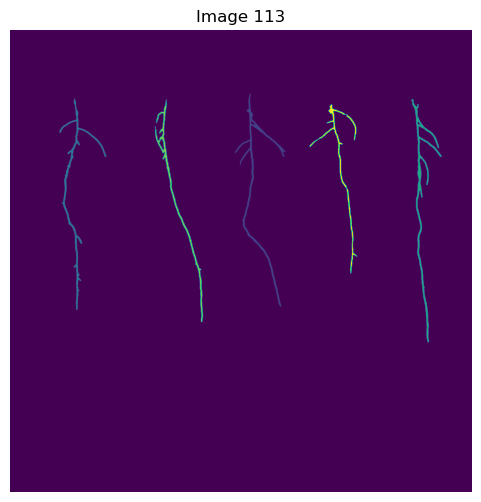

[[      0       0    2816    2816 7836154]
 [   1370     386     309    1301   20848]
 [    302     415     287    1292   19105]
 [   2447     421     186    1483   23185]
 [    884     424     292    1357   17377]
 [   1826     452     290    1033   13187]]
Number of components detected: 67


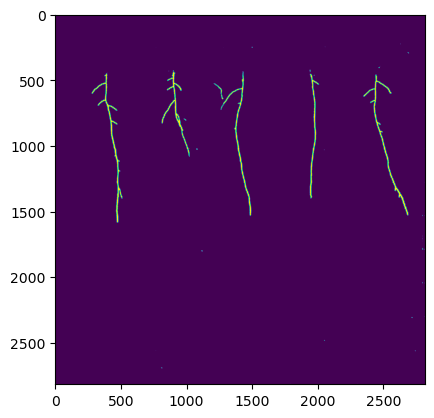

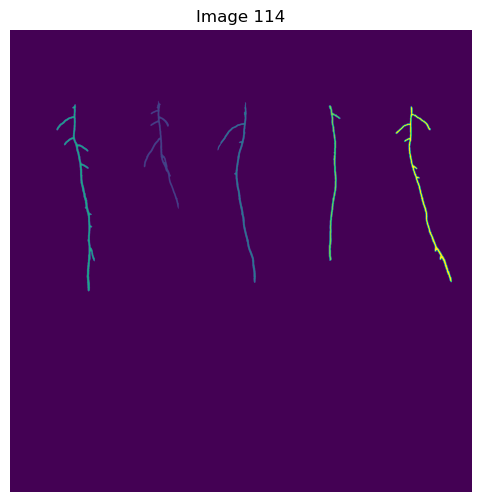

[[      0       0    2816    2816 7862083]
 [    816     432     212     658   11351]
 [   1266     439     232    1101   13682]
 [    284     453     232    1139   16753]
 [   1944     460      70     946   10401]
 [   2351     464     342    1073   15586]]


In [22]:
# Setting the output directory
output = r'C:\Users\daraz\Desktop\BUas\Year 2 Block B\Clean images normal task'

# Creating a list for storing the filtered masks
filtereds = []

# Looping through the masks
for index, mask in enumerate(masks):
    # Converting the mask to uint8
    mask = mask.astype(np.uint8)

    # Getting connected components with stats
    retval, labels, stats, centroids = cv2.connectedComponentsWithStats(mask)

    # Printing the number of components detected
    print(f"Number of components detected: {retval - 1}")

    # Displaying the unfiltered mask
    plt.imshow(masks[index], cmap='viridis')
    plt.show()

    # Initializing a mask to keep the relevant components
    filtered_mask = np.zeros_like(mask, dtype=np.uint8)

    # Iterating through the connected components
    for component_index in range(1, retval):
        # Getting the area, top, left, width and height of the components
        area = stats[component_index, cv2.CC_STAT_AREA]
        top = stats[component_index, cv2.CC_STAT_TOP]
        left = stats[component_index, cv2.CC_STAT_LEFT]
        width = stats[component_index, cv2.CC_STAT_WIDTH]
        height = stats[component_index, cv2.CC_STAT_HEIGHT]

        # Checking if the component is wider than the thin line threshold
        is_wide = width > thin_line_threshold
        extends_beyond_top_zone = top + height > 500
        within_top_boundary = 360 <= top <= 560

        # Checking if the component meets the criteria IMAGE 64 IS STILL NOT PERFECT
        #           50                                        400                      1500                
        if (min_area_threshold <= area) and top_position_threshold_top < top < top_position_threshold_bottom \
            and (2500 > left > 15) or within_top_boundary:
            # If it does, adding it to the mask
            filtered_mask[labels == component_index] = 255
        
      

    # Creating a kernel for dilation and erosion
    kernel = np.ones((2, 2), np.uint8)

    # Dilating and eroding the mask
    filtered_mask = cv2.dilate(filtered_mask, kernel, iterations=4)
    filtered_mask = cv2.erode(filtered_mask, kernel, iterations=4)

    # Getting connected components with stats again
    retval, labels, stats, centroids = cv2.connectedComponentsWithStats(filtered_mask)

    # Initializing another mask to keep the relevant components
    filtered_mask_2 = np.zeros_like(filtered_mask, dtype=np.uint8)

    # Iterating through the connected components
    for component_index in range(1, retval):
        # Getting the area and top of the components
        area = stats[component_index, cv2.CC_STAT_AREA]
        top = stats[component_index, cv2.CC_STAT_TOP]

        # Checking if the component is within the top boundary
        within_top_boundary = 400 <= top <= 500

        # Checking if the component meets the criteria
        if 1500 < area or within_top_boundary and top < top_position_threshold_bottom:
            # If it does, adding it to the mask
            filtered_mask_2[labels == component_index] = 255

    # Removing parts of the images that are ceraintly not roots
    filtered_mask_2[:200, :] = np.zeros((200, filtered_mask_2.shape[1]), dtype=np.uint8)
    filtered_mask_2[:, -30:] = np.zeros((filtered_mask_2.shape[0], 30), dtype=np.uint8)

    # Getting connected components with stats again
    retval, labels, stats, centroids = cv2.connectedComponentsWithStats(filtered_mask_2)

    # Initializing another mask to keep the relevant components
    filtered_mask_3 = np.zeros_like(filtered_mask_2, dtype=np.uint8)

    # Iterating through the connected components
    for component_index in range(1, retval):
        # Getting the area of the components
        area = stats[component_index, cv2.CC_STAT_AREA]

        # Checking if the component meets the criteria
        if 280 < area:
            # If it does, adding it to the mask
            filtered_mask_3[labels == component_index] = 255

    # Getting connected components with stats again
    retval, labels, stats, centroids = cv2.connectedComponentsWithStats(filtered_mask_3)

    # Append the filtered masks to the list
    filtereds.append(filtered_mask_3)
    
    filename = os.path.join(output, f"mask_{index}.png")
    cv2.imwrite(filename, filtered_mask_3.astype(np.uint8))

    # Displaying the filtered masks
    plt.figure(figsize=(6, 6))
    plt.imshow(labels, cmap='viridis')
    plt.title(f"Image {index}")
    plt.axis('off')
    plt.show()

    # Printing out the stats
    print(stats)

Here I could not continue in VSCode as I was not able to import skan for some reason. I had to continue in Google Colab, but I am putting my code here copied from there

In [ ]:
# Importing the necessary libraries
from skan import Skeleton, summarize
from skan.csr import skeleton_to_csgraph
import networkx as nx
from skimage.morphology import skeletonize
from skan import draw
import pandas as pd

In [ ]:
# Function to load the images from the image directory
def loader(mask_dir):
    # Creating empty lists to store the images and their names
    masks = []
    names = []

    # Making sure the images are sorted in the correct order
    filenames = os.listdir(mask_dir)
    filenames = sorted(filenames)

    # Looping through the images in the image directory
    for image_filename in sorted(filenames):
        if image_filename.endswith(".png"):
            mask_path = os.path.join(mask_dir, image_filename)
            mask = cv2.imread(mask_path)

            # Printing the image name to make sure the images are loaded in the correct order
            print(image_filename)

            # Appending the images to the empty lists
            masks.append(mask)

            # Appending the image names to the empty list
            names.append(image_filename)

    return masks, names

In [ ]:
# Loading in the images
mask_dir = f'C:\Users\daraz\Desktop\BUas\Year 2 Block B\Clean slices normal task'
masks, names = loader(mask_dir)

In [ ]:
# Creating an empty list to store the skeletonized masks
skeletonized = []

# Looping through the masks and skeletonizing them
for index, mask in enumerate(masks):
    # Skeletonizing the masks
    skelmask = skeletonize(mask)

    # Appending the skeletonized masks to the empty list
    skeletonized.append(skelmask)
    
    # Printing the index to see how many images have been skeletonized (this was for colab)
    print(index)

In [ ]:
# Creating an empty list to store the bottom coordinates of the skeletonized masks
bottom_coordinates_per_image = []

# Looping through the skeletonized masks
for i, skeleton in enumerate(skeletonized):
    # Creating an empty list to store the bottom coordinates of the current image
    current_coords = []

    # Getting the summary of the skeleton
    simple_skeleton_branch_data = summarize(Skeleton(skeleton))

    # Filtering out the branches that are not the main branch
    simple_skeleton_branch_data = simple_skeleton_branch_data[(simple_skeleton_branch_data["branch-type"] == 0) | (simple_skeleton_branch_data["branch-type"] == 1)]

    # Making a copy of the image
    image_with_circle = np.copy(skeleton)

    # Getting the relevant columns from the DataFrame
    dst = simple_skeleton_branch_data[["skeleton-id", "image-coord-dst-0", "image-coord-dst-1"]]

    # Grouping by 'skeleton-id' and finding the index of the max 'image-coord-dst-0' for each skeleton
    idx = dst.groupby('skeleton-id')['image-coord-dst-0'].idxmax()

    # Using these indices to get the corresponding rows from the DataFrame
    lowest_points = dst.loc[idx]

    # Looping through the lowest points of each skeleton
    for j in range(len(lowest_points)):
        x = int(lowest_points.iloc[j, 2])
        y = int(lowest_points.iloc[j, 1])

        # Saving the coordinates
        pointend = (x, y)

        # Drawing a circle at the lowest point of each skeleton
        cv2.circle(image_with_circle, pointend, radius=10, color=(255, 0, 0), thickness=-1)

        # Appending the coordinates to the empty list for the current image
        current_coords.append(pointend)
    
    # Appending the coordinates to the empty list for all images
    bottom_coordinates_per_image.append(current_coords)

    # Displaying the image
    plt.figure(figsize=(12, 12))
    plt.imshow(image_with_circle, cmap="inferno")
    plt.show()

    # Printing the bottom coordinates of all images
    print(bottom_coordinates_per_image)

In [1]:
# Defining the sizes of the plate and the image
plate_size_mm = 150
plate_size_pixels = 2816

# Calculating the conversion factor
conversion_factor = plate_size_mm / plate_size_pixels

# Printing the conversion factor
print(conversion_factor)

# Creating an empty list to store the adjusted coordinates
adjusted_coordinates = []

# Looping through the bottom coordinates of each image
for i, five in enumerate(bottom_coordinates_per_image):
  # Looping through the bottom coordinate pairs of each skeleton
  for point in five:
    # Calculating the adjusted coordinates
    x = (point[1] * conversion_factor) / 1000 + 0.10775
    y = (point[0] * conversion_factor) / 1000 + 0.088 - 0.026
    z = 0.2

    # Appending the adjusted coordinates to the empty list
    adjusted_coordinates.append([x, y, z])

# Printing the adjusted coordinates
print(adjusted_coordinates)

# Converting the list to a DataFrame
adjusted_coordinates = pd.DataFrame(adjusted_coordinates)

# Saving the DataFrame as a csv file
adjusted_coordinates.to_csv('Final_pipeline_coordinates.csv')

0.053267045454545456


NameError: name 'bottom_coordinates_per_image' is not defined